## PCA

#### (Technical note: 
PCA is typically applied to standardized data.
With standardized data "variation" means "correlation". 
With unstandardized data "variation" means "covariance". 
All data in this course will be standardized before applying PCA.)


### The first way is to use it as a descriptive technique. 
Since the components tell you about the variation, 
you could compute the MI scores for the components and see what kind of variation is most predictive of your target. 

You could even try clustering on one or more of the high-scoring components.


###  Intro to ClusterS
#### Cluster Labels as a Feature
* Applied to a single real-valued feature, 
* clustering acts like a traditional "binning" or "discretization" transform. 
* On multiple features, it's like "multi-dimensional binning" (sometimes called vector quantization).

#### so far check if i can stack keeps ansd drops for regression models

* make_clusters
* make_mi_scores_Regression  and plot_make_mi_scores
* outlier removal iqr
* outlier removal by eye test from scatterplot
* sns.relplot ,hue = cluster
* number of clusters using elbow plot .chose 4 and 10
* make_clusters_distance
* make_mi_scores_Regression  and plot_make_mi_scores
* sklearn.feature_selection import SelectFromMod

In [1]:
    import pandas as pd
    import numpy as np
    import seaborn as sns

    import warnings
    warnings.filterwarnings('ignore')

    import matplotlib.pyplot as plt
    import seaborn as sns

In [129]:
# Set Matplotlib defaults
plt.style.use("seaborn-whitegrid")
plt.rc("figure", autolayout=True)
plt.rc(
    "axes",
    labelweight="bold",
    labelsize="large",
    titleweight="bold",
    titlesize=14,
    titlepad=10,
)

In [20]:
def run(df,target,model,fold,dropped,save_fold_csv=False):
    from sklearn import model_selection
    from sklearn import metrics ; from sklearn import preprocessing ; from sklearn import impute
    # we create a new column called kfold and fill it with -1
    df["kfold"] = -1
    # the next step is to randomize the rows of the data
    df = df.sample(frac=1).reset_index(drop=True)
    # fetch labels
    y = df[target].values
    # initiate the kfold class from model_selection module
    kf = model_selection.StratifiedKFold(n_splits=5)

    for f, (t_, v_) in enumerate(kf.split(X=df, y=y)): # f= fold, t_=train_index ,v_= valid_index
        df.loc[v_, 'kfold'] = f

    #save the new csv with kfold column
    #if save_fold_csv == True:
        #df.to_csv("../input/cat_train_folds.csv", index=False)
    # load the full training data with folds
    # df = pd.read_csv("../input/adult_folds.csv")
    #drop unwanted columns
    df = df.drop(dropped,axis=1)
    
    features = [f for f in df.columns if f not in ("kfold",target)]
    num_col =  [f for f in df.select_dtypes(exclude='object').columns if f not in ("kfold",target)]
    #1. fill all NaN values with NONE
    cat_col = df.select_dtypes(include='object').columns
    for col in cat_col:
    # do not encode the numerical columns
        df.loc[:, col] = df[col].astype(str).fillna("NONE")
        
    #3. fill all NaN values with median
    for col in num_col: 
        imputer = df[col].median()
        df.loc[:, col] = df[col].fillna(imputer)

    #2. label encode the features
    for col in cat_col: 
        lbl = preprocessing.LabelEncoder()
        lbl.fit(df[col])
        df.loc[:, col] = lbl.transform(df[col])
    # get training data using folds
    df_train = df[df.kfold != fold].reset_index(drop=True)
    # get validation data using folds
    df_valid = df[df.kfold == fold].reset_index(drop=True)
    # get training data
    x_train = df_train[features].values
    # get validation data
    x_valid = df_valid[features].values
    # fit model on training data (ohe)
    model.fit(x_train, df_train[target].values)
    # predict on validation data
    # we may need the probability values as we are calculating AUC
    # we will use the probability of 1s
    #valid_preds = model.predict_proba(x_valid)[:, 1]
    valid_prediction = model.predict(x_valid)
    # get roc auc score
    #auc = metrics.roc_auc_score(df_valid[target].values, valid_preds)
    #f1 = metrics.f1_score(df_valid[target].values, valid_prediction)
    MSE = metrics.mean_squared_error(df_valid[target].values, valid_prediction) ; RMSE = np.sqrt(MSE)
    #error= df_valid[target].values - valid_prediction
    #sns.distplot(error,kde=True)
    plt.figure(figsize=(10,8))
    plt.plot(np.arange(len(df_valid[target].values)),df_valid[target].values,label='Y_true',color='g')
    plt.plot(np.arange(len(df_valid[target].values)),valid_prediction,label='preds',color='r')
    plt.legend()
    plt.show()
    # print auc,f1
    #print(f"Fold = {fold}, AUC = {auc}, F1 = {f1}")
    print(f"Fold = {fold}, RMSE = {RMSE}")
    return(RMSE)

In [21]:
from xgboost import XGBRegressor
xgb = XGBRegressor(n_estimators=500)

#
from sklearn.ensemble import RandomForestRegressor ,ExtraTreesRegressor
from sklearn.linear_model import Lasso,LinearRegression
from sklearn.metrics import  mean_absolute_error,r2_score,mean_squared_error
las_R = Lasso()
L_R = LinearRegression()
rf = RandomForestRegressor(n_estimators=200)
et= ExtraTreesRegressor(n_estimators=200)
from sklearn.tree import DecisionTreeRegressor
D_R = DecisionTreeRegressor()

baseline = RandomForestRegressor(criterion="mae", random_state=0)
# 
#from sklearn.metrics import SCORERS
#SCORERS.keys()

classifier_list= [rf,et,L_R,las_R,D_R]
classifier_name =['rf','et','L_R','las_R','D_R']
scoring ='neg_root_mean_squared_error'

In [16]:
def My_Ordinal_Encoding(train,target):    
    mx_LE = train.copy()
    cats= mx_LE.select_dtypes(["category", "object"]).columns
    for colname in cats.drop(target):
        mx_LE[colname], _ = mx_LE[colname].factorize()
    return mx_LE

In [3]:
drops =['Id','Utilities','Street','Alley','area_per_finishes','RoofMatl',
       'MiscFeature','Heating','kfold','SalePrice']

In [4]:
merged = pd.read_csv('feature_egnr_done.csv')
cats = merged.select_dtypes(include='object').columns

In [5]:
cats

Index(['MSZoning', 'Street', 'Alley', 'LotShape', 'LandContour', 'Utilities',
       'LotConfig', 'LandSlope', 'Neighborhood', 'Condition1', 'Condition2',
       'BldgType', 'HouseStyle', 'RoofStyle', 'RoofMatl', 'Exterior1st',
       'Exterior2nd', 'MasVnrType', 'Foundation', 'Heating', 'FireplaceQu',
       'GarageType', 'MiscFeature', 'SaleType', 'SaleCondition', 'SalePrice',
       'Street_Alley', 'LotShape_LandContour', 'LotShape_LotConfig',
       'LotShape_LandSlope', 'Condition1_Condition2',
       'Exterior1st_Exterior2nd', 'Foundation_MasVnrType',
       'SaleCondition_SaleType'],
      dtype='object')

In [7]:
target='SalePrice'

In [17]:
mxLE = My_Ordinal_Encoding(merged,target)

In [18]:
cats = mxLE.select_dtypes(include='object').columns
cats

Index(['SalePrice'], dtype='object')

In [19]:
mxLE.SalePrice.tail()

2914    test_col
2915    test_col
2916    test_col
2917    test_col
2918    test_col
Name: SalePrice, dtype: object

# mxLE is merged..

In [22]:
LE_df= mxLE.copy()

In [23]:
#mxLE = LE_df

LE_df["LivLotRatio"] = LE_df.GrLivArea  /LE_df.LotArea
LE_df["Spaciousness"] = (LE_df['1stFlrSF'] + LE_df['2ndFlrSF']) / LE_df.TotRmsAbvGrd
#X_1["TotalOutsideSF"] =  X.WoodDeckSF + X.OpenPorchSF + X.EnclosedPorch + X.Threeseasonporch + X.ScreenPorch

LE_df["PorchTypes"] = LE_df[['WoodDeckSF','OpenPorchSF','EnclosedPorch','3SsnPorch','ScreenPorch']].gt(0).sum(axis=1)


In [26]:
mxLE = LE_df # to make sure the new features are in mxLE i.e the merged df

In [24]:
indoor = ['TotalBsmtSF','1stFlrSF','2ndFlrSF','GrLivArea']
outdoor= ['LotArea','GarageArea']
space = ['LotArea', 'TotalBsmtSF', 'FirstFlrSF', 'SecondFlrSF','GrLivArea']
in_out=['TotalBsmtSF','1stFlrSF','2ndFlrSF','GrLivArea','LotArea','GarageArea']
Ext_Qual_Cond = ['ExterQual','ExterCond']
Bmt_Qual_Cond = ['BsmtQual','BsmtCond','BsmtFinType2','BsmtFinType1','BsmtExposure']
Bmt_Fnsh_Area = ['BsmtFinSF1','BsmtFinSF2']
Garage_Qual_Cond = ['GarageFinish','GarageQual','GarageCond','GarageFinish']
All_Qualities = ['OverallQual','OverallCond','HeatingQC','Functional','Fireplaces','KitchenQual','FireplaceQu',
                'avg_Ext_Qual','avg_Bmt_Qual','avg_Gar_Qual','Electrical']

In [37]:
space = ['LotArea', 'TotalBsmtSF', 'FirstFlrSF', 'SecondFlrSF','GrLivArea']

In [101]:
def make_clusters(df,target,features_list,cluster_name_list, n_clusters=10):
    X = df.copy()
    y = X.pop(target)
    
    #features = ['LotArea', 'TotalBsmtSF', 'FirstFlrSF', 'SecondFlrSF','GrLivArea']
    for features,cluster_name in zip(features_list,cluster_name_list):
        # Standardize
        X_scaled = X.loc[:, features]
        X_scaled = (X_scaled - X_scaled.mean(axis=0)) / X_scaled.std(axis=0)

        # Fit the KMeans model to X_scaled and create the cluster labels
        kmeans = KMeans( n_clusters=n_clusters, random_state=0)

        X_scaled = (X_scaled - X_scaled.mean(axis=0)) / X_scaled.std(axis=0)
        X[cluster_name + "_Cluster"] = kmeans.fit_predict(X_scaled)
        #X["Cluster"]=  X["Cluster"].astype('category')
    X[target]=y
    return X


In [28]:
from sklearn.cluster import KMeans

In [34]:
LE_df.isna().any()[lambda x:x]

LotFrontage           True
MasVnrArea            True
BsmtFinSF1            True
BsmtFinSF2            True
BsmtUnfSF             True
TotalBsmtSF           True
BsmtFullBath          True
BsmtHalfBath          True
GarageYrBlt           True
GarageCars            True
GarageArea            True
LotAreaPerFront       True
Bsmt_Unf_Per          True
Garage_per_Car_Cap    True
Bsmt_Fsh_Per          True
dtype: bool

In [35]:
LE_df = LE_df.fillna(value=0)

In [47]:
cluster_features=[indoor,outdoor,in_out,Ext_Qual_Cond,Bmt_Qual_Cond,Bmt_Fnsh_Area,Garage_Qual_Cond,All_Qualities]
cluster_alias=['indoor','outdoor','in_out','Ext_Q_Cd','Bmt_Ql_Cd','Bmt_F_A','Gar_Q_Cd','All_Q']

In [64]:
klusters=  make_clusters(df=LE_df,target=target,features_list=cluster_features,cluster_name_list=cluster_alias)

In [82]:
klusters.columns.to_list()

['Id',
 'MSSubClass',
 'MSZoning',
 'LotFrontage',
 'LotArea',
 'Street',
 'Alley',
 'LotShape',
 'LandContour',
 'Utilities',
 'LotConfig',
 'LandSlope',
 'Neighborhood',
 'Condition1',
 'Condition2',
 'BldgType',
 'HouseStyle',
 'OverallQual',
 'OverallCond',
 'YearBuilt',
 'YearRemodAdd',
 'RoofStyle',
 'RoofMatl',
 'Exterior1st',
 'Exterior2nd',
 'MasVnrType',
 'MasVnrArea',
 'ExterQual',
 'ExterCond',
 'Foundation',
 'BsmtQual',
 'BsmtCond',
 'BsmtExposure',
 'BsmtFinType1',
 'BsmtFinSF1',
 'BsmtFinType2',
 'BsmtFinSF2',
 'BsmtUnfSF',
 'TotalBsmtSF',
 'Heating',
 'HeatingQC',
 'CentralAir',
 'Electrical',
 '1stFlrSF',
 '2ndFlrSF',
 'LowQualFinSF',
 'GrLivArea',
 'BsmtFullBath',
 'BsmtHalfBath',
 'FullBath',
 'HalfBath',
 'BedroomAbvGr',
 'KitchenAbvGr',
 'KitchenQual',
 'TotRmsAbvGrd',
 'Functional',
 'Fireplaces',
 'FireplaceQu',
 'GarageType',
 'GarageYrBlt',
 'GarageFinish',
 'GarageCars',
 'GarageArea',
 'GarageQual',
 'GarageCond',
 'PavedDrive',
 'WoodDeckSF',
 'OpenPorchSF'

In [57]:
klusters.head(2)

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,...,Spaciousness,PorchTypes,indoor_Cluster,outdoor_Cluster,in_out_Cluster,Ext_Q_Cd_Cluster,Bmt_Ql_Cd_Cluster,Bmt_F_A_Cluster,Gar_Q_Cd_Cluster,All_Q_Cluster
0,1,60,0,65.0,8450,0,-1,0,0,0,...,213.750000,1,0,9,1,1,0,3,0,2
1,2,20,0,80.0,9600,0,-1,0,0,0,...,210.333333,1,7,4,4,0,6,8,0,8


In [71]:
train_df = klusters.loc[klusters.SalePrice!='test_col'].reset_index(drop=True)
test_df = klusters.loc[klusters.SalePrice =='test_col'].reset_index(drop=True)
train_df.SalePrice = train_df.SalePrice.apply(int)

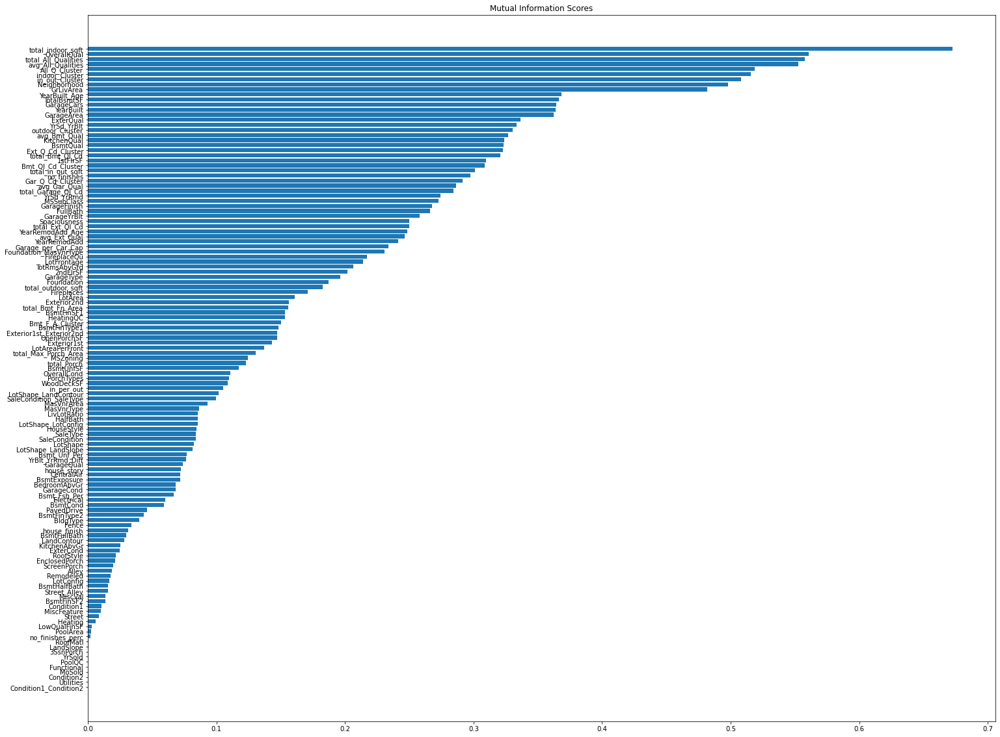

In [72]:
from sklearn.feature_selection import mutual_info_regression
def make_mi_scores_Regression(X_train, y_train):    
    discrete_features = X_train.dtypes == int
    mi_scores = mutual_info_regression(X_train, y_train, discrete_features=discrete_features)
    mi_scores = pd.Series(mi_scores, name="MI Scores", index=X_train.columns)
    mi_scores = mi_scores.sort_values(ascending=False)
    return mi_scores

scoremxLE = make_mi_scores_Regression(X_train=train_df.drop(['Id','SalePrice','area_per_finishes'],axis=1), y_train=train_df.SalePrice)

def plot_mi_scores(scores):
    scores = scores.sort_values(ascending=True)
    width = np.arange(len(scores))
    ticks = list(scores.index)
    plt.figure(figsize=(25,20))
    plt.barh(width, scores)
    plt.yticks(width, ticks)
    plt.title("Mutual Information Scores")
    
plot_mi_scores(scoremxLE)

In [ ]:
train_df = merged.loc[merged.SalePrice!='test_col'].reset_index(drop=True)
test_df = merged.loc[merged.SalePrice =='test_col'].reset_index(drop=True)
train_df.SalePrice = train_df.SalePrice.apply(int)

# the cluster columns have good mi score

In [85]:
#adding the new clusters
sub1= ['TotalBsmtSF', '2ndFlrSF', 'YrSd_YrBlt', 'total_indoor_sqft', 'no_finishes', 'OverallQual', 'avg_All_Qualities', 'total_in_out_sqft', 'total_All_Qualities', 'MasVnrArea',
       'YearBuilt', 'GrLivArea', 'BsmtFinSF1', '1stFlrSF', 'GarageArea', 'YearBuilt_Age', 'LotFrontage','indoor_Cluster', 'outdoor_Cluster',
       'in_out_Cluster', 'Ext_Q_Cd_Cluster', 'Bmt_Ql_Cd_Cluster',
       'Bmt_F_A_Cluster', 'Gar_Q_Cd_Cluster', 'All_Q_Cluster','SalePrice']

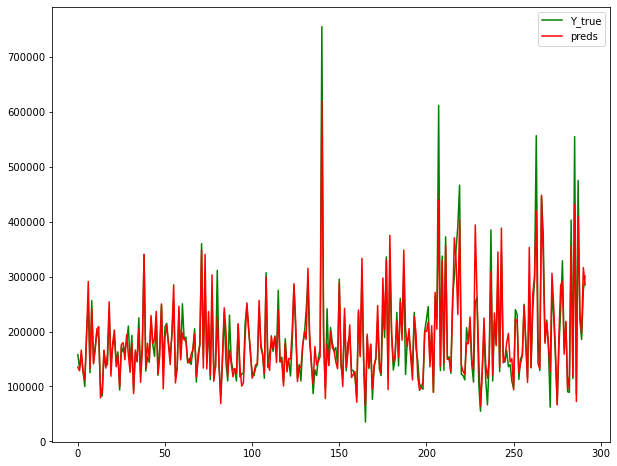

Fold = 0, RMSE = 30919.957998303973


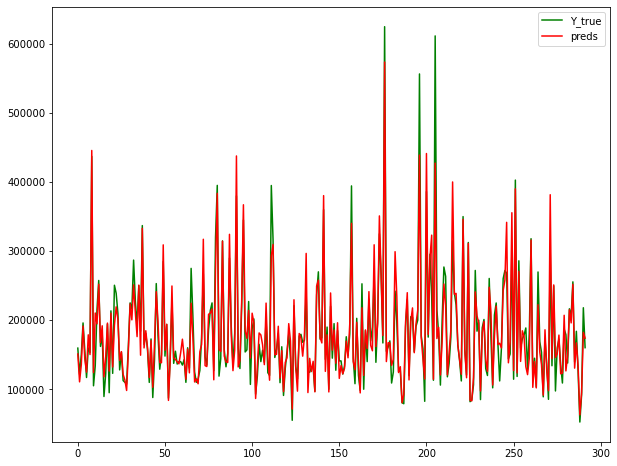

Fold = 1, RMSE = 26324.576252177205


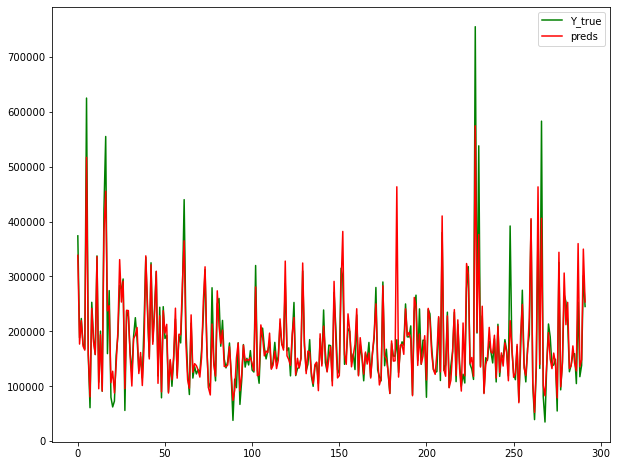

Fold = 2, RMSE = 34901.82708486477


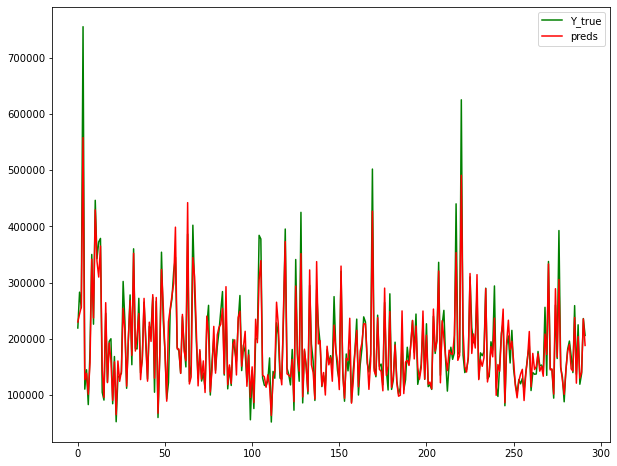

Fold = 3, RMSE = 27394.98800371019


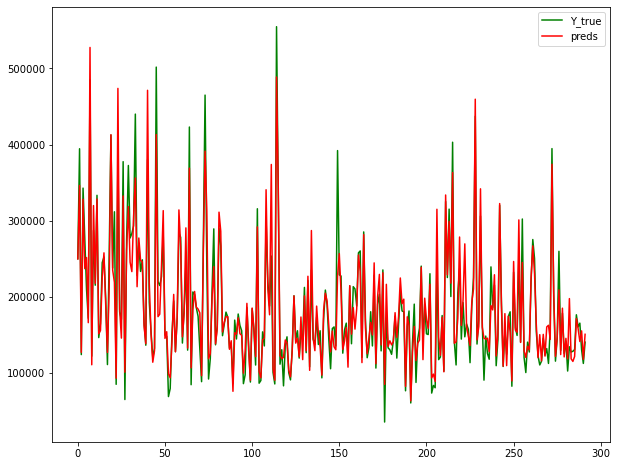

Fold = 4, RMSE = 28222.83067726071
mean_score =  29552.836003263372


In [86]:
# best score around 20000 pre clusters
RMSE_arr=[]
for i in np.arange(5):
    score= run(df=train_df[sub1],target=target,model=rf,fold=i,dropped=[],save_fold_csv=False)  ; RMSE_arr.append(score)
print('mean_score = ', np.mean(RMSE_arr))

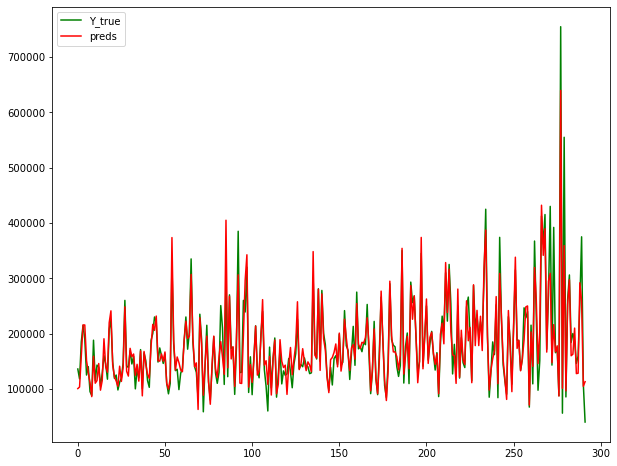

Fold = 0, RMSE = 29483.983806847853


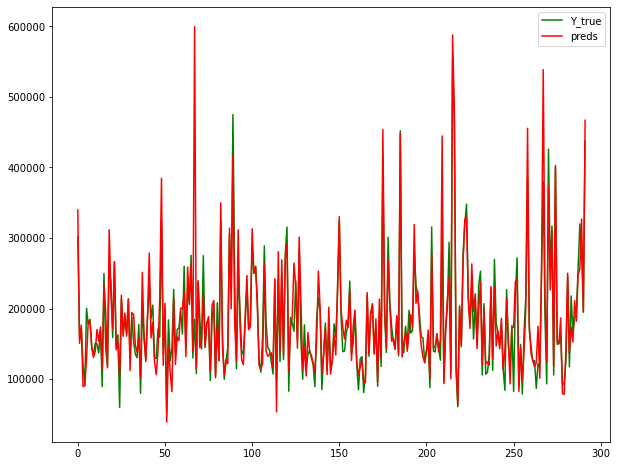

Fold = 1, RMSE = 36147.90713193597


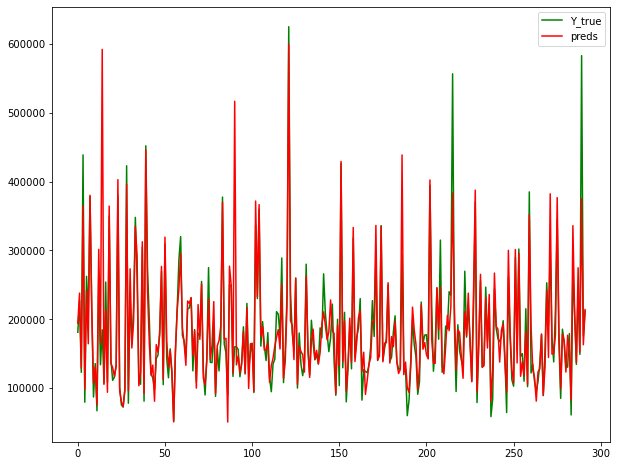

Fold = 2, RMSE = 42490.505185829286


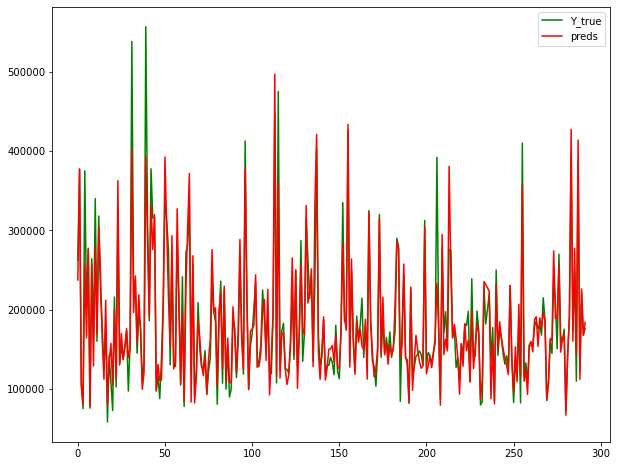

Fold = 3, RMSE = 28268.722120643328


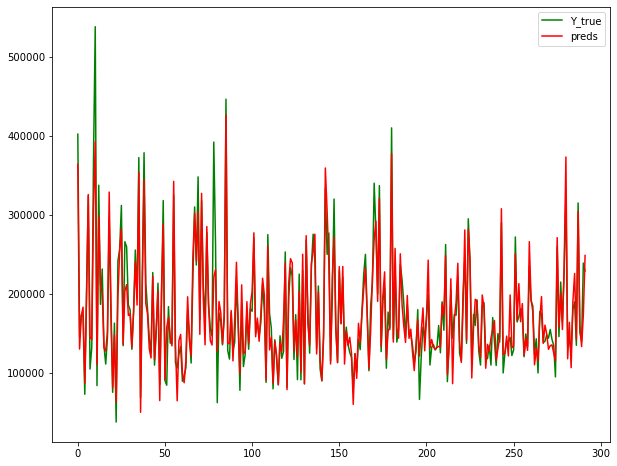

Fold = 4, RMSE = 24711.269709948025
mean_score =  32220.477591040886


In [91]:
# best score around 20000 pre clusters
RMSE_arr=[]
for i in np.arange(5):
    score= run(df=train_df[sub1],target=target,model=xgb,fold=i,dropped=[],save_fold_csv=False)  ; RMSE_arr.append(score)
print('mean_score = ', np.mean(RMSE_arr))

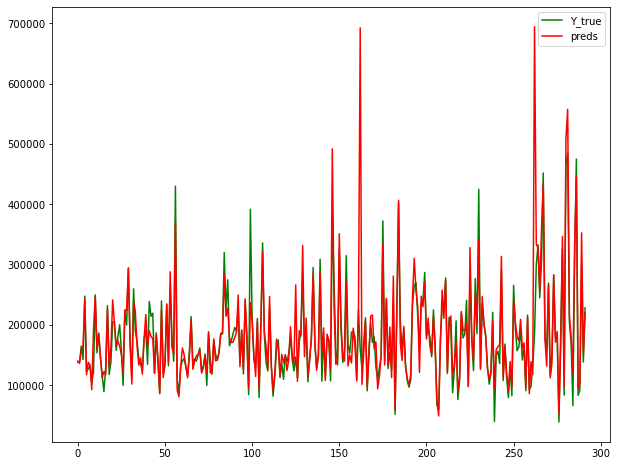

Fold = 0, RMSE = 49426.00357969999


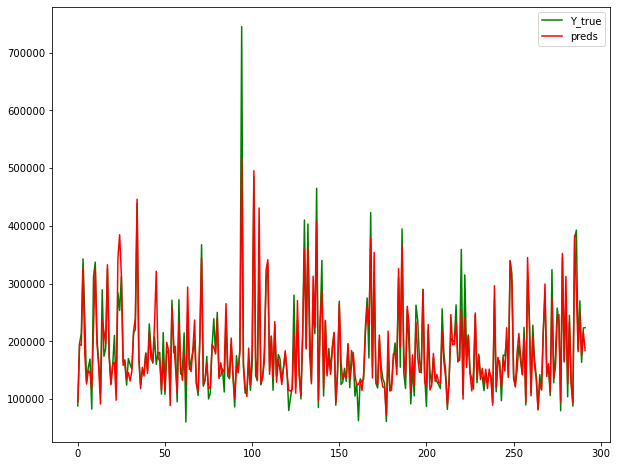

Fold = 1, RMSE = 30436.05574867545


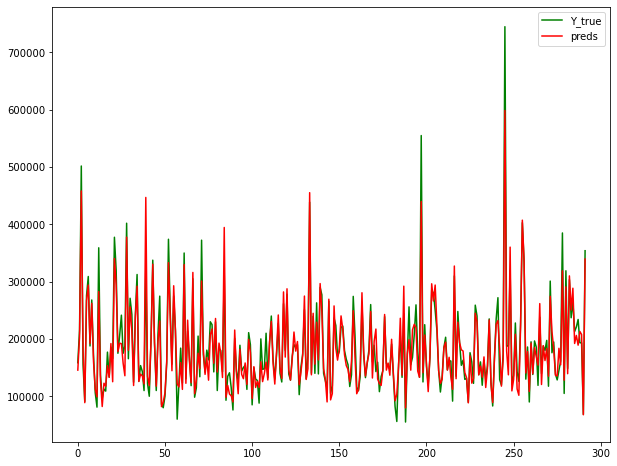

Fold = 2, RMSE = 25069.599132493826


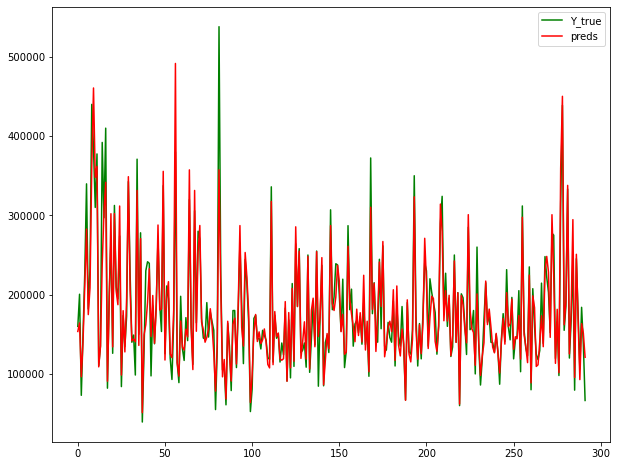

Fold = 3, RMSE = 25724.235739573585


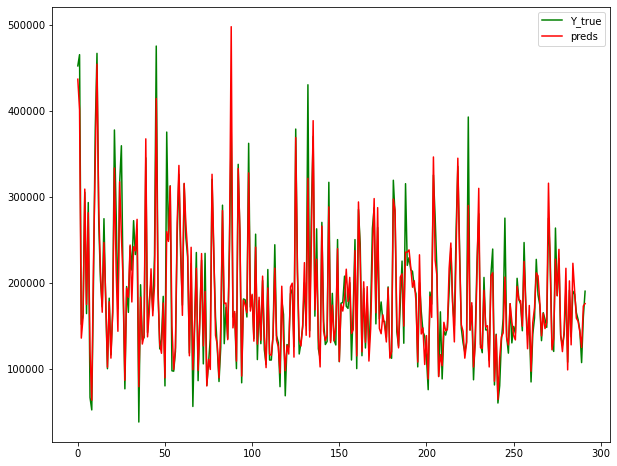

Fold = 4, RMSE = 23776.865275856202
mean_score =  30886.55189525981


In [87]:
# best score around 20000 pre clusters
RMSE_arr=[]
for i in np.arange(5):
    score= run(df=train_df[sub1],target=target,model=et,fold=i,dropped=[],save_fold_csv=False)  ; RMSE_arr.append(score)
print('mean_score = ', np.mean(RMSE_arr))

# remove outlier from train stuffs

In [88]:
def Calculate_IQR(df,col,get_new_df=False):
        q1 = df[col].quantile(0.25)  ; q3 = df[col].quantile(0.75)
        IQR = q3-q1
        lower_limit = q1 - 1.5*IQR  ; upper_limit = q3 + 1.5*IQR
        print("DESC")
        print(df[col].describe())
        print(" ")
        
        lower = df[(df[col]<lower_limit)]
        upper = df[(df[col] > upper_limit)]
        
        print('lower_limit = ',lower_limit,'   ||  ',' upper_limit = ',upper_limit)
        print('Counts == ; lower_limit = ',lower.shape[0],'   ||  ',' upper_limit = ',upper.shape[0])
        
        print(" ")
        possible_outlier = df[col][(df[col]<lower_limit) | (df[col] > upper_limit)]
        
        new_dist= df[(df[col]>lower_limit) & (df[col] < upper_limit)]
        print("Number of possible Outliers = ", len(possible_outlier))
        if len(possible_outlier) > 0:
            print("Outliers : ")
            print("head  : ",possible_outlier.head(3))
            print("tail  : ",possible_outlier.tail(3))
        print("================================================")
        if get_new_df == True:
            return new_dist
        
no_outlier = Calculate_IQR(df=train_df,col='SalePrice',get_new_df=True)

DESC
count      1460.000000
mean     180921.195890
std       79442.502883
min       34900.000000
25%      129975.000000
50%      163000.000000
75%      214000.000000
max      755000.000000
Name: SalePrice, dtype: float64
 
lower_limit =  3937.5    ||    upper_limit =  340037.5
Counts == ; lower_limit =  0    ||    upper_limit =  61
 
Number of possible Outliers =  61
Outliers : 
head  :  11    345000
53    385000
58    438780
Name: SalePrice, dtype: int64
tail  :  1373    466500
1388    377500
1437    394617
Name: SalePrice, dtype: int64


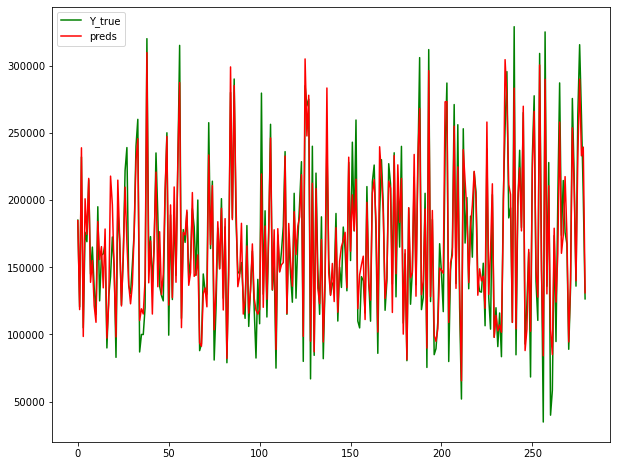

Fold = 0, RMSE = 19683.362154850656


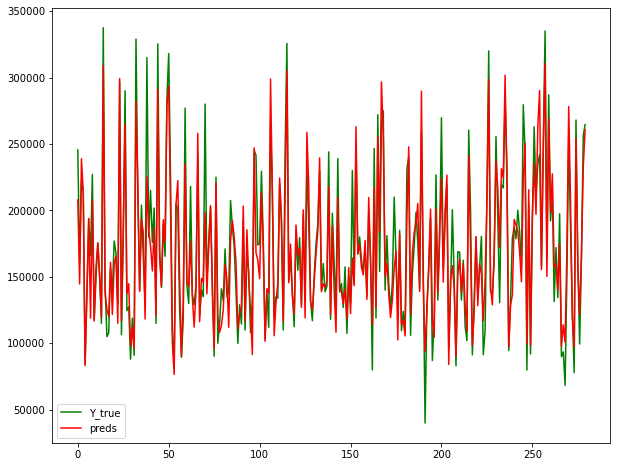

Fold = 1, RMSE = 20067.0895076766


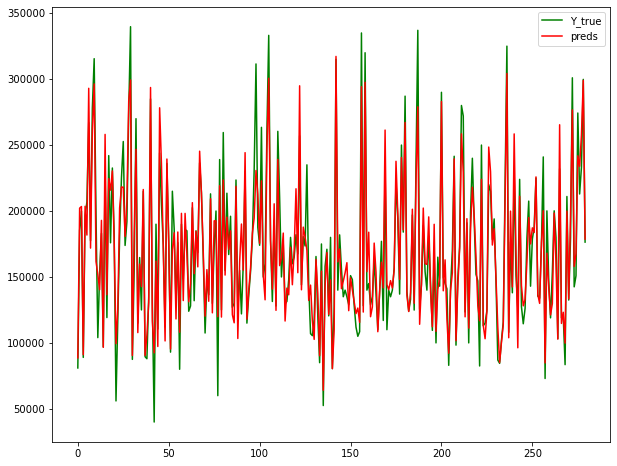

Fold = 2, RMSE = 19637.708054024668


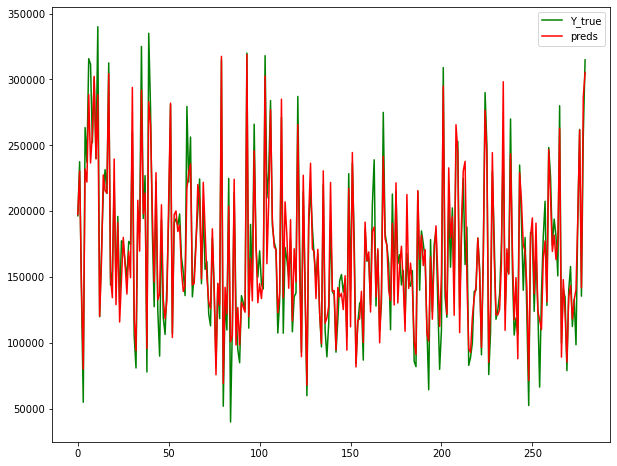

Fold = 3, RMSE = 19238.210900648442


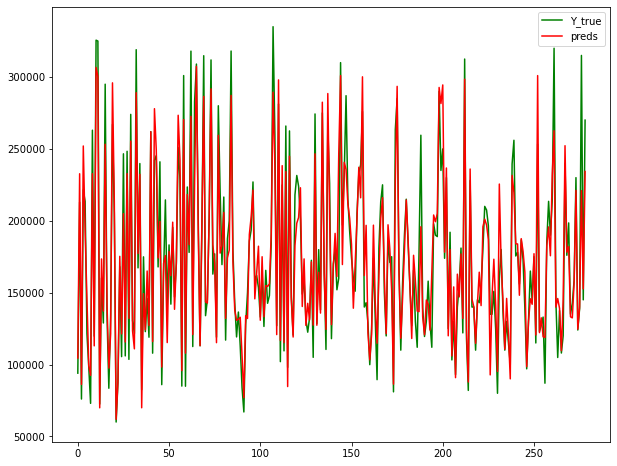

Fold = 4, RMSE = 20736.151846626828
mean_score =  19872.504492765438


In [92]:
# best score around 20000 pre clusters
RMSE_arr=[]
for i in np.arange(5):
    score= run(df=no_outlier[sub1],target=target,model=baseline,fold=i,dropped=[],save_fold_csv=False)  ; RMSE_arr.append(score)
print('mean_score = ', np.mean(RMSE_arr))

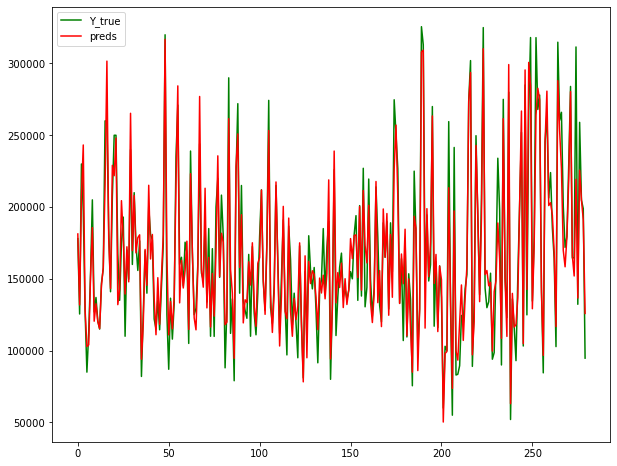

Fold = 0, RMSE = 18376.282471656945


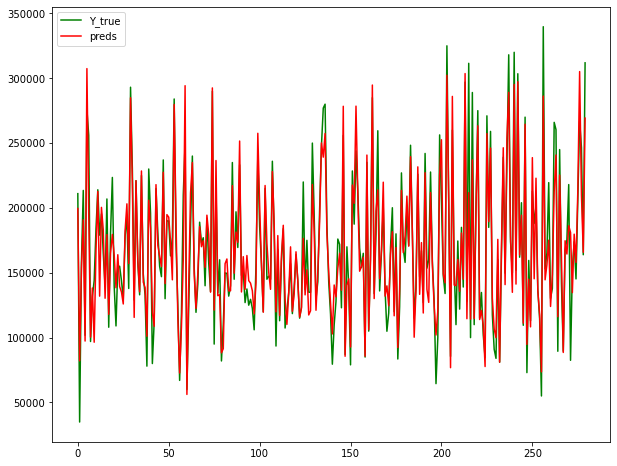

Fold = 1, RMSE = 20193.092882342848


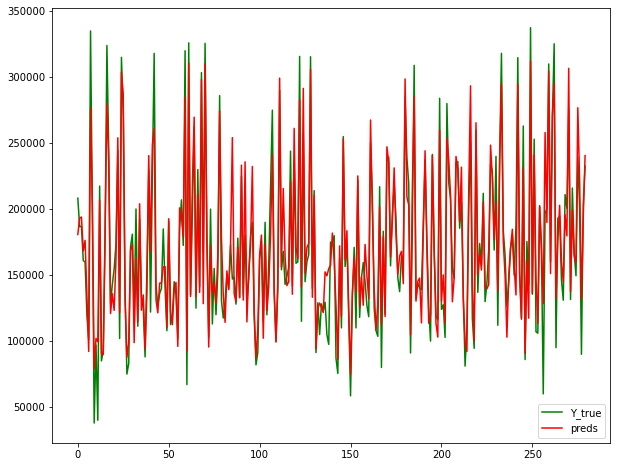

Fold = 2, RMSE = 20832.580795545786


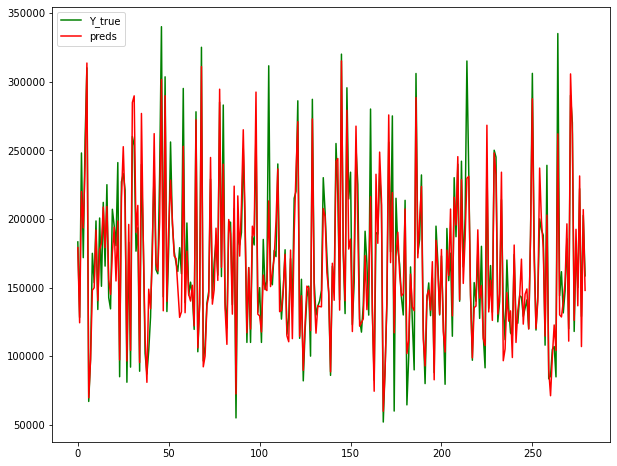

Fold = 3, RMSE = 19663.631406656925


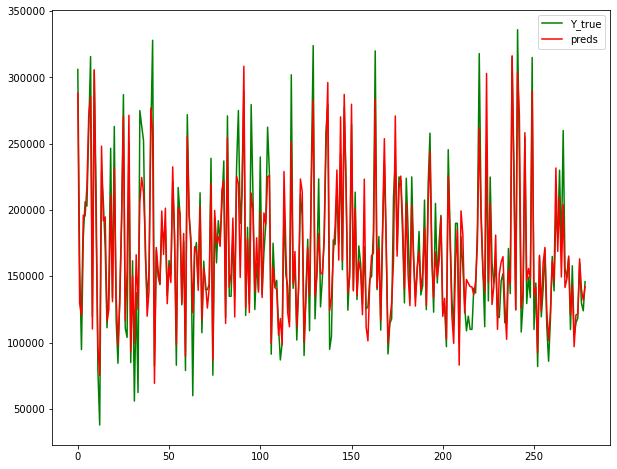

Fold = 4, RMSE = 20568.643666404136
mean_score =  19926.84624452133


In [90]:
# best score around 20000 pre clusters
RMSE_arr=[]
for i in np.arange(5):
    score= run(df=no_outlier[sub1],target=target,model=et,fold=i,dropped=[],save_fold_csv=False)  ; RMSE_arr.append(score)
print('mean_score = ', np.mean(RMSE_arr))

# NO_no_outliers

In [93]:
def get_no_outlier(df_in):
    df = df_in.copy()
    df= df[df['total_indoor_sqft']<= 11000]
    df = df[df['GrLivArea'] <= 4000]
    df = df[df['TotalBsmtSF'] <= 4000]
    df = df[df['1stFlrSF'] <= 3000]
    df = df[df['no_finishes'] <= 100000]
    df = df[df['TotalBsmtSF'] <= 4000]
    df = df[df['LotFrontage'] <= 250]
    df = df[df['BsmtFinSF1'] <= 4000]
    df = df[df['MasVnrArea'] <=1200]
    return df
No_no_outlier = get_no_outlier(df_in=no_outlier)

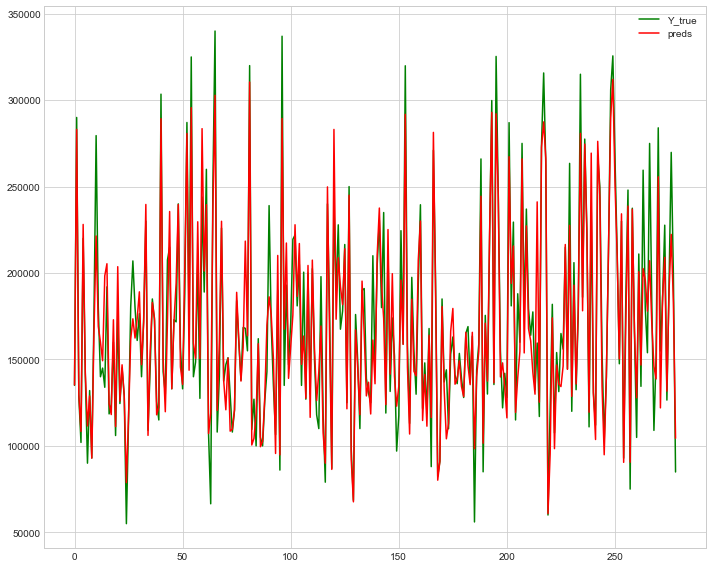

Fold = 0, RMSE = 19575.692315217006


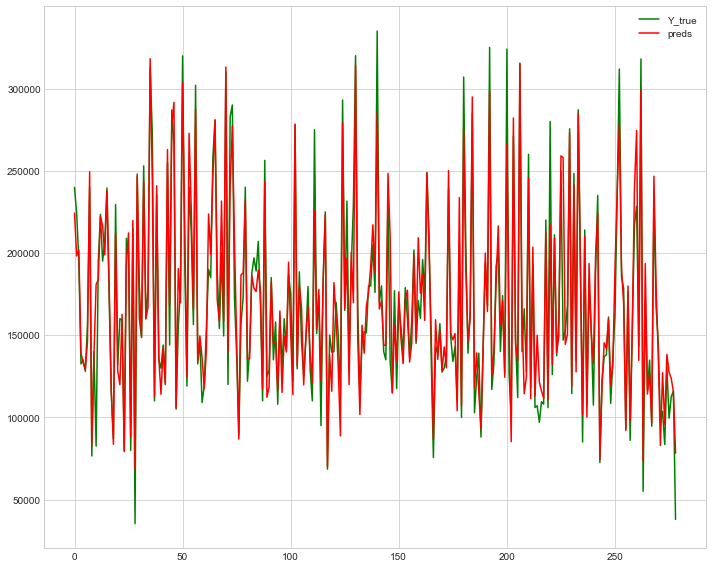

Fold = 1, RMSE = 19491.661699439315


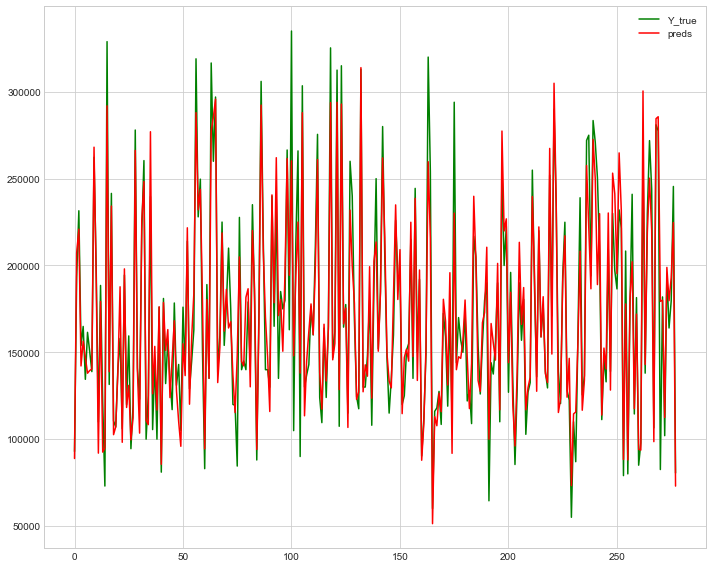

Fold = 2, RMSE = 19857.237358968403


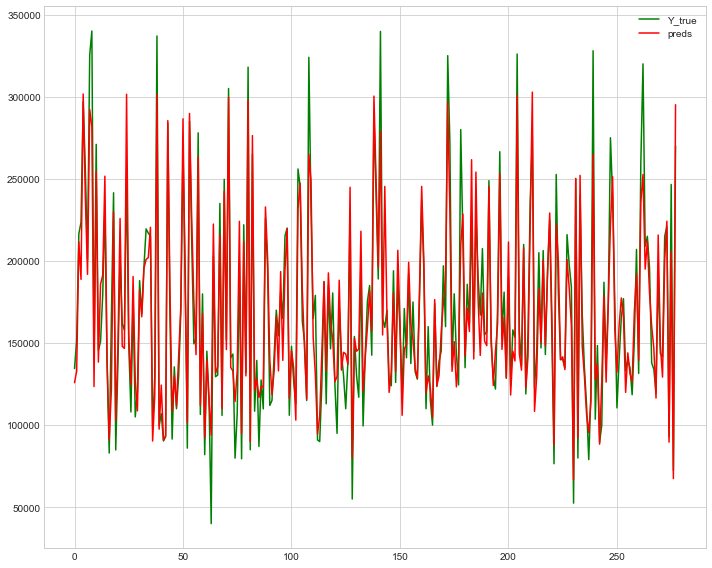

Fold = 3, RMSE = 19625.508417874473


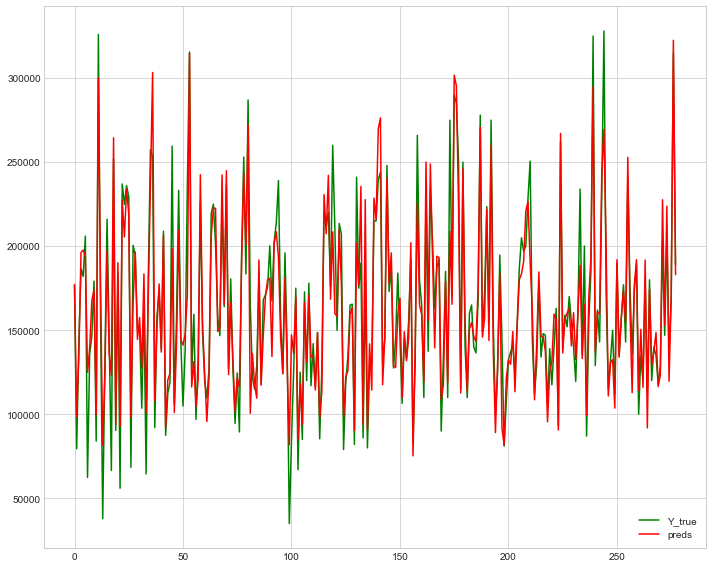

Fold = 4, RMSE = 19607.73712948401
mean_score =  19631.56738419664


In [144]:
# best score around 20000 pre clusters
RMSE_arr=[]
for i in np.arange(5):
    score= run(df=No_no_outlier[sub1],target=target,model=et,fold=i,dropped=[],save_fold_csv=False)  ; RMSE_arr.append(score)
print('mean_score = ', np.mean(RMSE_arr))

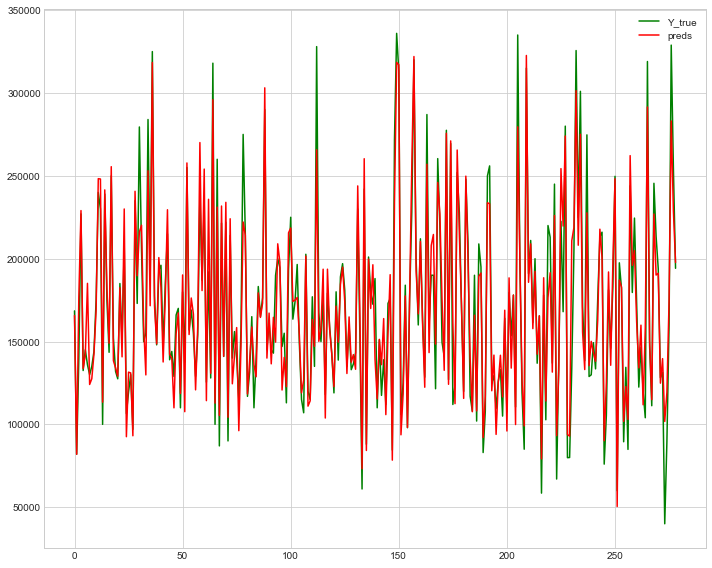

Fold = 0, RMSE = 18375.43623448455


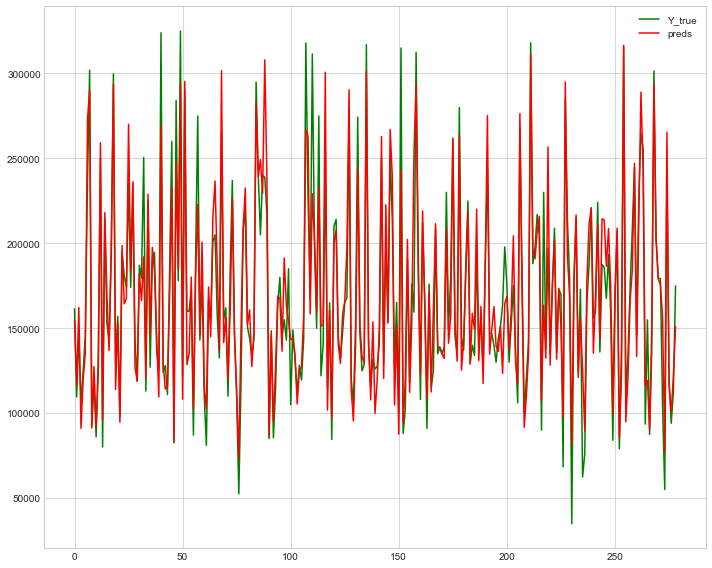

Fold = 1, RMSE = 20858.779980460855


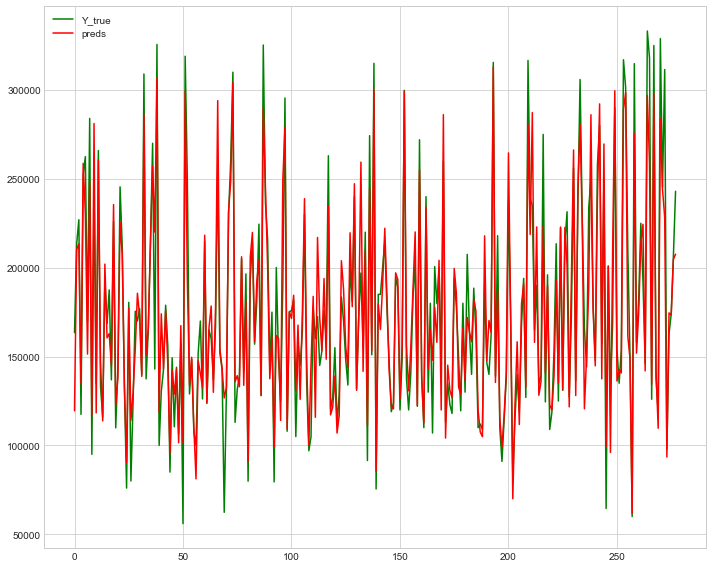

Fold = 2, RMSE = 20796.655231817585


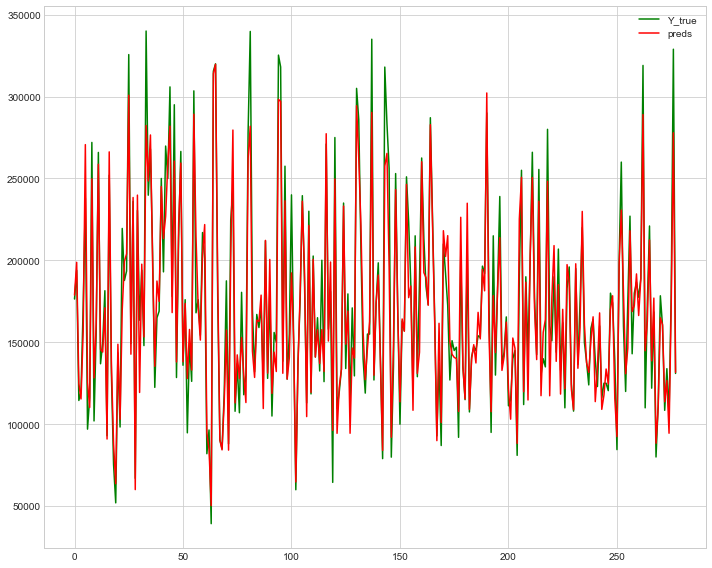

Fold = 3, RMSE = 17904.41731691842


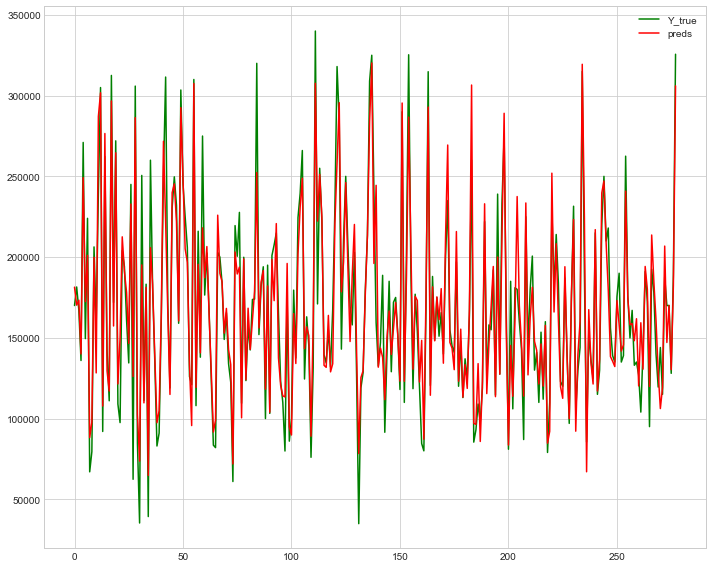

Fold = 4, RMSE = 20830.624465041416
mean_score =  19753.182645744564


In [145]:
# best score around 20000 pre clusters
keeps= [ 'indoor_Cluster', 'outdoor_Cluster','in_out_Cluster', 'All_Q_Cluster']
drops =  [  'Bmt_Ql_Cd_Cluster','Ext_Q_Cd_Cluster',
       'Bmt_F_A_Cluster', 'Gar_Q_Cd_Cluster', ]
RMSE_arr=[]
for i in np.arange(5):
    score= run(df=No_no_outlier[sub1],target=target,model=et,fold=i,dropped=drops,save_fold_csv=False)  ; RMSE_arr.append(score)
print('mean_score = ', np.mean(RMSE_arr))

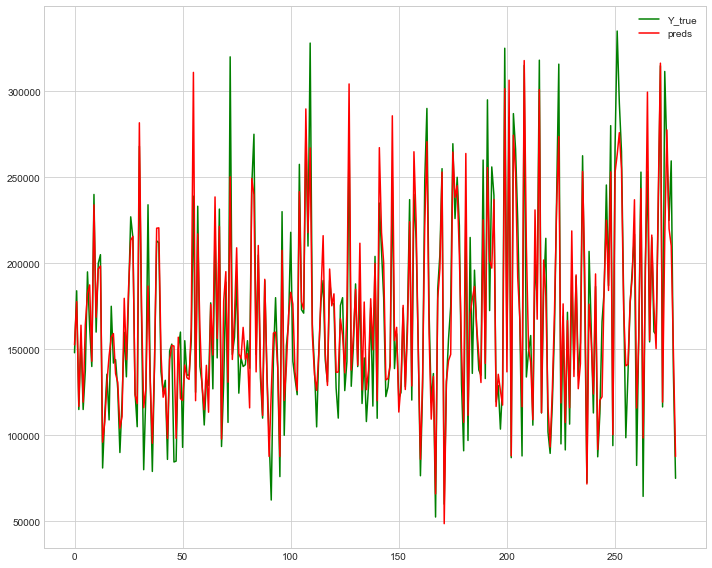

Fold = 0, RMSE = 21064.124175249275


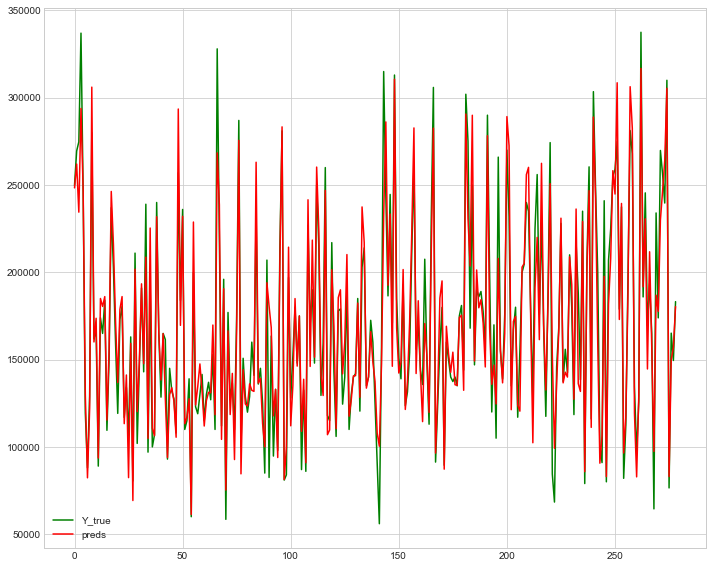

Fold = 1, RMSE = 19375.42562448442


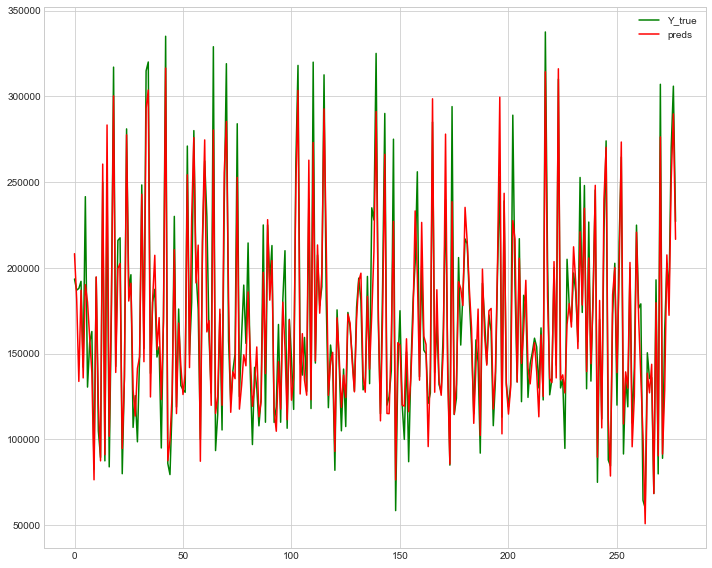

Fold = 2, RMSE = 19465.048312273426


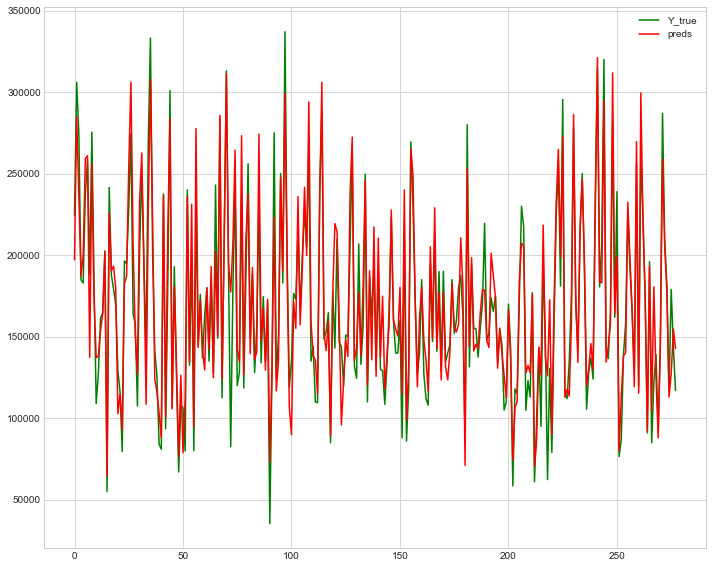

Fold = 3, RMSE = 20007.094735603638


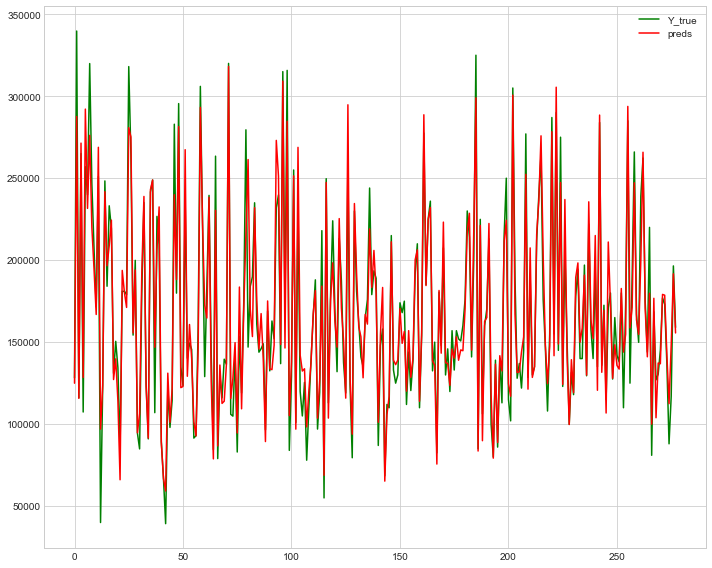

Fold = 4, RMSE = 17798.07395753699
mean_score =  19541.95336102955


In [146]:
# best score around 20000 pre clusters
keeps= [ 'indoor_Cluster', 'outdoor_Cluster','in_out_Cluster', 'All_Q_Cluster']
drops =  [  'Bmt_Ql_Cd_Cluster','Ext_Q_Cd_Cluster',
       'Bmt_F_A_Cluster', 'Gar_Q_Cd_Cluster', ]
RMSE_arr=[]
for i in np.arange(5):
    score= run(df=No_no_outlier[sub1],target=target,model=et,fold=i,dropped=keeps,save_fold_csv=False)  ; RMSE_arr.append(score)
print('mean_score = ', np.mean(RMSE_arr))

#### 10 clusters
sub1=19631
dropped_drops=19753
dropped_keeps= 19541

# relplot

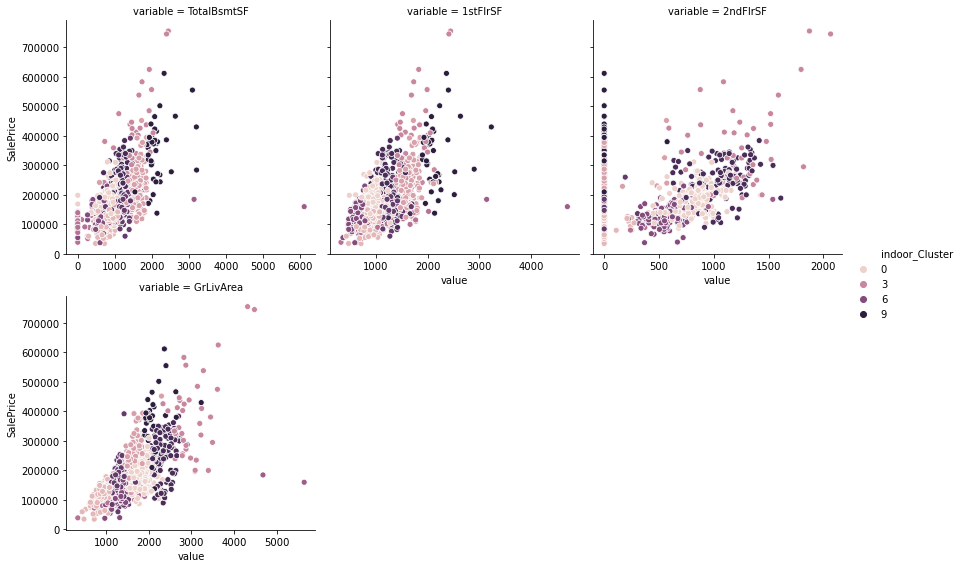

In [96]:
sns.relplot(
    x="value", y="SalePrice", hue='indoor_Cluster', col="variable",
    height=4, aspect=1, facet_kws={'sharex': False}, col_wrap=3,
    data=train_df.melt(
        value_vars=indoor, id_vars=["SalePrice", 'indoor_Cluster'],
    ),
);


In [100]:
train_df.melt(
        value_vars=indoor, id_vars=["SalePrice", 'indoor_Cluster'],
    )

,SalePrice,indoor_Cluster,variable,value
0,208500,0,TotalBsmtSF,856.0
1,181500,7,TotalBsmtSF,1262.0
2,223500,0,TotalBsmtSF,920.0
3,140000,0,TotalBsmtSF,756.0
4,250000,8,TotalBsmtSF,1145.0
...,...,...,...,...
5835,175000,0,GrLivArea,1647.0
5836,210000,9,GrLivArea,2073.0
5837,266500,8,GrLivArea,2340.0
5838,142125,1,GrLivArea,1078.0


In [97]:
def plot_clusters(df,target,group_name_list,cluster_col_list):
    for group,cluster_name in zip(group_name_list,cluster_col_list):
        print('Cluster columns = ',cluster_name)
        sns.relplot(
            x="value", y=target, hue=cluster_name, col="variable",
            height=4, aspect=1, facet_kws={'sharex': False}, col_wrap=3,
            data=df.melt(
                value_vars= group, id_vars=[target,cluster_name],
            ),
        ); 
        plt.show()
        print('======================================')

In [98]:
group_name_list = [indoor,outdoor,in_out,Ext_Qual_Cond,Bmt_Qual_Cond,Bmt_Fnsh_Area,Garage_Qual_Cond,All_Qualities]
cluster_col_list = [ 'indoor_Cluster', 'outdoor_Cluster','in_out_Cluster', 'Ext_Q_Cd_Cluster', 'Bmt_Ql_Cd_Cluster',
       'Bmt_F_A_Cluster', 'Gar_Q_Cd_Cluster', 'All_Q_Cluster']

Cluster columns =  indoor_Cluster


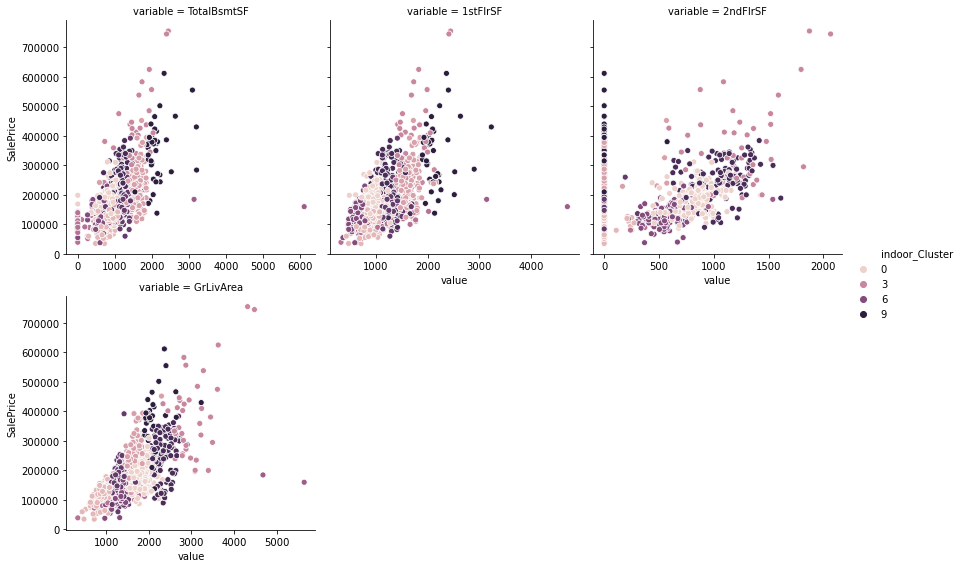

Cluster columns =  outdoor_Cluster


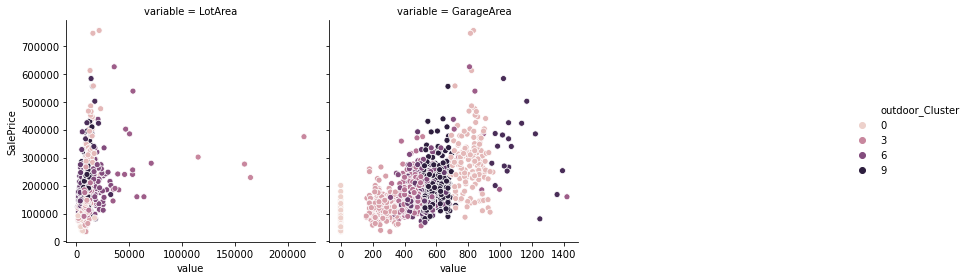

Cluster columns =  in_out_Cluster


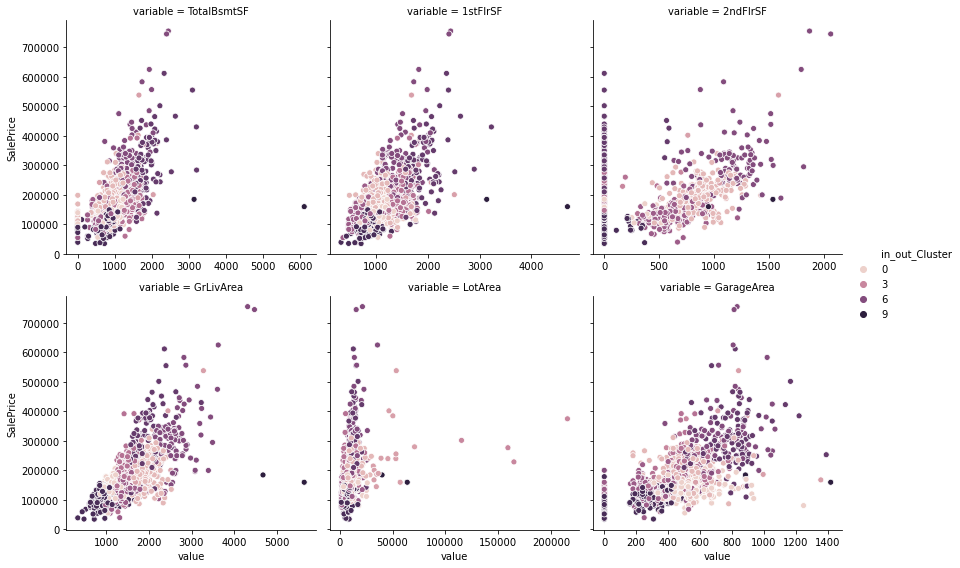

Cluster columns =  Ext_Q_Cd_Cluster


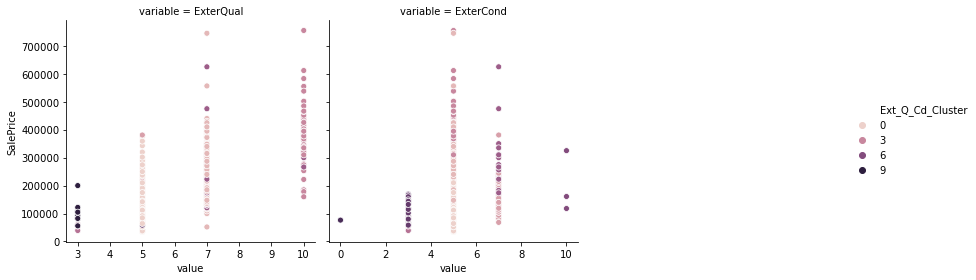

Cluster columns =  Bmt_Ql_Cd_Cluster


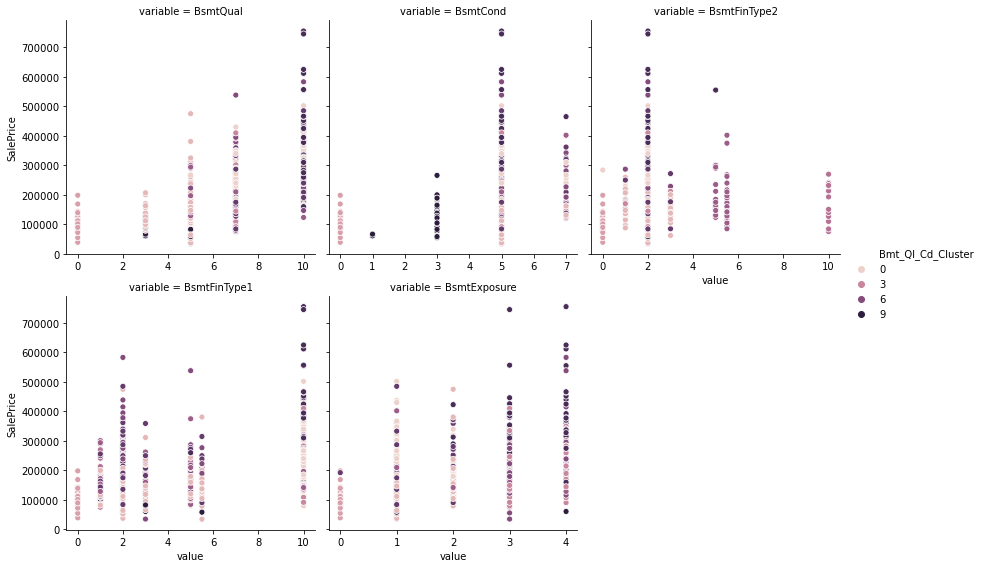

Cluster columns =  Bmt_F_A_Cluster


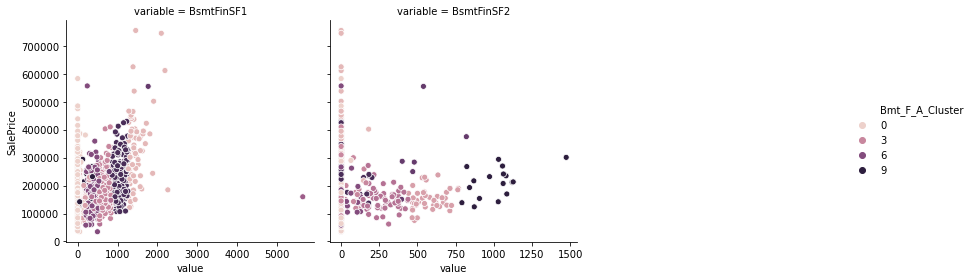

Cluster columns =  Gar_Q_Cd_Cluster


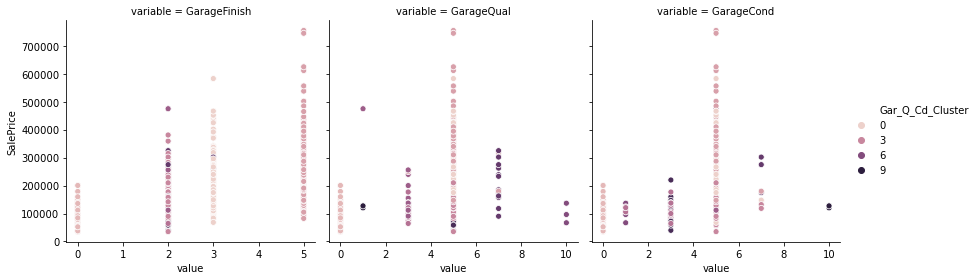

Cluster columns =  All_Q_Cluster


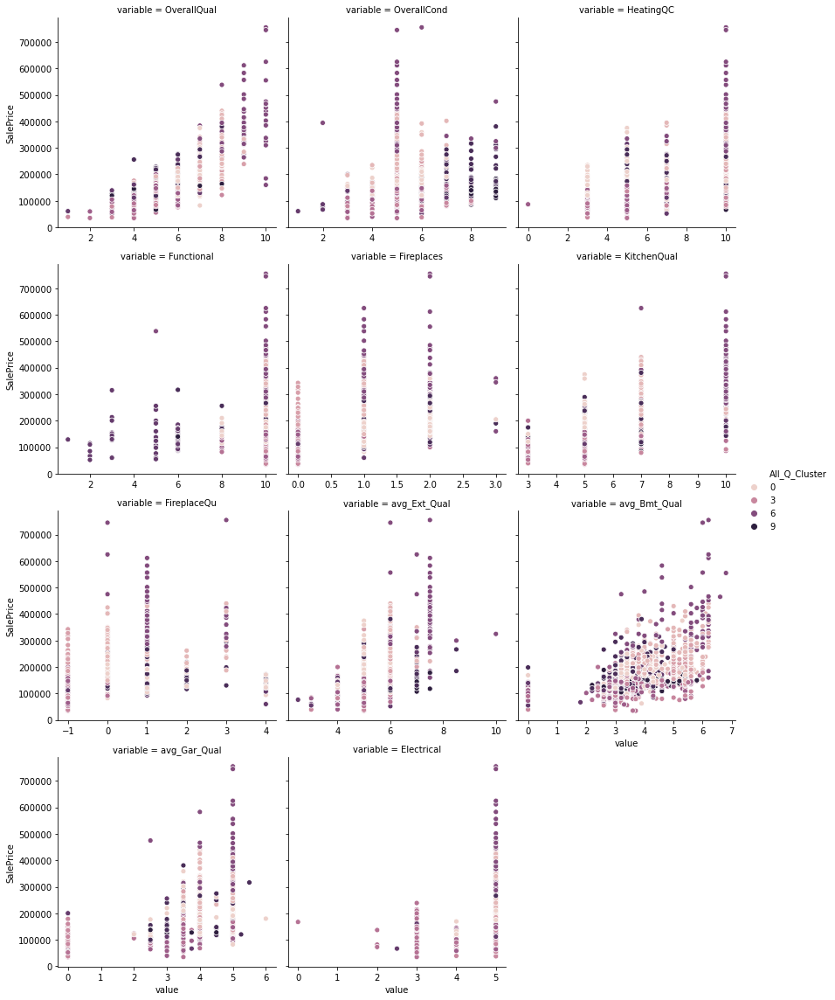

In [99]:
plot_clusters(train_df,target,group_name_list,cluster_col_list)

Cluster columns =  indoor_Cluster


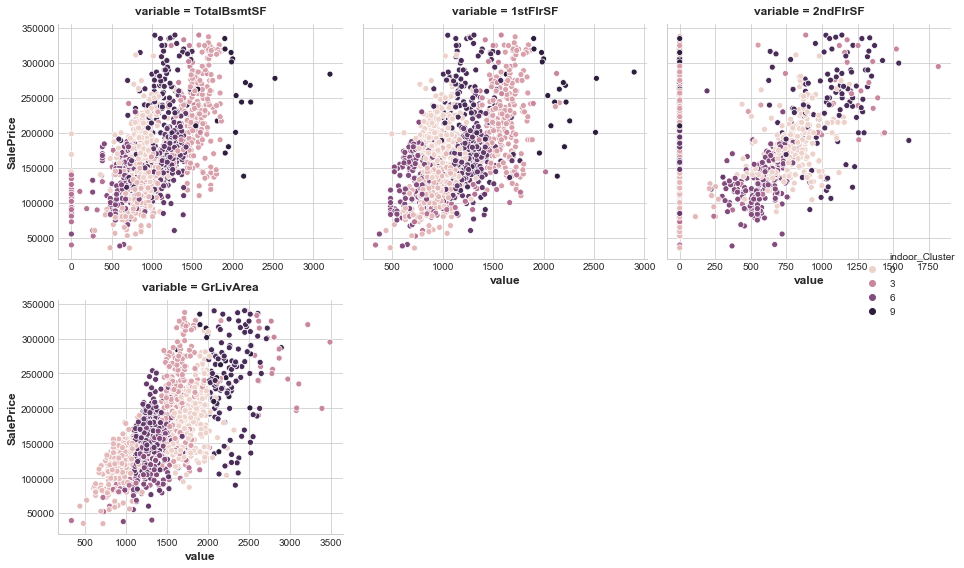

Cluster columns =  outdoor_Cluster


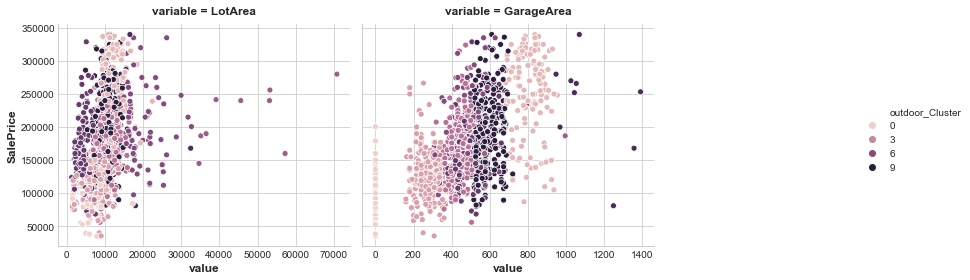

Cluster columns =  in_out_Cluster


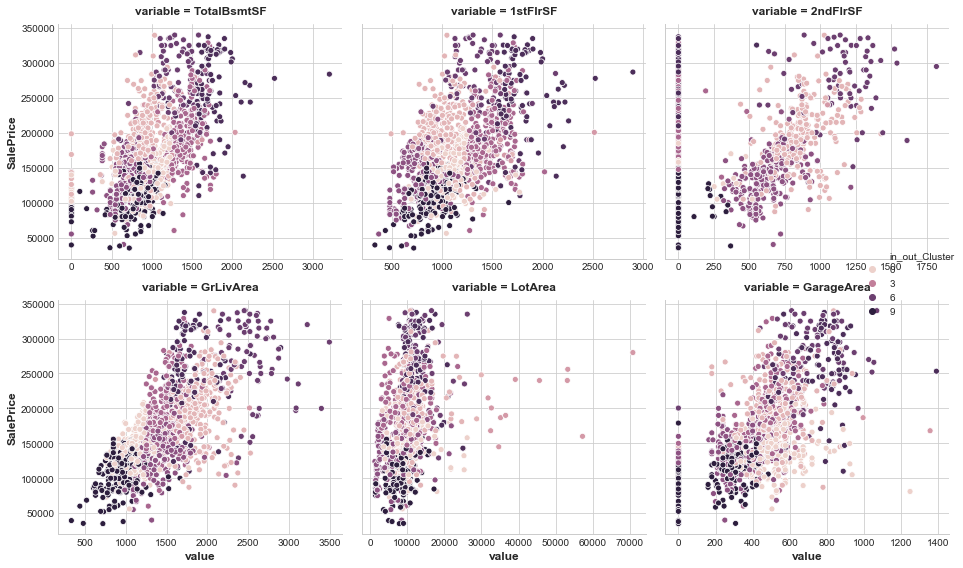

Cluster columns =  Ext_Q_Cd_Cluster


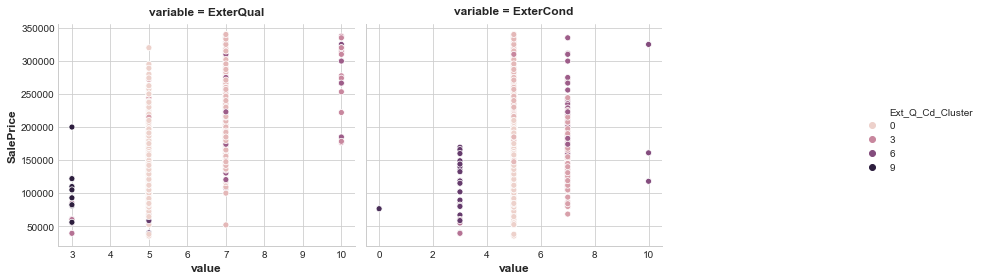

Cluster columns =  Bmt_Ql_Cd_Cluster


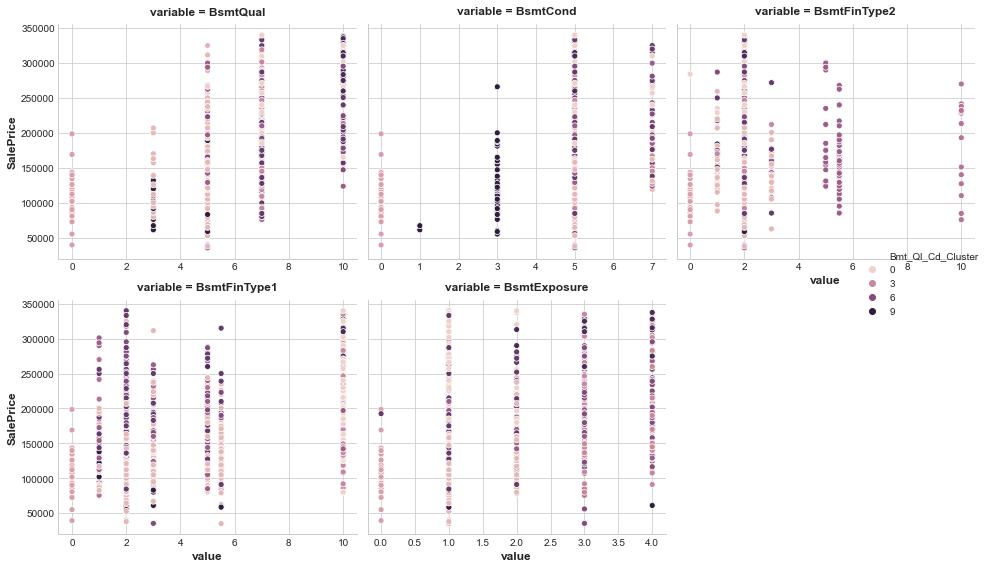

Cluster columns =  Bmt_F_A_Cluster


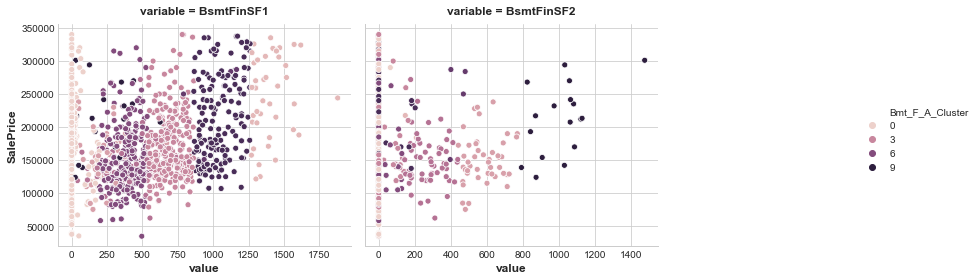

Cluster columns =  Gar_Q_Cd_Cluster


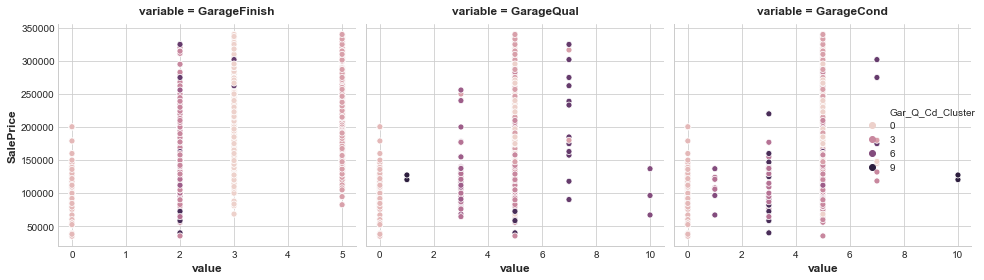

Cluster columns =  All_Q_Cluster


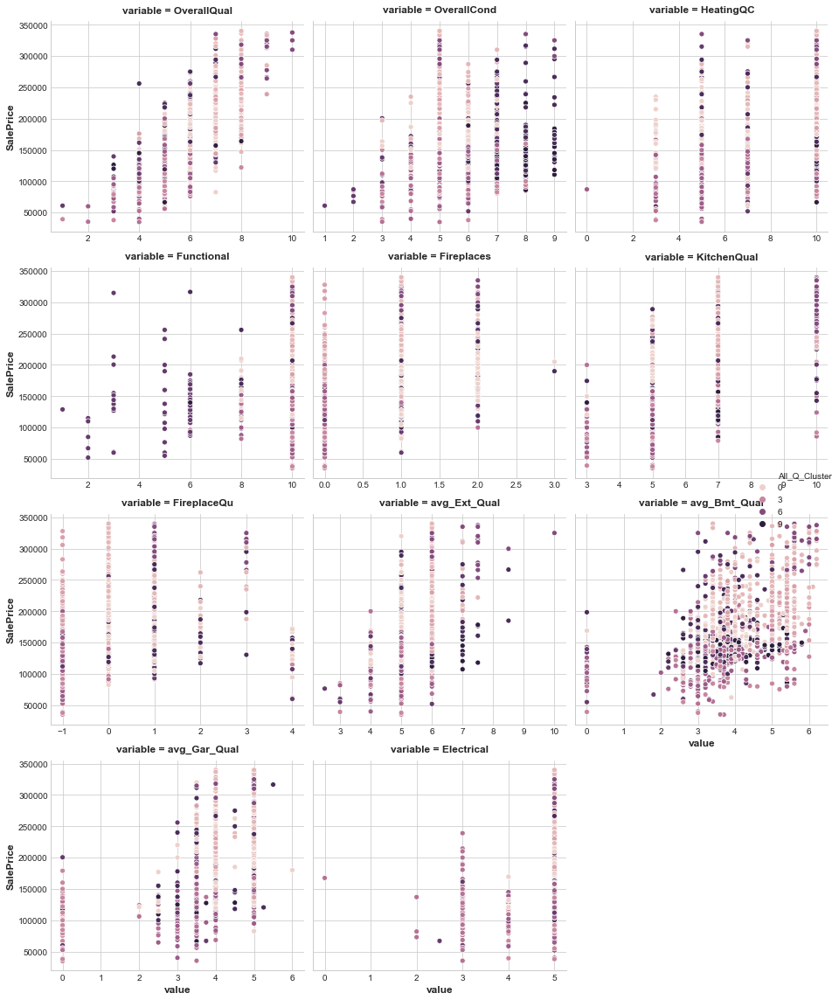

In [130]:
plot_clusters(No_no_outlier,target,group_name_list,cluster_col_list)

# optimise number of clusters using elbow plot

Text(0, 0.5, 'square sum error')

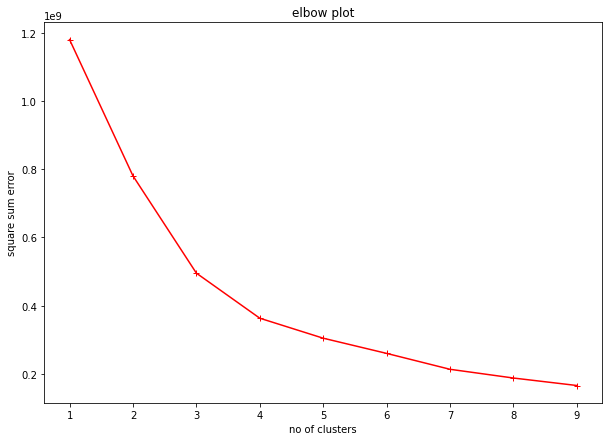

In [102]:
# from cluster baby
#elbow plot
k_rng = range(1,10)
sse=[]
for i in k_rng:
    k=KMeans(n_clusters=i)
    k.fit(train_df.loc[:,indoor])
    sse.append(k.inertia_)
    
plt.figure(figsize=(10,7))
plt.plot(k_rng,sse,'-r+')
plt.title('elbow plot')
plt.xlabel('no of clusters')
plt.ylabel('square sum error')

In [103]:
def plot_elbow_plot(df,column_list):
    k_rng = range(1,10)
    sse=[]
    for i in k_rng:
        k=KMeans(n_clusters=i)
        k.fit(df.loc[:,column_list])
        sse.append(k.inertia_)

    plt.figure(figsize=(10,7))
    plt.plot(k_rng,sse,'-r+')
    plt.title('elbow plot')
    plt.xlabel('no of clusters')
    plt.ylabel('square sum error')

In [ ]:
def plot_elbow_plot(X_in,column_list):
    X = X_in.copy()
    y = X.pop(target)
    
    #features = ['LotArea', 'TotalBsmtSF', 'FirstFlrSF', 'SecondFlrSF','GrLivArea']
    for features in column_list:
        # Standardize
        X_scaled = X.loc[:, features]
        X_scaled = (X_scaled - X_scaled.mean(axis=0)) / X_scaled.std(axis=0)

        # Fit the KMeans model to X_scaled and create the cluster labels
        #kmeans = KMeans( n_clusters=n_clusters, random_state=0)

        #X_scaled = (X_scaled - X_scaled.mean(axis=0)) / X_scaled.std(axis=0)
    
    k_rng = range(1,10)
    sse=[]
    for i in k_rng:
        k=KMeans(n_clusters=i)
        k.fit(X_scaled)
        sse.append(k.inertia_)

    plt.figure(figsize=(10,7))
    plt.plot(k_rng,sse,'-r+')
    plt.title('elbow plot')
    plt.xlabel('no of clusters')
    plt.ylabel('square sum error')

cluster group =  ['TotalBsmtSF', '1stFlrSF', '2ndFlrSF', 'GrLivArea']


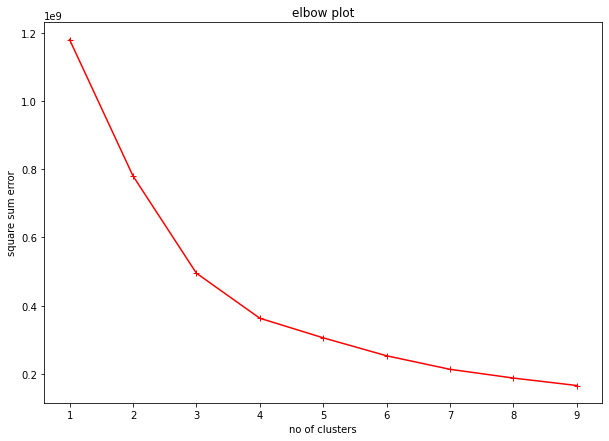

cluster group =  ['LotArea', 'GarageArea']


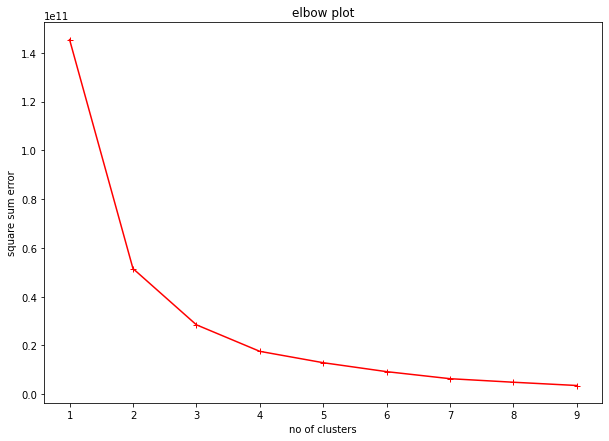

cluster group =  ['TotalBsmtSF', '1stFlrSF', '2ndFlrSF', 'GrLivArea', 'LotArea', 'GarageArea']


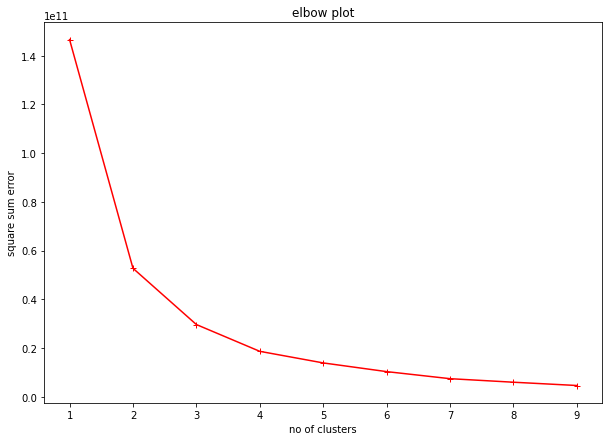

cluster group =  ['ExterQual', 'ExterCond']


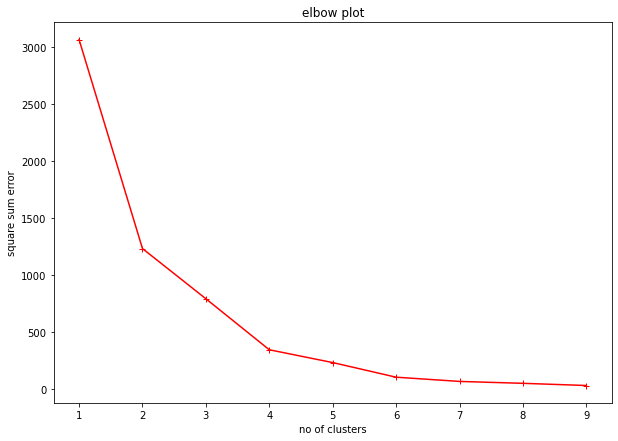

cluster group =  ['BsmtQual', 'BsmtCond', 'BsmtFinType2', 'BsmtFinType1', 'BsmtExposure']


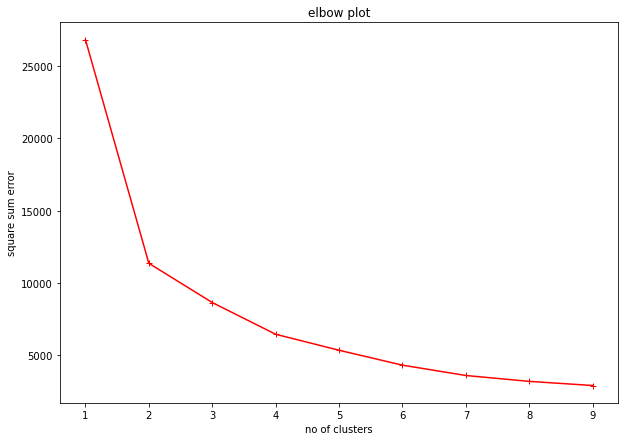

cluster group =  ['BsmtFinSF1', 'BsmtFinSF2']


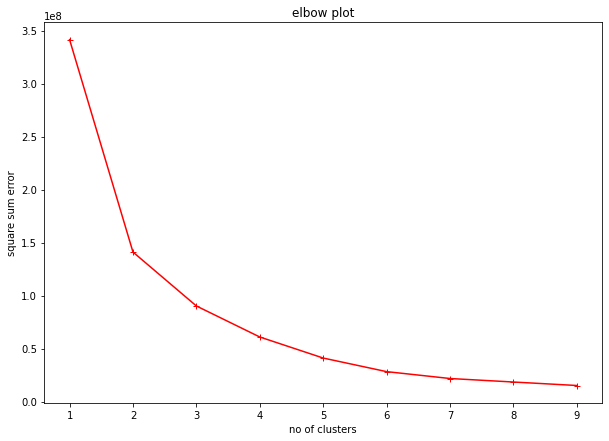

cluster group =  ['GarageFinish', 'GarageQual', 'GarageCond', 'GarageFinish']


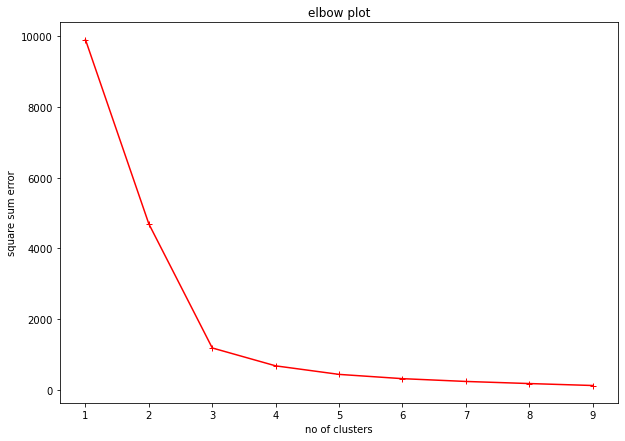

cluster group =  ['OverallQual', 'OverallCond', 'HeatingQC', 'Functional', 'Fireplaces', 'KitchenQual', 'FireplaceQu', 'avg_Ext_Qual', 'avg_Bmt_Qual', 'avg_Gar_Qual', 'Electrical']


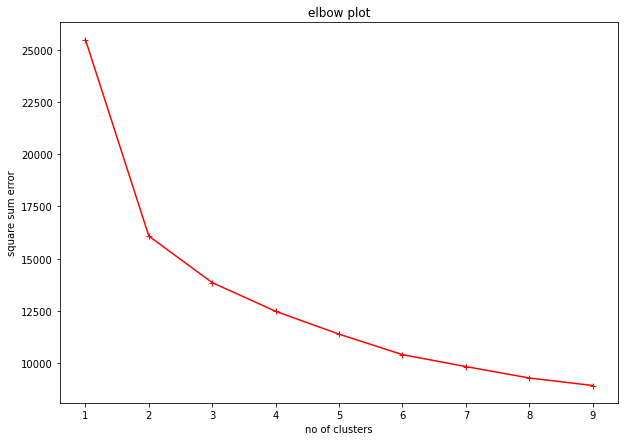

In [104]:
for col_list in group_name_list:
    print('cluster group = ',col_list)
    plot_elbow_plot(train_df,col_list)
    plt.show()
    print('=============================================================================')

cluster group =  ['TotalBsmtSF', '1stFlrSF', '2ndFlrSF', 'GrLivArea']


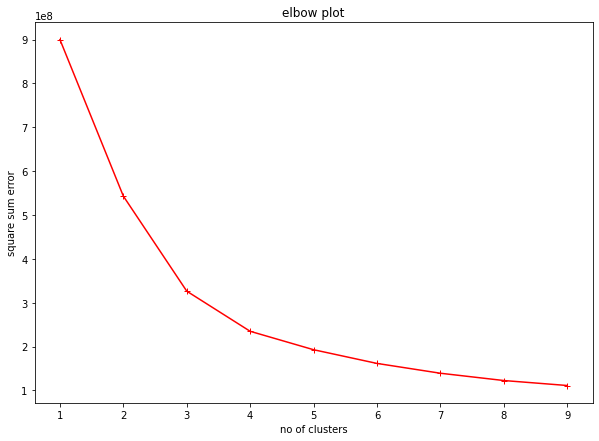

cluster group =  ['LotArea', 'GarageArea']


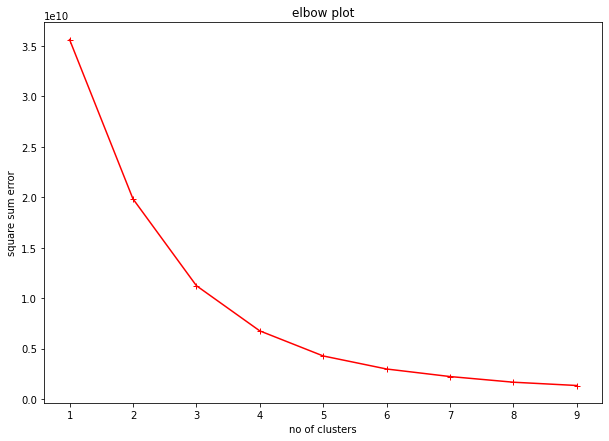

cluster group =  ['TotalBsmtSF', '1stFlrSF', '2ndFlrSF', 'GrLivArea', 'LotArea', 'GarageArea']


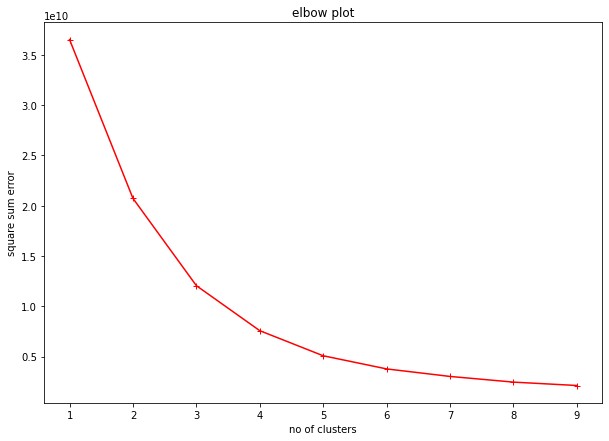

cluster group =  ['ExterQual', 'ExterCond']


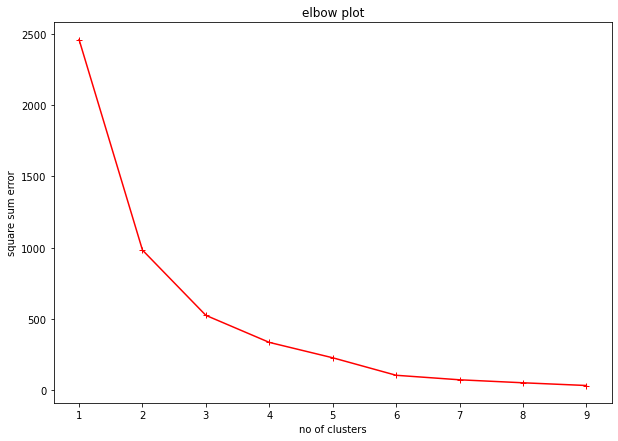

cluster group =  ['BsmtQual', 'BsmtCond', 'BsmtFinType2', 'BsmtFinType1', 'BsmtExposure']


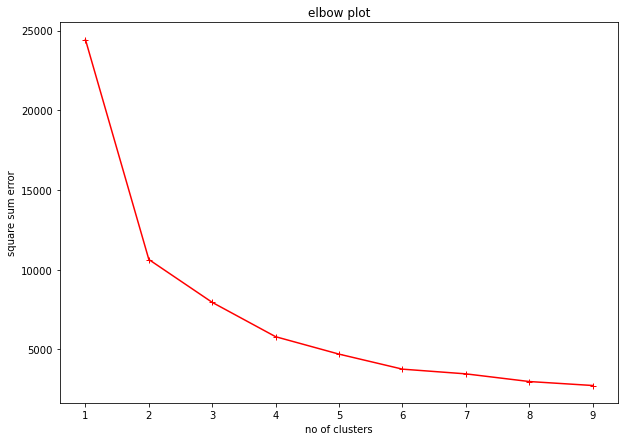

cluster group =  ['BsmtFinSF1', 'BsmtFinSF2']


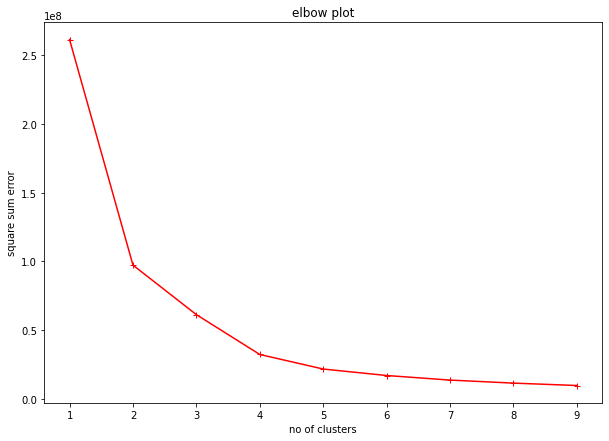

cluster group =  ['GarageFinish', 'GarageQual', 'GarageCond', 'GarageFinish']


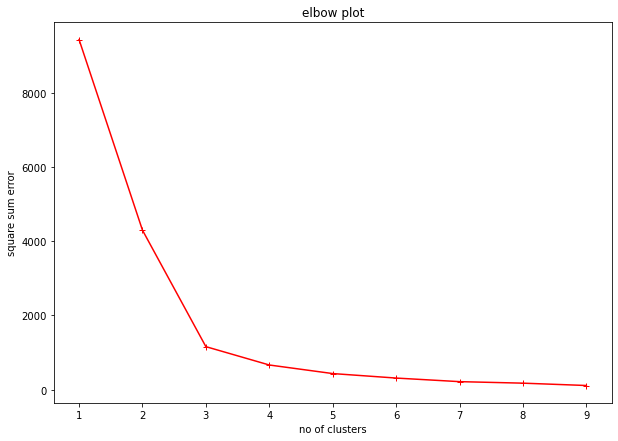

cluster group =  ['OverallQual', 'OverallCond', 'HeatingQC', 'Functional', 'Fireplaces', 'KitchenQual', 'FireplaceQu', 'avg_Ext_Qual', 'avg_Bmt_Qual', 'avg_Gar_Qual', 'Electrical']


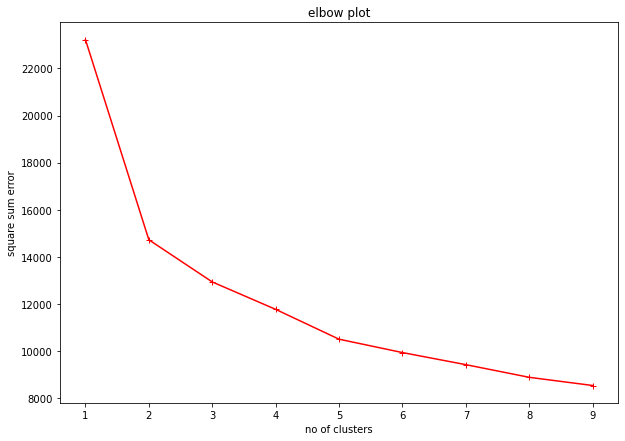

In [106]:
for col_list in group_name_list:
    print('cluster group = ',col_list)
    plot_elbow_plot(No_no_outlier,col_list)
    plt.show()
    print('=============================================================================')

## n_clusters=4 from elbow plot

In [107]:
#n=4
klusters4 =  make_clusters(df=LE_df,target=target,features_list=cluster_features,cluster_name_list=cluster_alias,
                           n_clusters=4)

train_df4 = klusters4.loc[klusters4.SalePrice!='test_col'].reset_index(drop=True)
test_df4 = klusters4.loc[klusters4.SalePrice =='test_col'].reset_index(drop=True)
train_df4.SalePrice = train_df4.SalePrice.apply(int)

In [108]:
scoremxLE4 = make_mi_scores_Regression(X_train=train_df4.drop(['Id','SalePrice','area_per_finishes'],axis=1), y_train=train_df4.SalePrice)

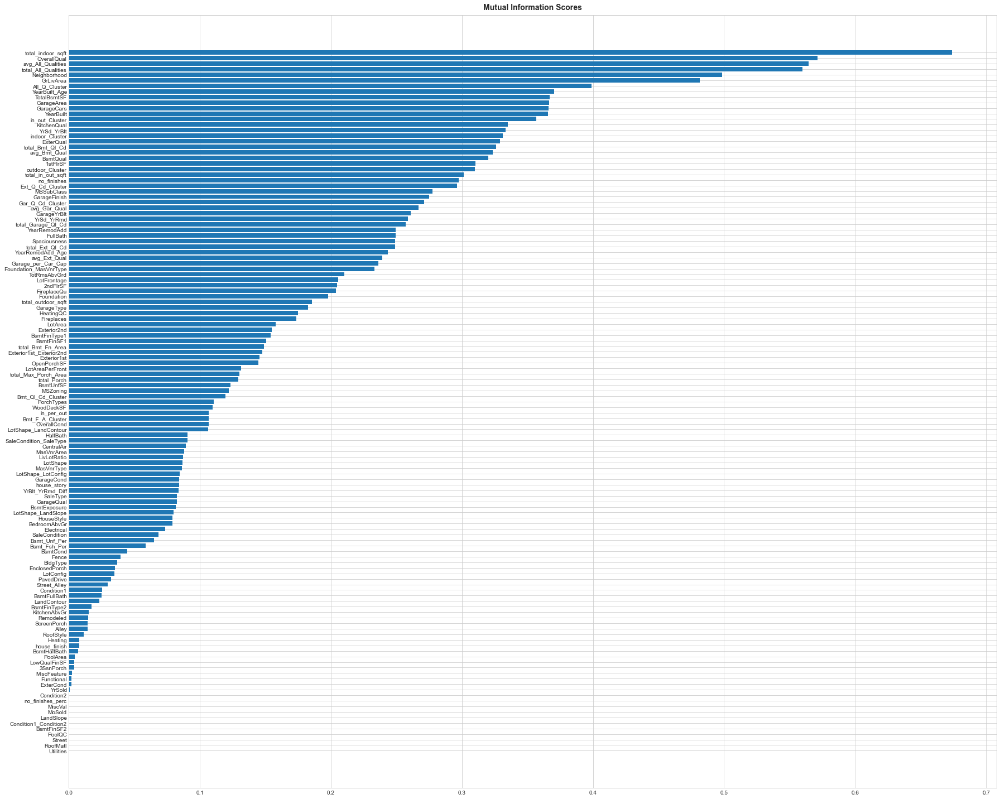

In [133]:
plot_mi_scores(scoremxLE4)

In [110]:
no_outlier4 = Calculate_IQR(df=train_df4,col='SalePrice',get_new_df=True)
No_no_outlier4 = get_no_outlier(df_in=no_outlier4)

DESC
count      1460.000000
mean     180921.195890
std       79442.502883
min       34900.000000
25%      129975.000000
50%      163000.000000
75%      214000.000000
max      755000.000000
Name: SalePrice, dtype: float64
 
lower_limit =  3937.5    ||    upper_limit =  340037.5
Counts == ; lower_limit =  0    ||    upper_limit =  61
 
Number of possible Outliers =  61
Outliers : 
head  :  11    345000
53    385000
58    438780
Name: SalePrice, dtype: int64
tail  :  1373    466500
1388    377500
1437    394617
Name: SalePrice, dtype: int64


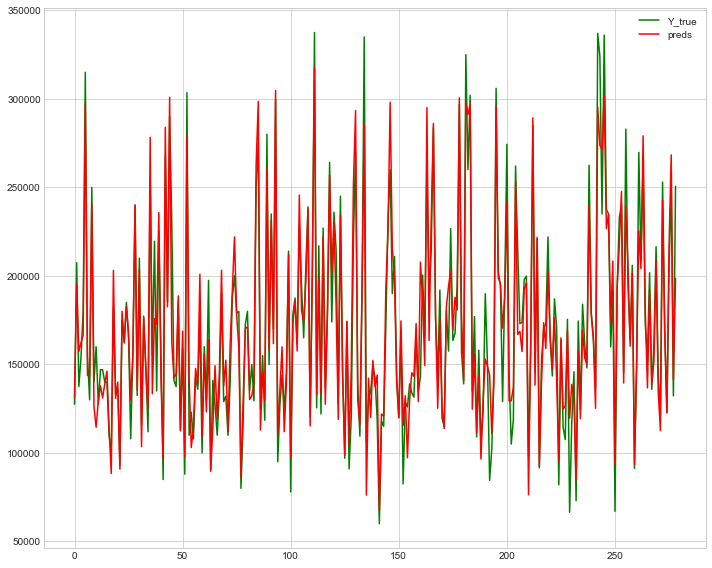

Fold = 0, RMSE = 18153.940465640884


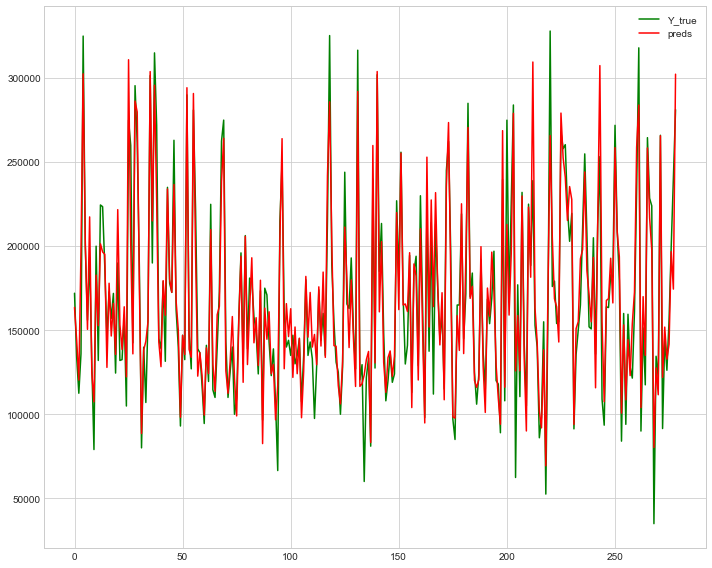

Fold = 1, RMSE = 19794.56928860979


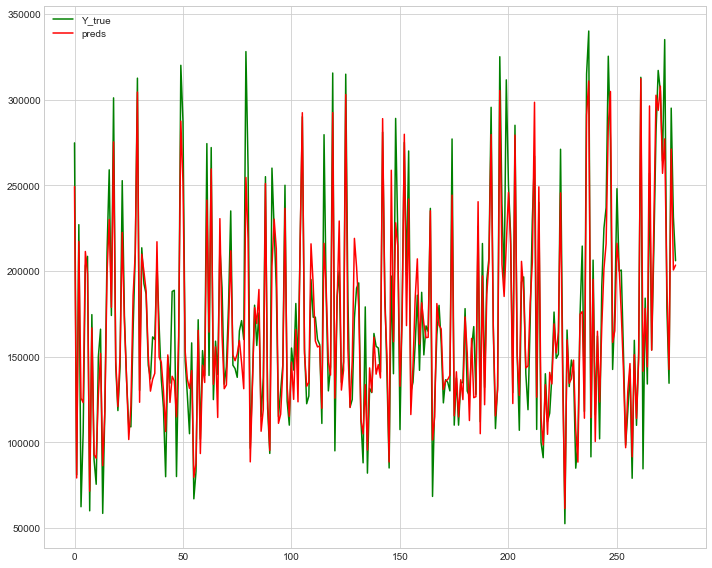

Fold = 2, RMSE = 20495.97308694831


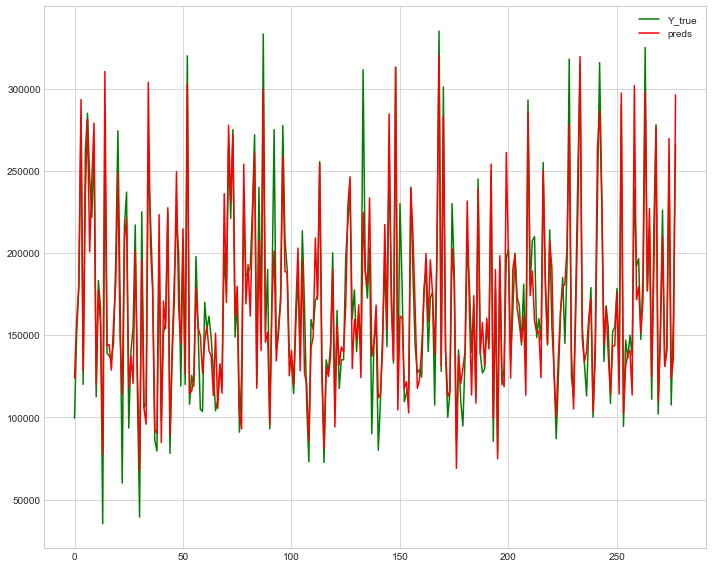

Fold = 3, RMSE = 20064.675660369503


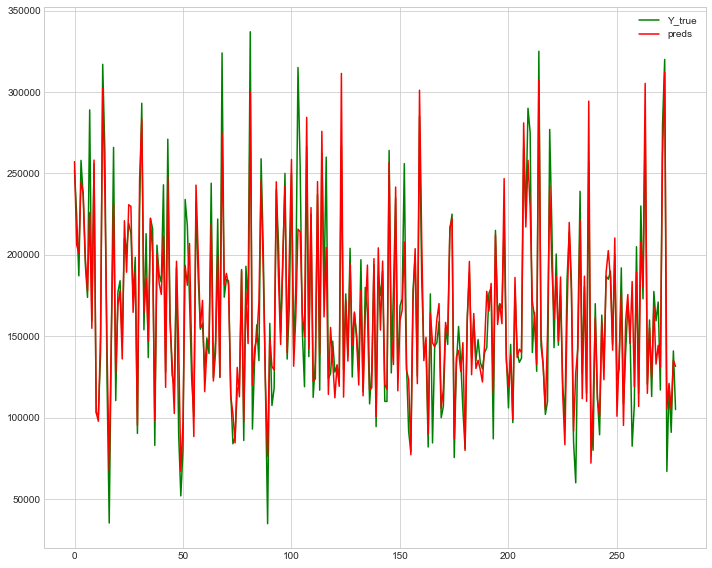

Fold = 4, RMSE = 20349.883247054844
mean_score =  19771.808349724666


In [151]:
# best score around 20000 pre clusters
RMSE_arr=[]
for i in np.arange(5):
    score= run(df=No_no_outlier4[sub1],target=target,model=rf,fold=i,dropped=[],save_fold_csv=False)  ; RMSE_arr.append(score)
print('mean_score = ', np.mean(RMSE_arr))

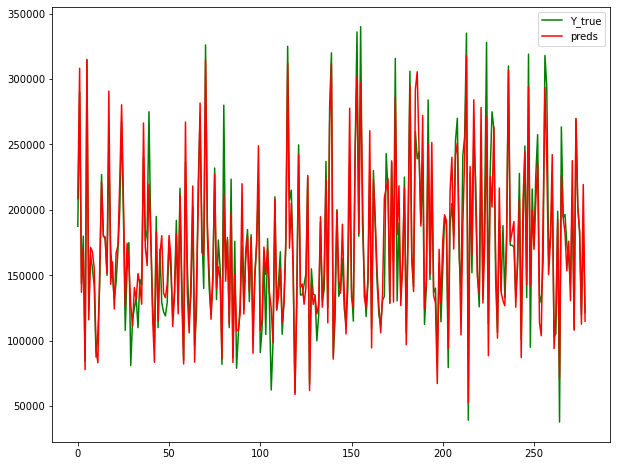

Fold = 0, RMSE = 20780.557237082718


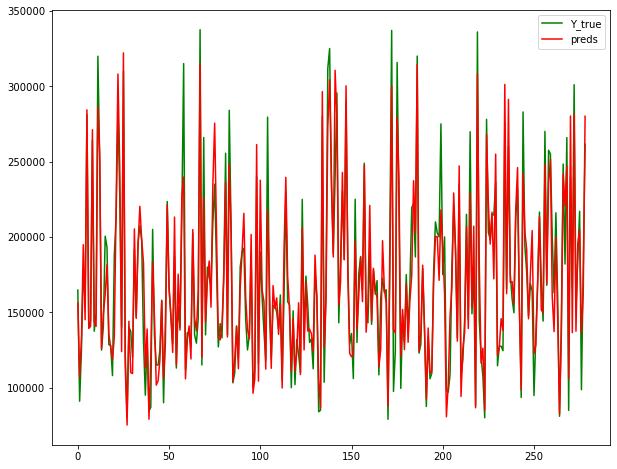

Fold = 1, RMSE = 19113.017975482708


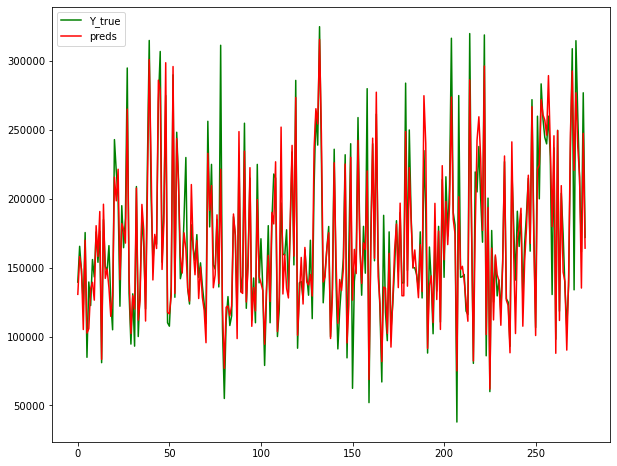

Fold = 2, RMSE = 19803.38211176039


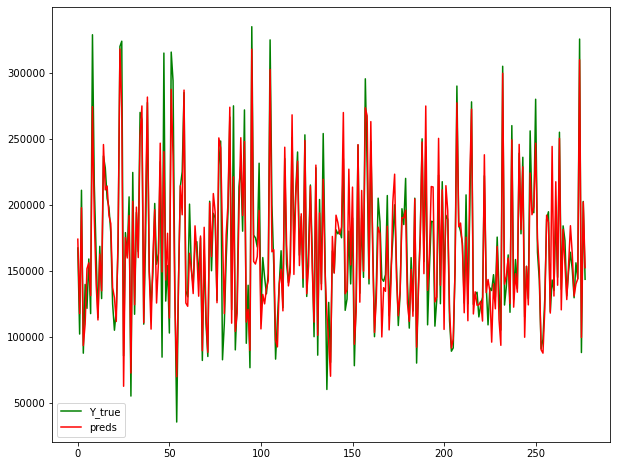

Fold = 3, RMSE = 19750.191383766756


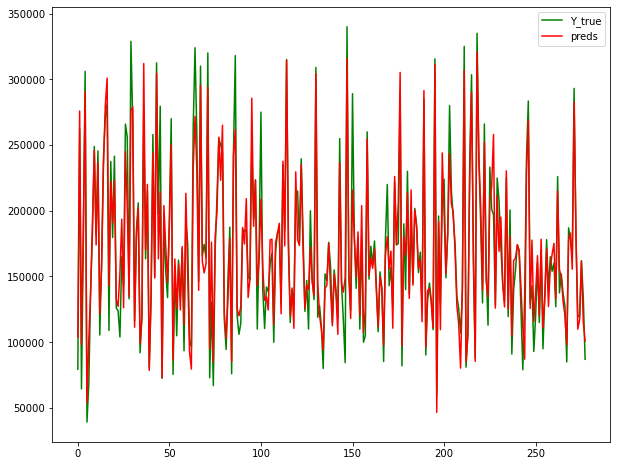

Fold = 4, RMSE = 18833.25190142789
mean_score =  19656.080121904095


In [114]:
# best score around 20000 pre clusters
RMSE_arr=[]
for i in np.arange(5):
    score= run(df=No_no_outlier4[sub1],target=target,model=et,fold=i,dropped=[],save_fold_csv=False)  ; RMSE_arr.append(score)
print('mean_score = ', np.mean(RMSE_arr))

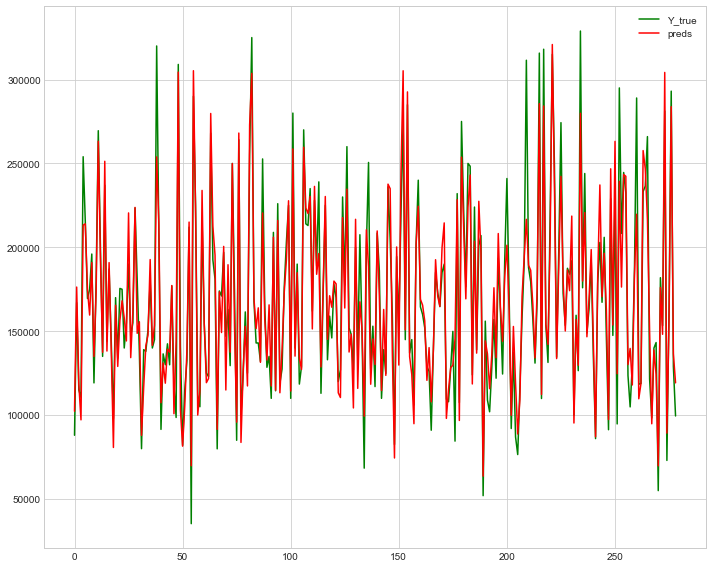

Fold = 0, RMSE = 18651.810139478683


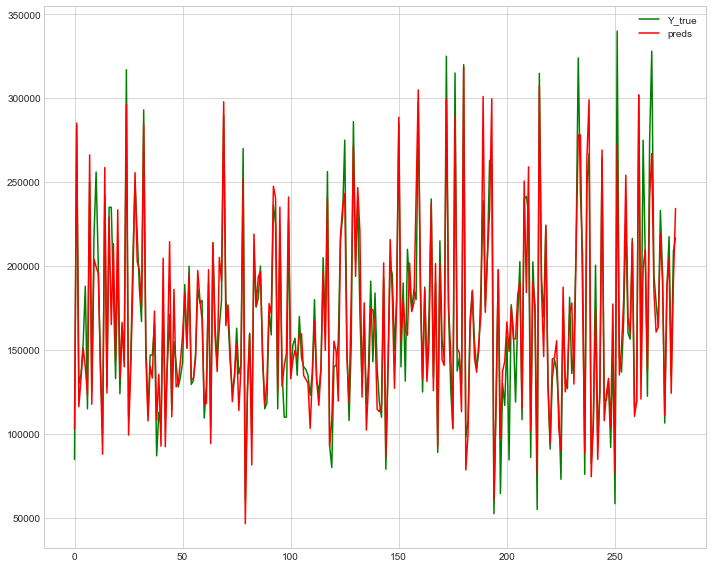

Fold = 1, RMSE = 19289.113045038255


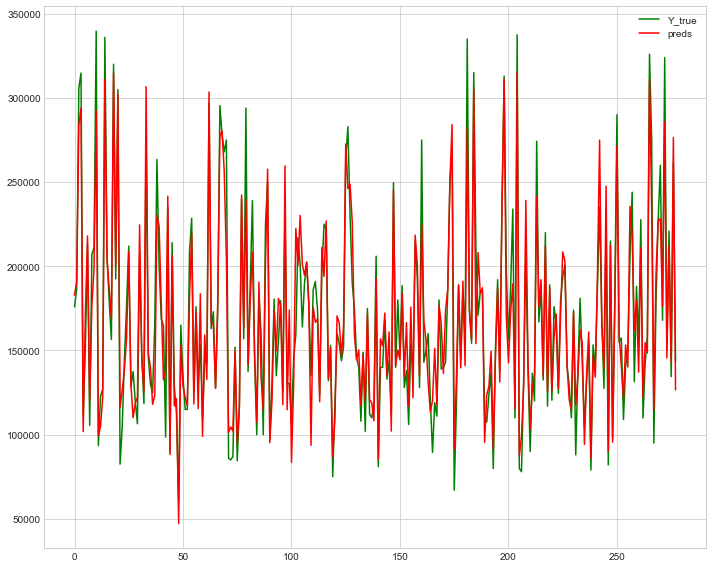

Fold = 2, RMSE = 18533.700694767926


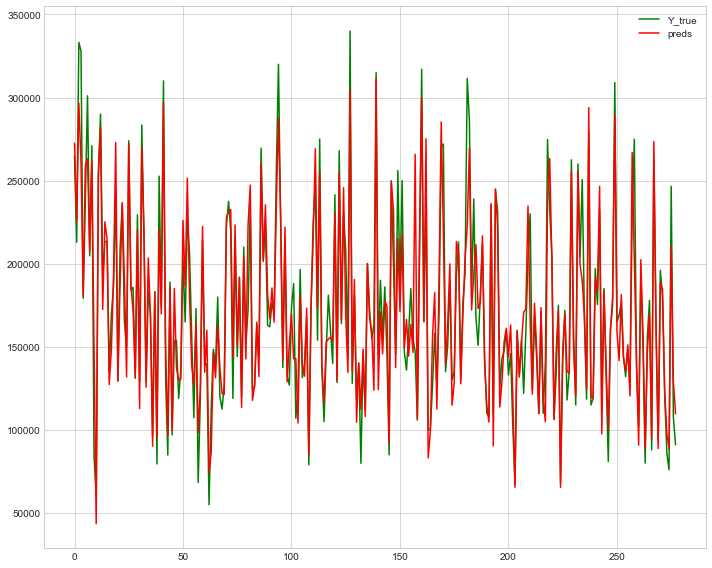

Fold = 3, RMSE = 20729.17292433373


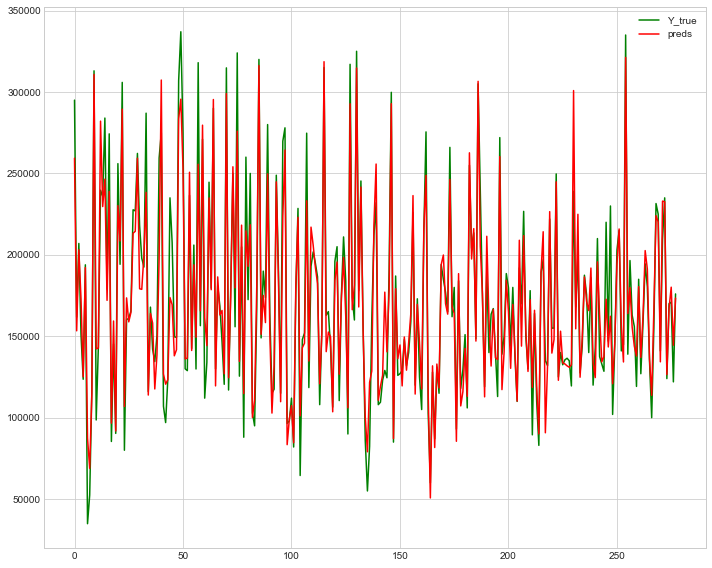

Fold = 4, RMSE = 18997.68809769835
mean_score =  19240.29698026339


In [152]:
# best score around 20000 pre clusters
keeps= [ 'indoor_Cluster', 'outdoor_Cluster','in_out_Cluster', 'All_Q_Cluster']
drops =  [  'Bmt_Ql_Cd_Cluster','Ext_Q_Cd_Cluster',
       'Bmt_F_A_Cluster', 'Gar_Q_Cd_Cluster', ]
RMSE_arr=[]
for i in np.arange(5):
    score= run(df=No_no_outlier4[sub1],target=target,model=et,fold=i,dropped=keeps,save_fold_csv=False)  ; RMSE_arr.append(score)
print('mean_score = ', np.mean(RMSE_arr))

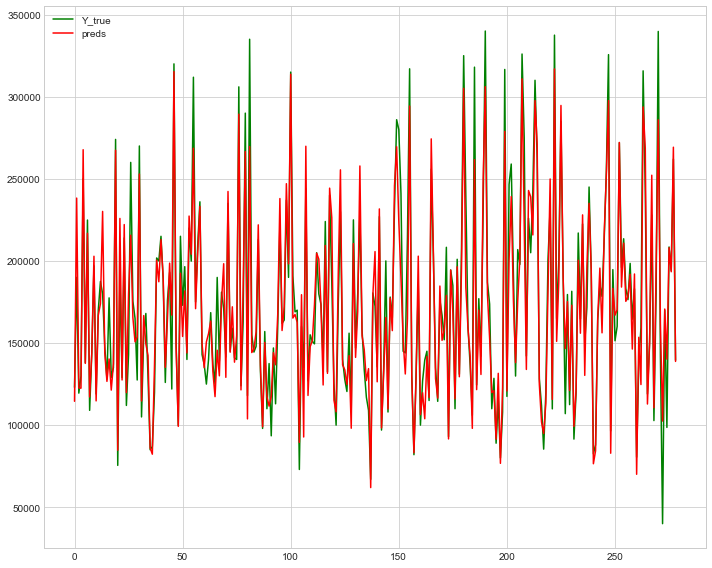

Fold = 0, RMSE = 18933.03299484867


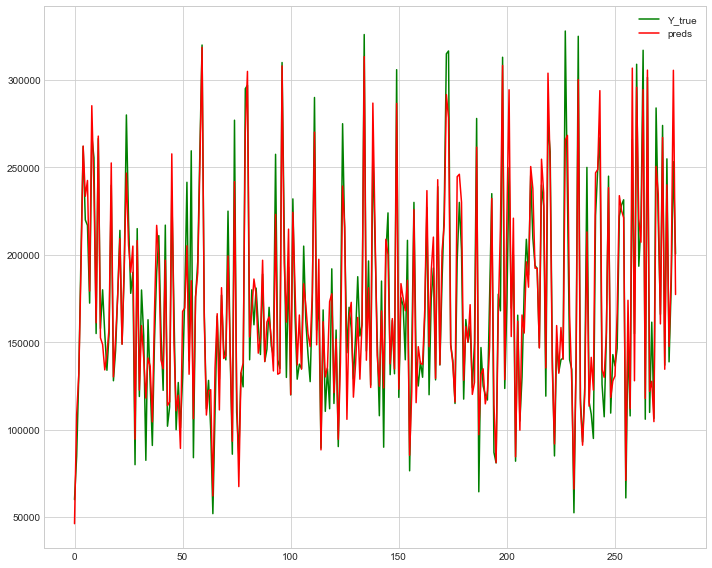

Fold = 1, RMSE = 18752.22950283435


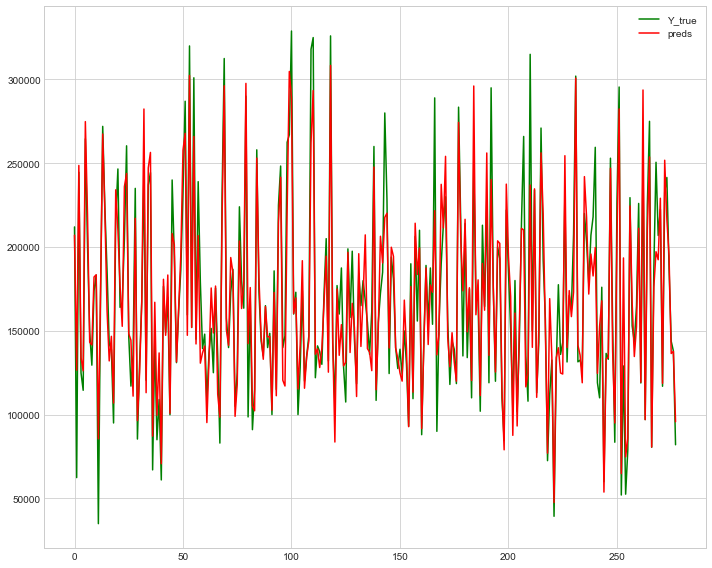

Fold = 2, RMSE = 20753.02767369301


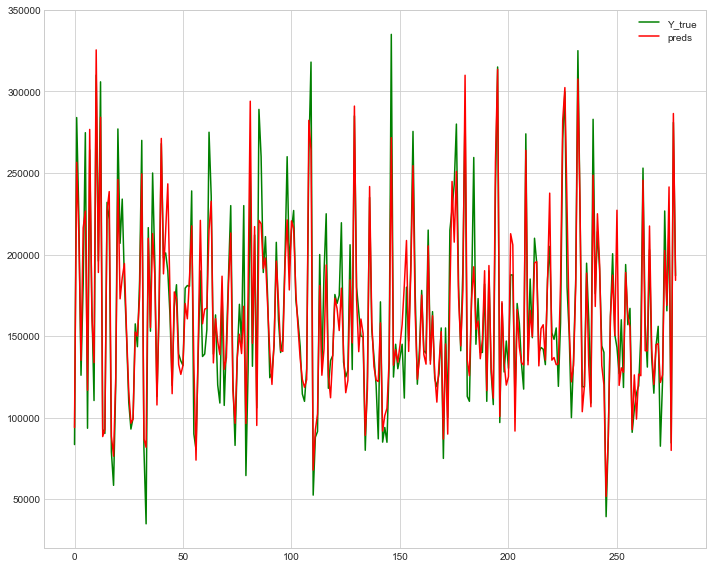

Fold = 3, RMSE = 20127.654395439433


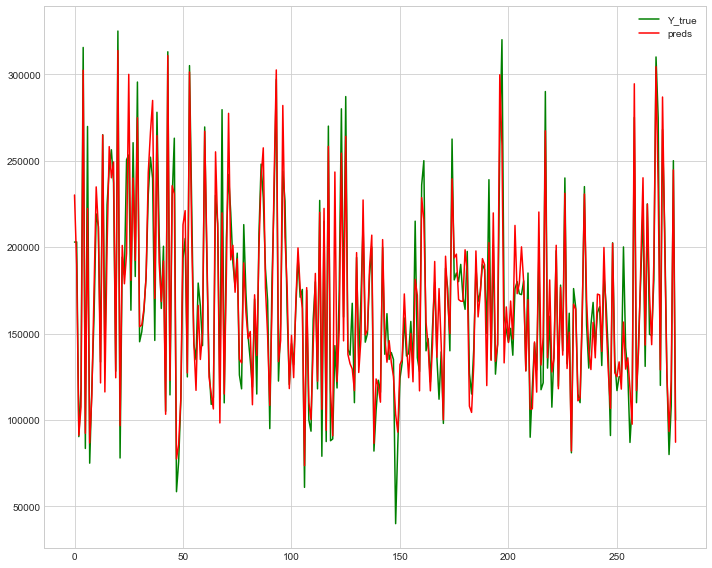

Fold = 4, RMSE = 18479.49051316279
mean_score =  19409.08701599565


In [153]:
# best score around 20000 pre clusters
keeps= [ 'indoor_Cluster', 'outdoor_Cluster','in_out_Cluster', 'All_Q_Cluster']
drops =  [  'Bmt_Ql_Cd_Cluster','Ext_Q_Cd_Cluster',
       'Bmt_F_A_Cluster', 'Gar_Q_Cd_Cluster', ]
RMSE_arr=[]
for i in np.arange(5):
    score= run(df=No_no_outlier4[sub1],target=target,model=et,fold=i,dropped=drops,save_fold_csv=False)  ; RMSE_arr.append(score)
print('mean_score = ', np.mean(RMSE_arr))

#### 4 clusters
sub1=19656
dropped_drops=  19409 
dropped_keeps=  19240.29

Cluster columns =  indoor_Cluster


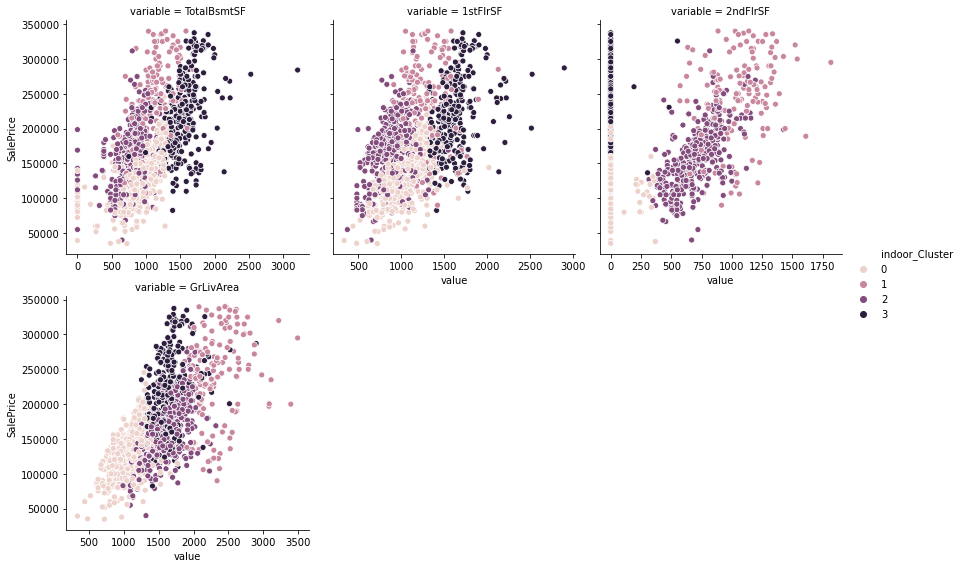

Cluster columns =  outdoor_Cluster


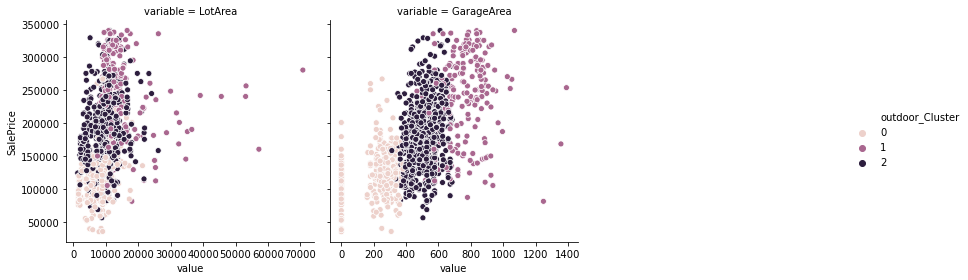

Cluster columns =  in_out_Cluster


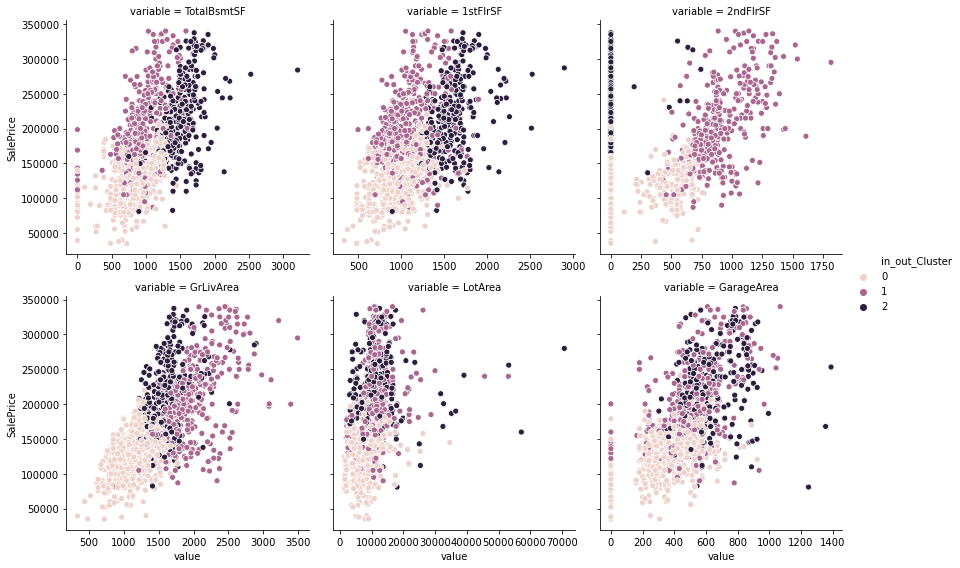

Cluster columns =  Ext_Q_Cd_Cluster


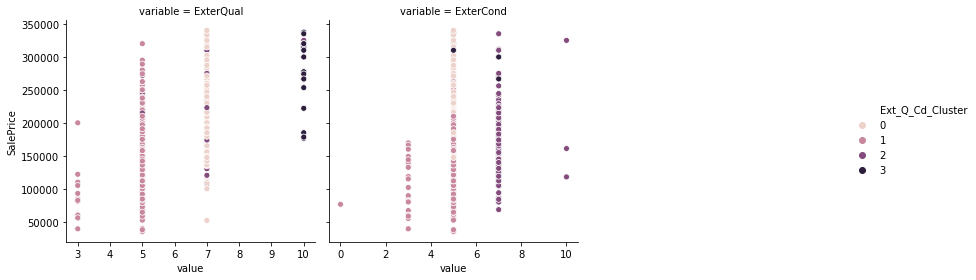

Cluster columns =  Bmt_Ql_Cd_Cluster


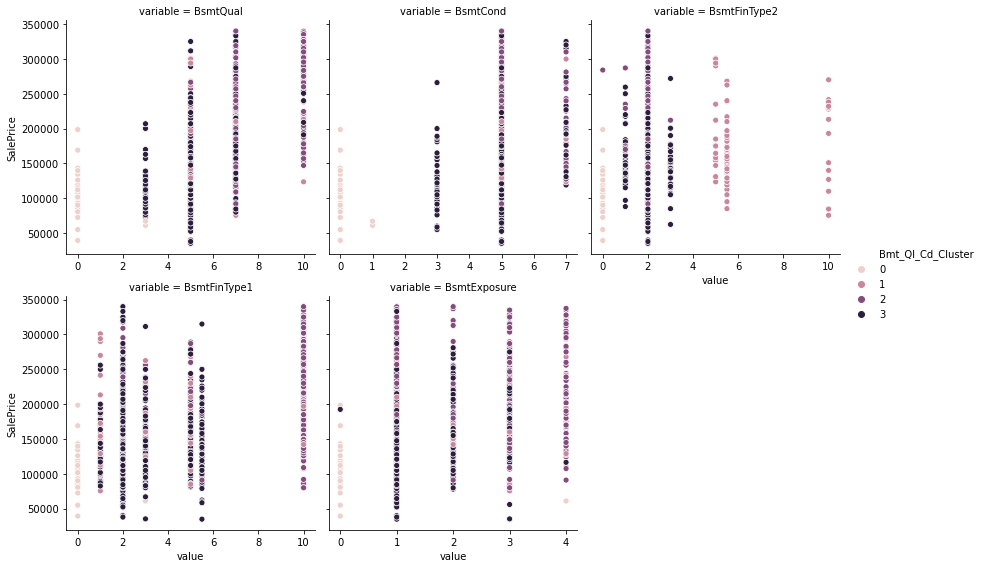

Cluster columns =  Bmt_F_A_Cluster


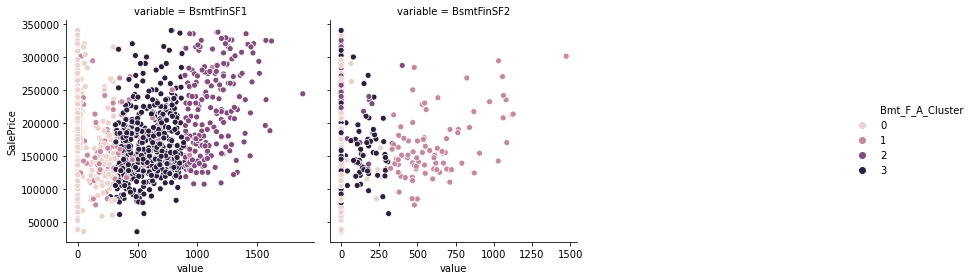

Cluster columns =  Gar_Q_Cd_Cluster


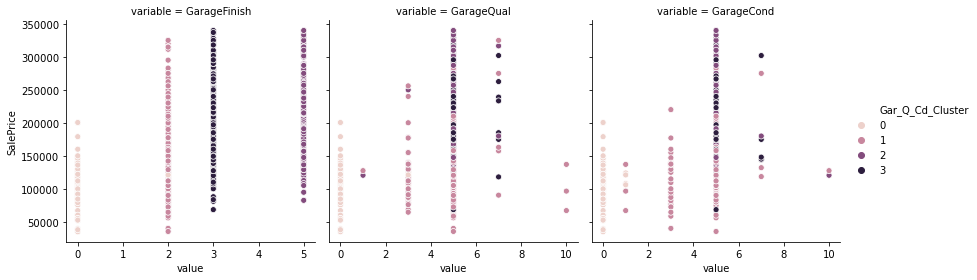

Cluster columns =  All_Q_Cluster


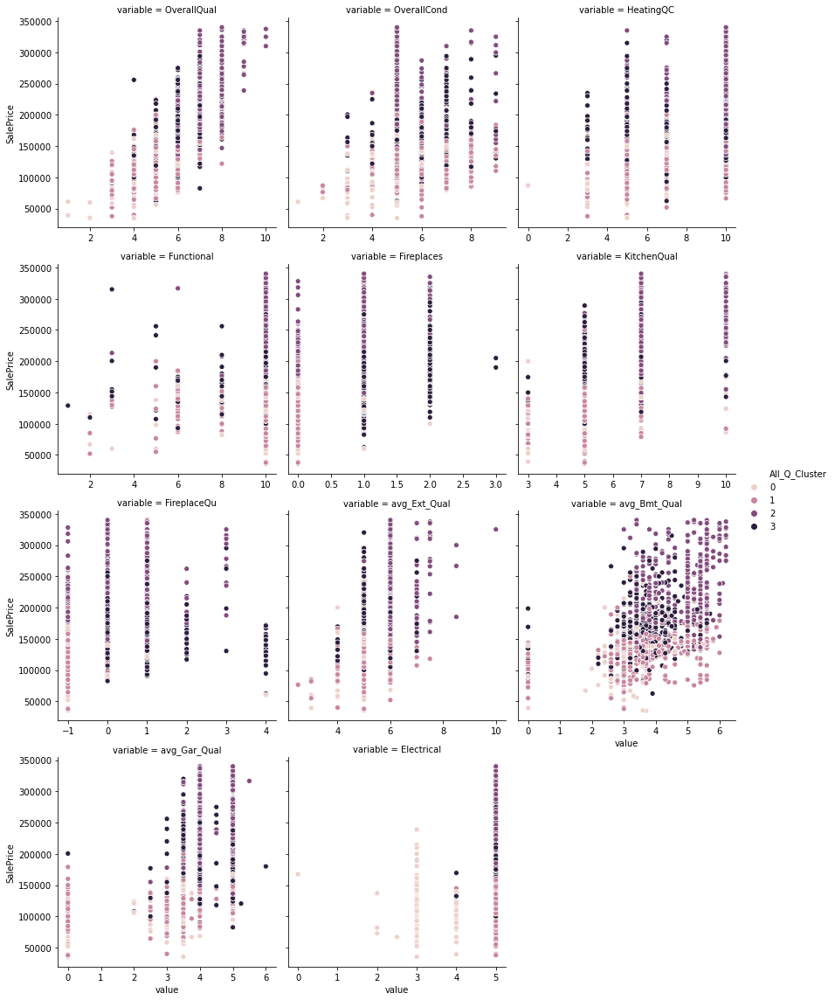

In [113]:
plot_clusters(No_no_outlier4,target,group_name_list,cluster_col_list)

### from mi_score ..imma drop the clusters with lower scores

In [117]:
scoremxLE.index.to_list()

['total_indoor_sqft',
 'OverallQual',
 'total_All_Qualities',
 'avg_All_Qualities',
 'All_Q_Cluster',
 'indoor_Cluster',
 'in_out_Cluster',
 'Neighborhood',
 'GrLivArea',
 'YearBuilt_Age',
 'TotalBsmtSF',
 'GarageCars',
 'YearBuilt',
 'GarageArea',
 'ExterQual',
 'YrSd_YrBlt',
 'outdoor_Cluster',
 'avg_Bmt_Qual',
 'KitchenQual',
 'BsmtQual',
 'Ext_Q_Cd_Cluster',
 'total_Bmt_Ql_Cd',
 '1stFlrSF',
 'Bmt_Ql_Cd_Cluster',
 'total_in_out_sqft',
 'no_finishes',
 'Gar_Q_Cd_Cluster',
 'avg_Gar_Qual',
 'total_Garage_Ql_Cd',
 'YrSd_YrRmd',
 'MSSubClass',
 'GarageFinish',
 'FullBath',
 'GarageYrBlt',
 'Spaciousness',
 'total_Ext_Ql_Cd',
 'YearRemodAdd_Age',
 'avg_Ext_Qual',
 'YearRemodAdd',
 'Garage_per_Car_Cap',
 'Foundation_MasVnrType',
 'FireplaceQu',
 'LotFrontage',
 'TotRmsAbvGrd',
 '2ndFlrSF',
 'GarageType',
 'Foundation',
 'total_outdoor_sqft',
 'Fireplaces',
 'LotArea',
 'Exterior2nd',
 'total_Bmt_Fn_Area',
 'BsmtFinSF1',
 'HeatingQC',
 'Bmt_F_A_Cluster',
 'BsmtFinType1',
 'Exterior1st_Exte

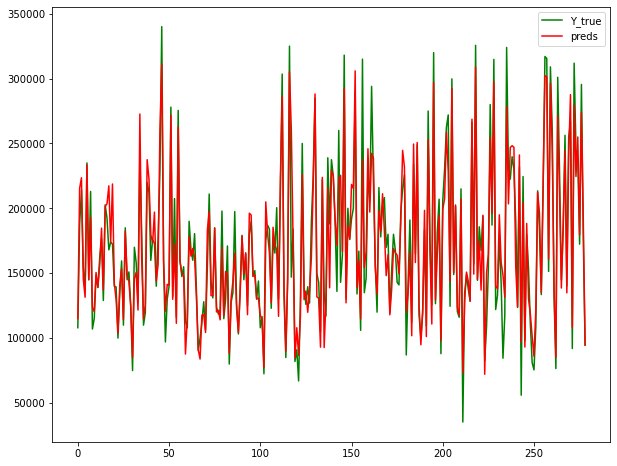

Fold = 0, RMSE = 19458.361039672647


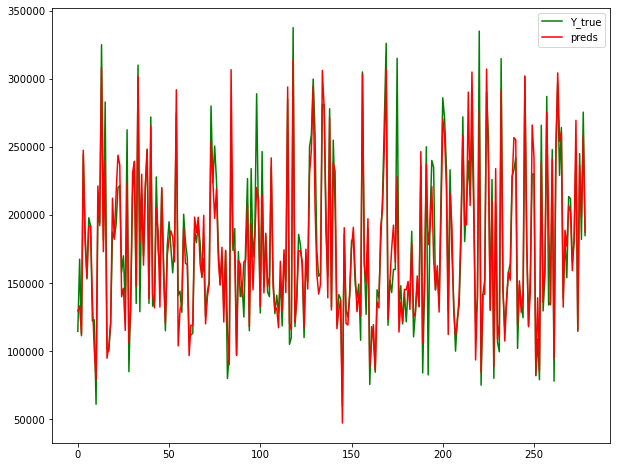

Fold = 1, RMSE = 19241.3848584798


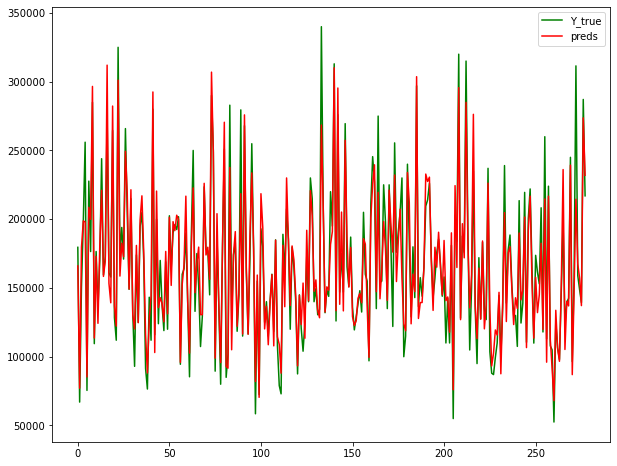

Fold = 2, RMSE = 18469.38123998623


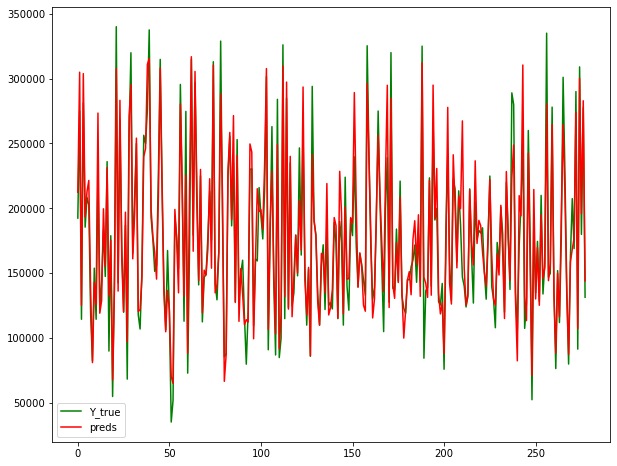

Fold = 3, RMSE = 20237.375892753313


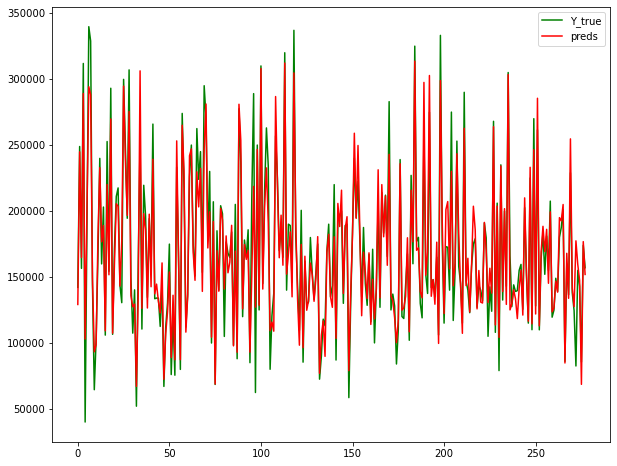

Fold = 4, RMSE = 18612.58911176171
mean_score =  19203.818428530743


In [126]:
# best score around 20000 pre clusters
keeps= [ 'indoor_Cluster', 'outdoor_Cluster','in_out_Cluster', 'All_Q_Cluster']
drops =  [ 'Ext_Q_Cd_Cluster', 'Bmt_Ql_Cd_Cluster',
       'Bmt_F_A_Cluster', 'Gar_Q_Cd_Cluster']
RMSE_arr=[]
for i in np.arange(5):
    score= run(df=No_no_outlier4[sub1],target=target,model=et,fold=i,dropped=keeps,save_fold_csv=False)  ; RMSE_arr.append(score)
print('mean_score = ', np.mean(RMSE_arr))

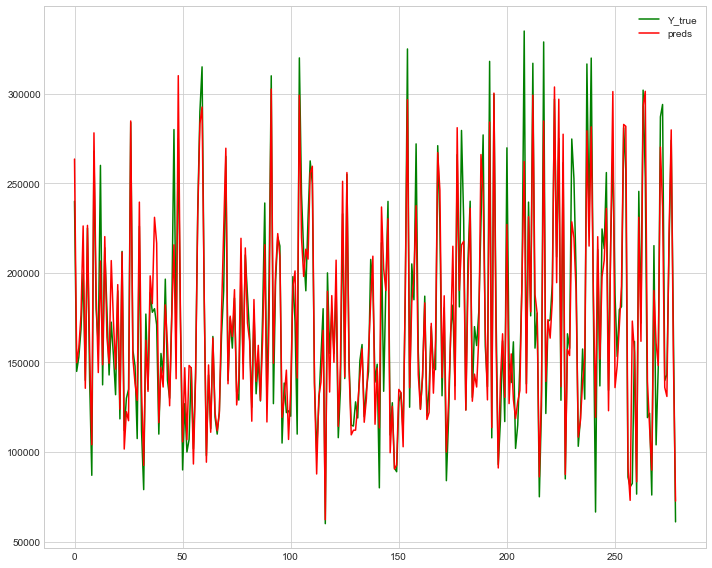

Fold = 0, RMSE = 20000.077300136625


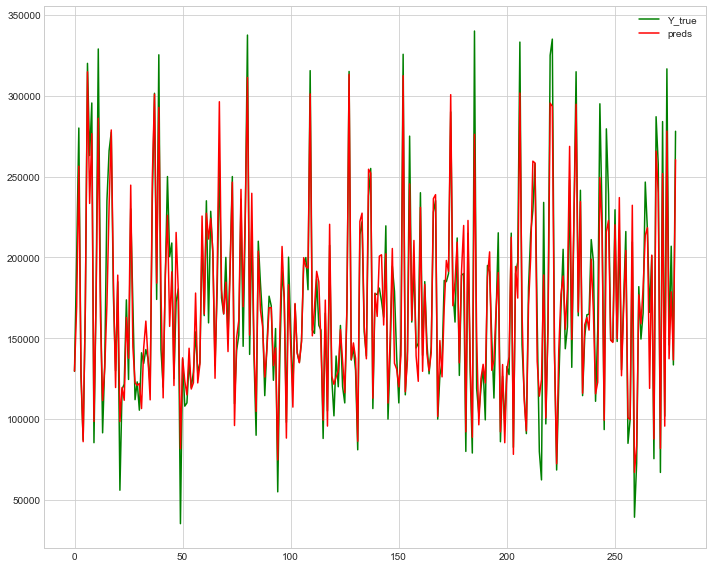

Fold = 1, RMSE = 18248.528692371357


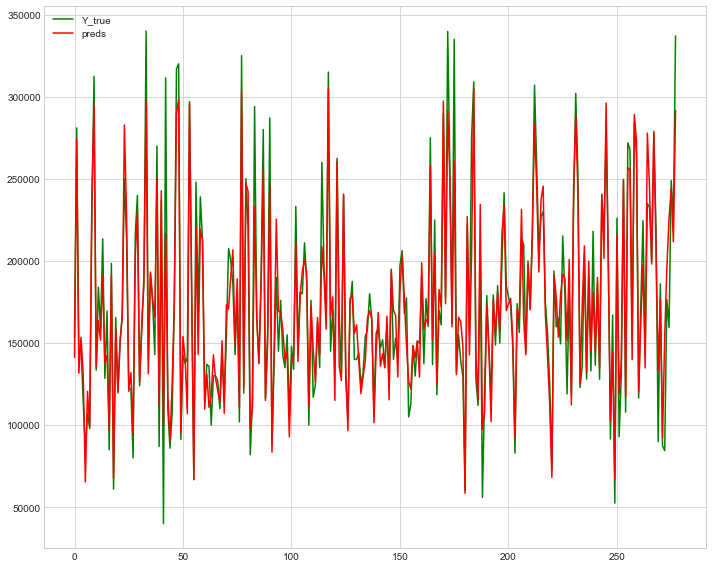

Fold = 2, RMSE = 19338.293071719727


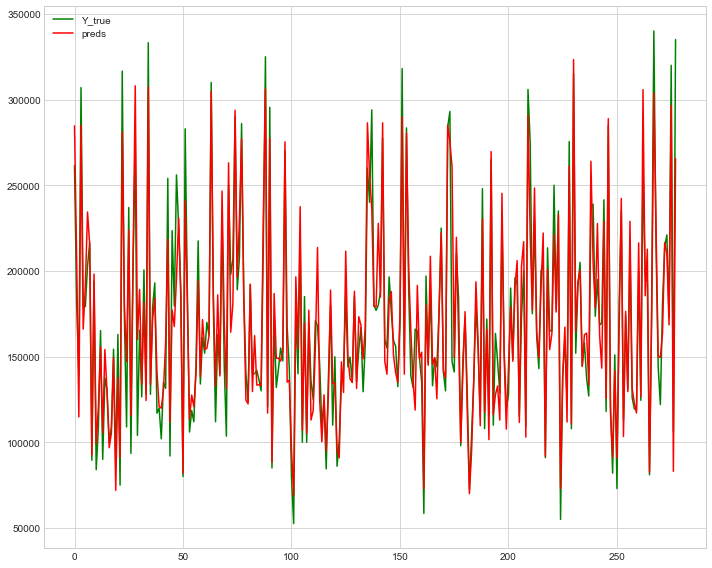

Fold = 3, RMSE = 19103.556092553277


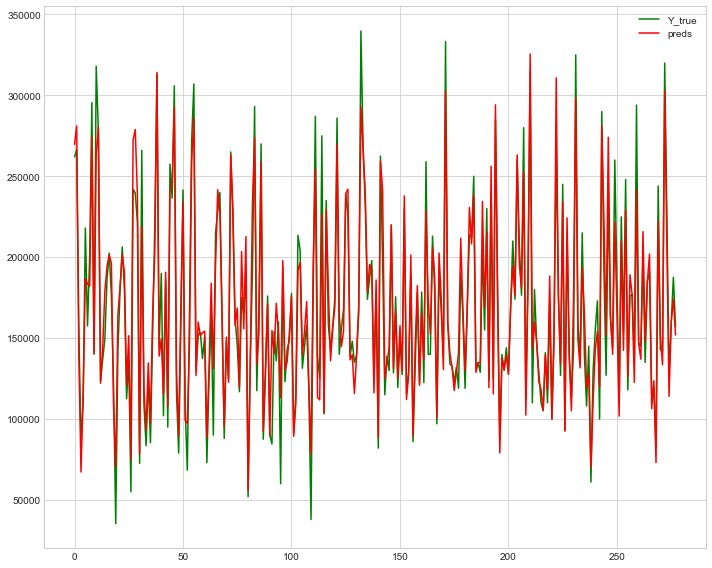

Fold = 4, RMSE = 17275.261893379582
mean_score =  18793.143410032113


In [132]:
# best score around 20000 pre clusters
keeps= [ 'indoor_Cluster', 'outdoor_Cluster','in_out_Cluster', 'All_Q_Cluster']
drops =  [  'Bmt_Ql_Cd_Cluster','Ext_Q_Cd_Cluster',
       'Bmt_F_A_Cluster', 'Gar_Q_Cd_Cluster', ]
RMSE_arr=[]
for i in np.arange(5):
    score= run(df=No_no_outlier[sub1],target=target,model=et,fold=i,dropped=keeps,save_fold_csv=False)  ; RMSE_arr.append(score)
print('mean_score = ', np.mean(RMSE_arr))

## n_clusters=3 from elbow plot

In [134]:
#n=3
klusters3 =  make_clusters(df=LE_df,target=target,features_list=cluster_features,cluster_name_list=cluster_alias,
                           n_clusters=3)

train_df3 = klusters3.loc[klusters3.SalePrice!='test_col'].reset_index(drop=True)
test_df3 = klusters3.loc[klusters3.SalePrice =='test_col'].reset_index(drop=True)
train_df3.SalePrice = train_df3.SalePrice.apply(int)

scoremxLE3 = make_mi_scores_Regression(X_train=train_df3.drop(['Id','SalePrice','area_per_finishes'],axis=1), y_train=train_df3.SalePrice)

no_outlier3 = Calculate_IQR(df=train_df3,col='SalePrice',get_new_df=True)
No_no_outlier3 = get_no_outlier(df_in=no_outlier3)

DESC
count      1460.000000
mean     180921.195890
std       79442.502883
min       34900.000000
25%      129975.000000
50%      163000.000000
75%      214000.000000
max      755000.000000
Name: SalePrice, dtype: float64
 
lower_limit =  3937.5    ||    upper_limit =  340037.5
Counts == ; lower_limit =  0    ||    upper_limit =  61
 
Number of possible Outliers =  61
Outliers : 
head  :  11    345000
53    385000
58    438780
Name: SalePrice, dtype: int64
tail  :  1373    466500
1388    377500
1437    394617
Name: SalePrice, dtype: int64


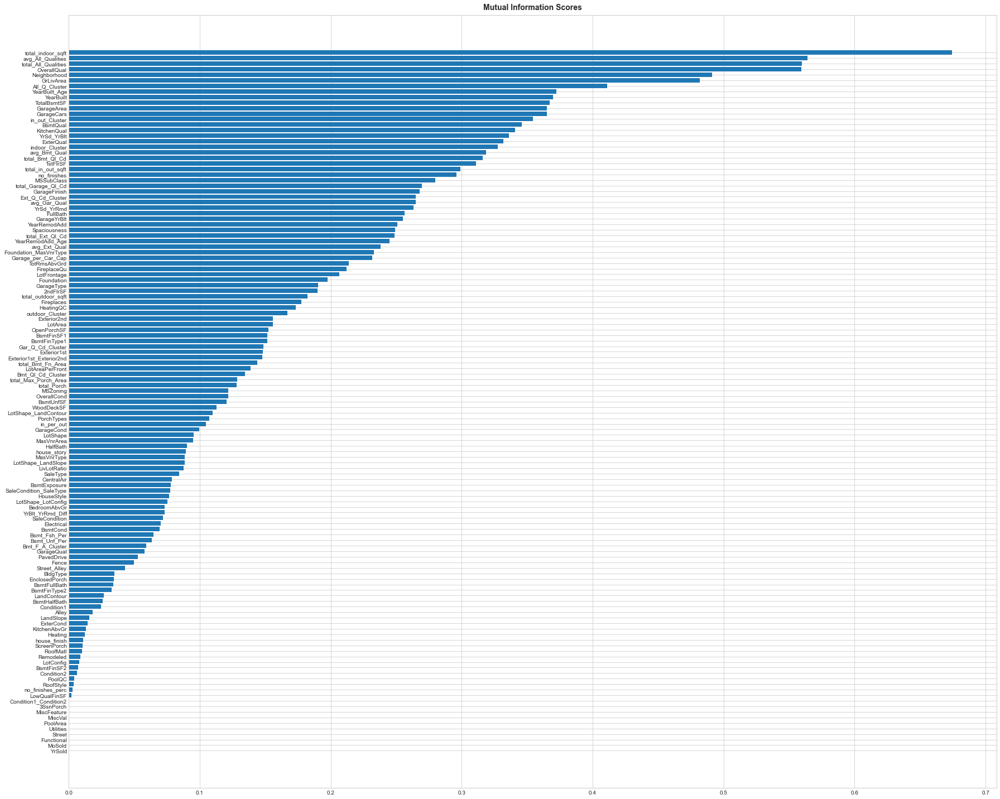

In [135]:
plot_mi_scores(scoremxLE3)

Cluster columns =  indoor_Cluster


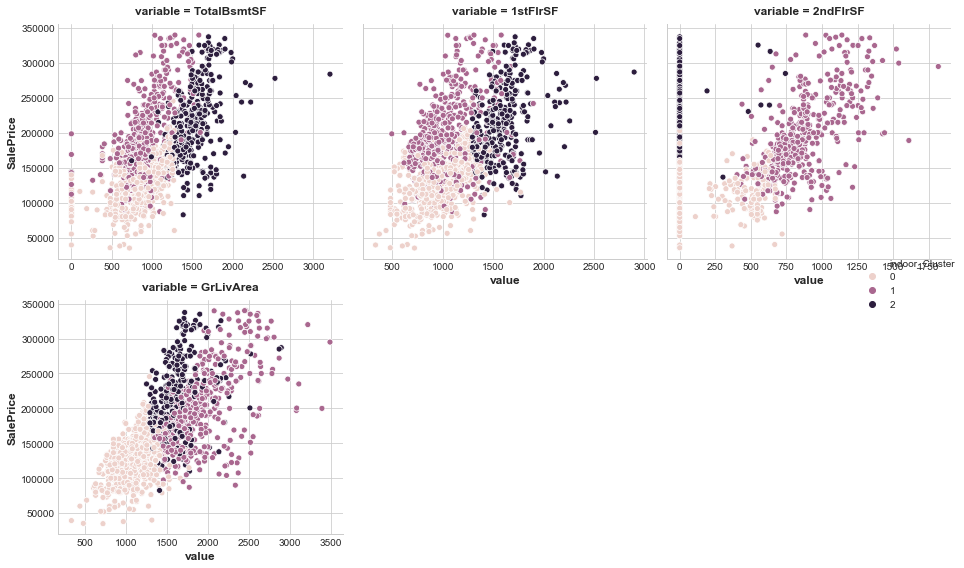

Cluster columns =  outdoor_Cluster


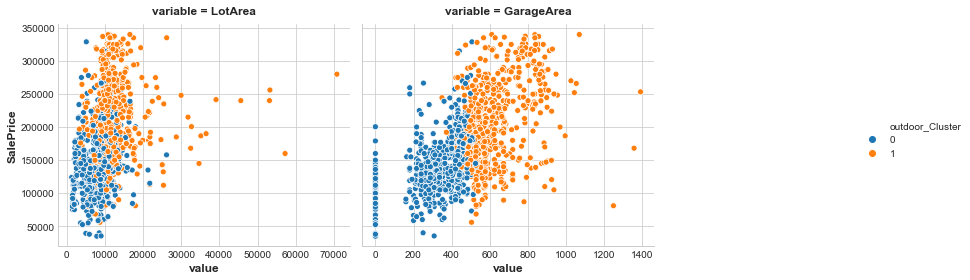

Cluster columns =  in_out_Cluster


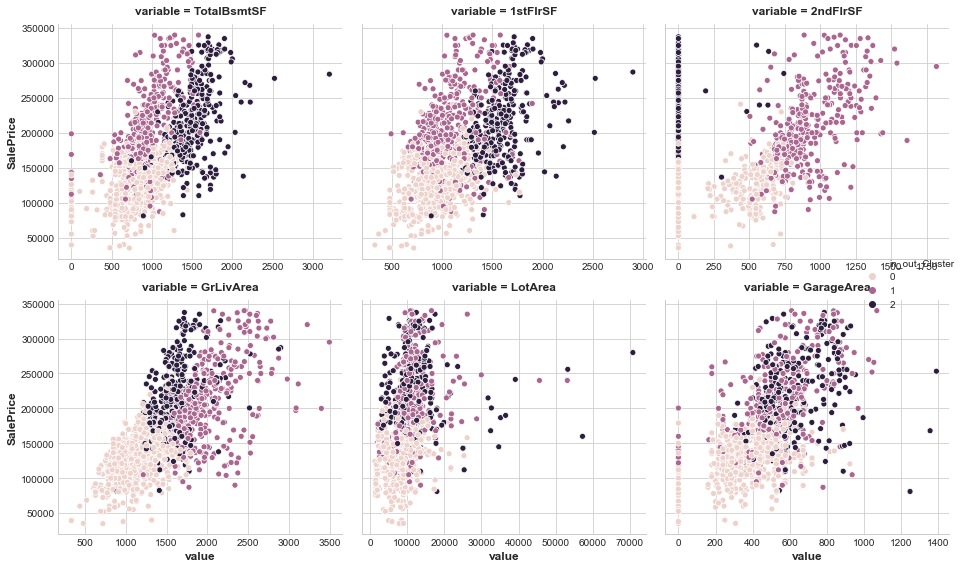

Cluster columns =  Ext_Q_Cd_Cluster


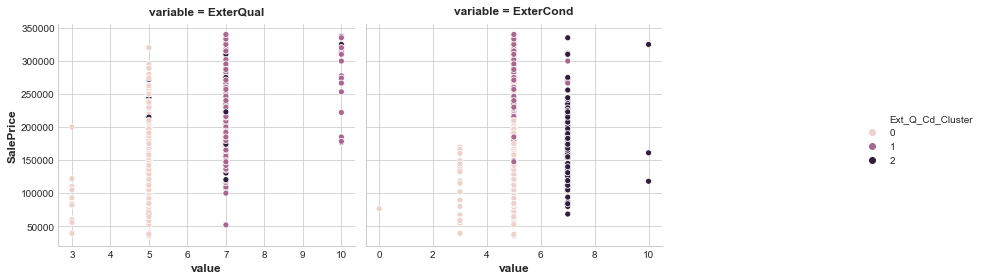

Cluster columns =  Bmt_Ql_Cd_Cluster


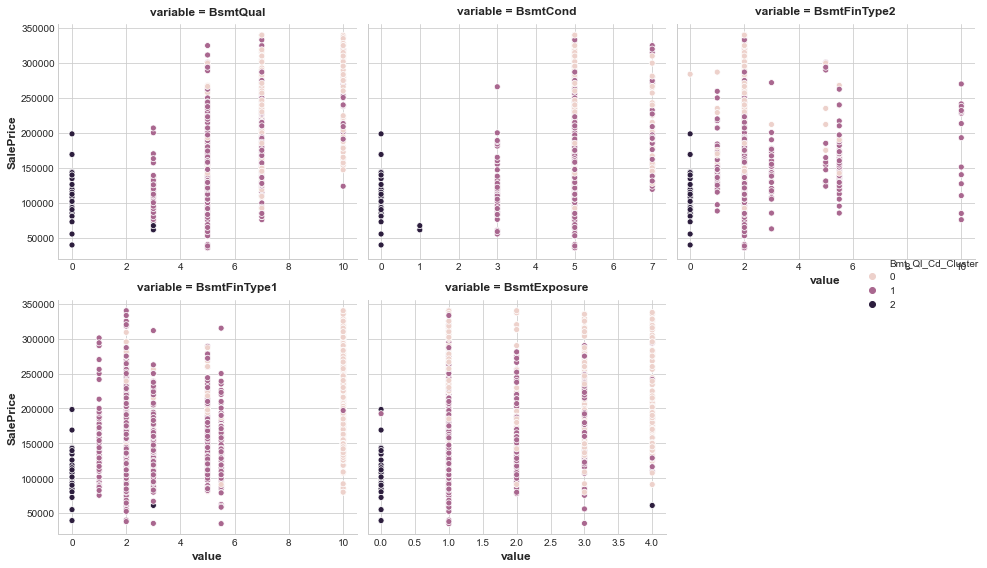

Cluster columns =  Bmt_F_A_Cluster


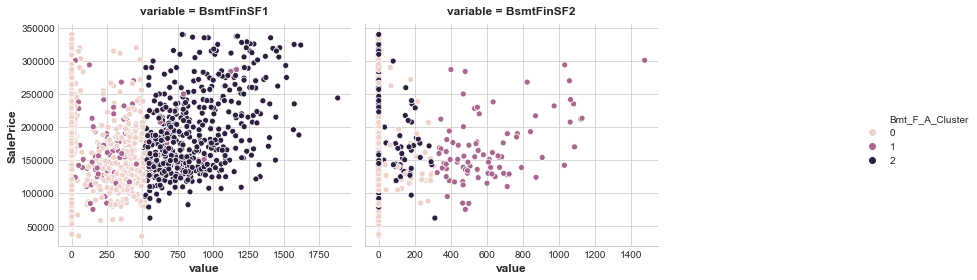

Cluster columns =  Gar_Q_Cd_Cluster


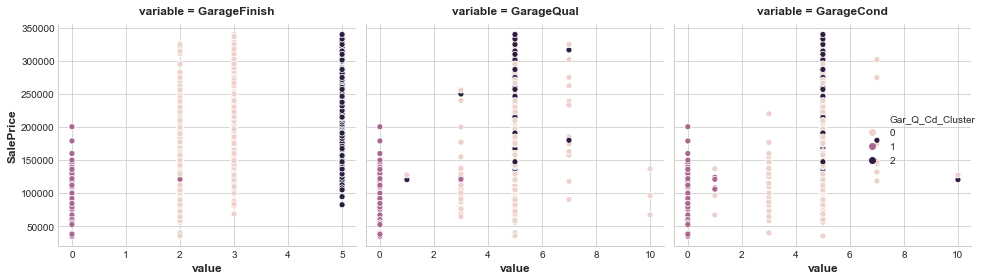

Cluster columns =  All_Q_Cluster


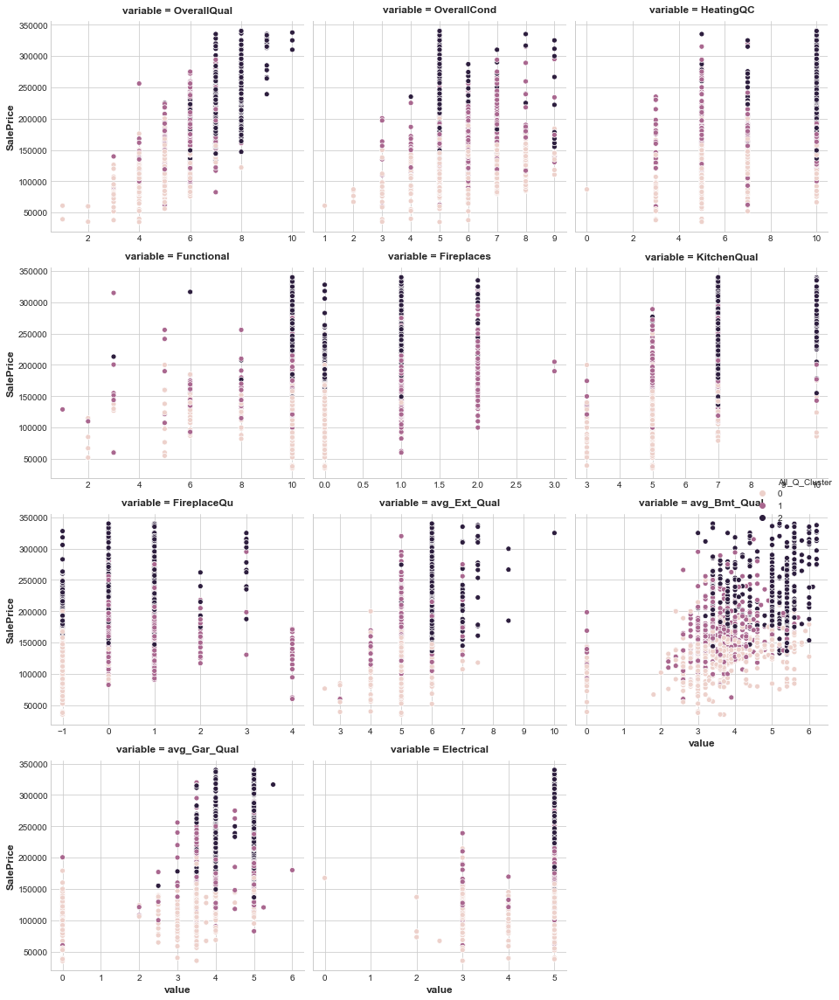

In [136]:
plot_clusters(No_no_outlier3,target,group_name_list,cluster_col_list)

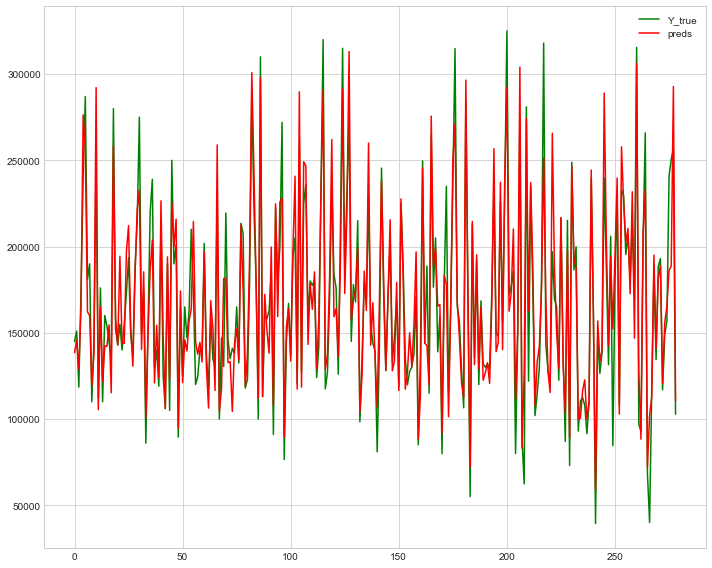

Fold = 0, RMSE = 20002.082958868727


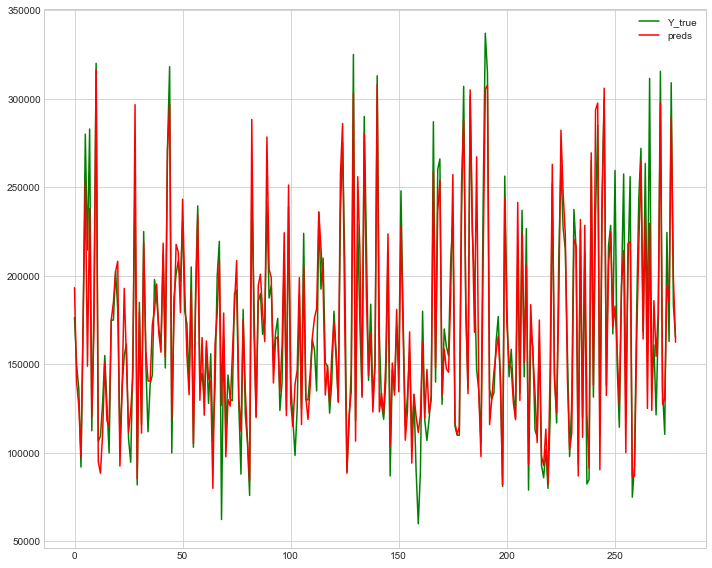

Fold = 1, RMSE = 20498.480319518578


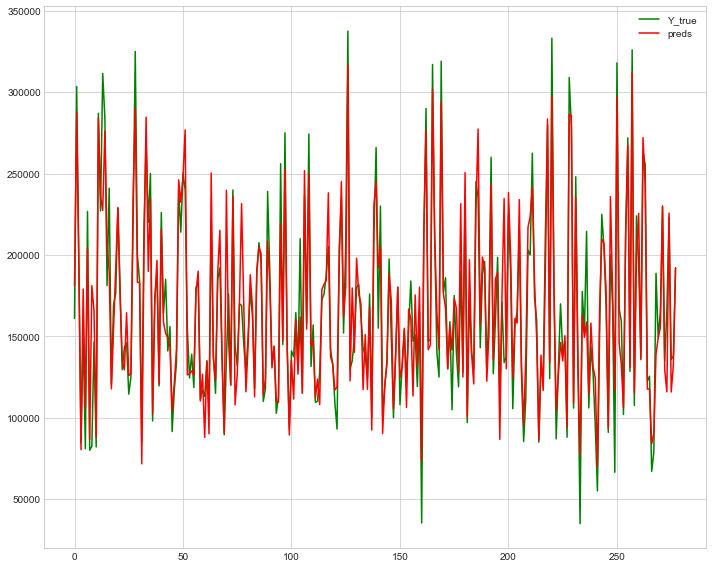

Fold = 2, RMSE = 21224.24805419803


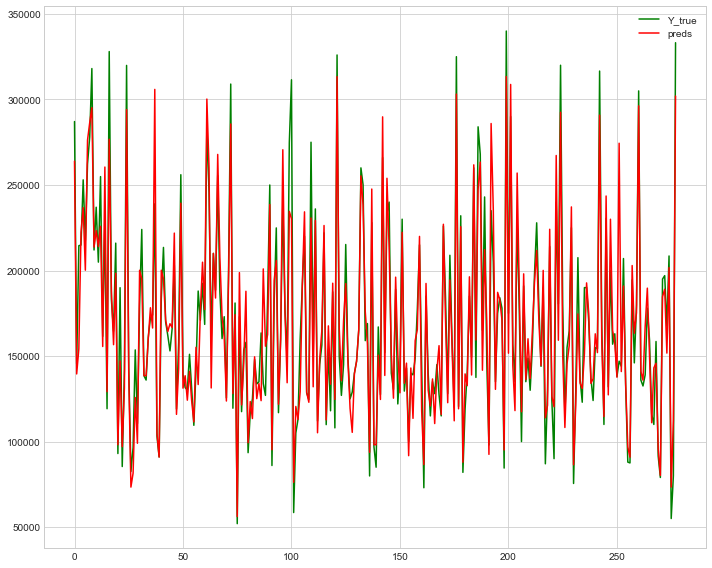

Fold = 3, RMSE = 19854.55337484337


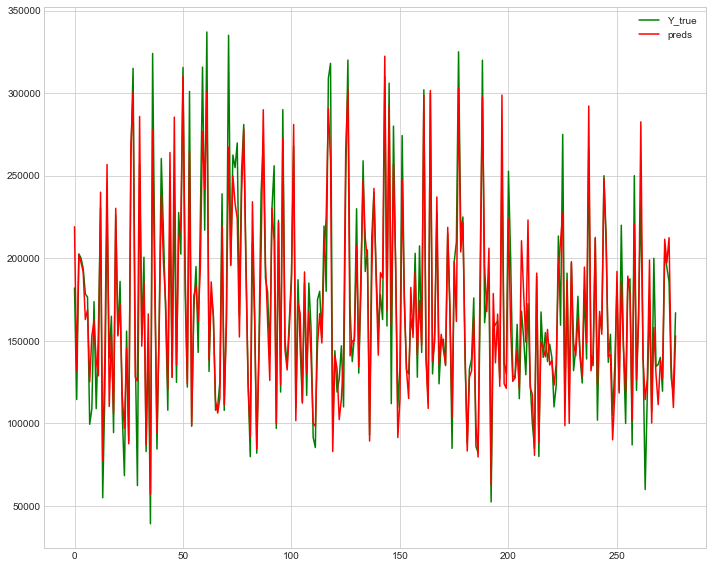

Fold = 4, RMSE = 19740.34250221388
mean_score =  20263.941441928517


In [147]:
# best score around 20000 pre clusters
RMSE_arr=[]
for i in np.arange(5):
    score= run(df=No_no_outlier3
               [sub1],target=target,model=et,fold=i,dropped=[],save_fold_csv=False)  ; RMSE_arr.append(score)
print('mean_score = ', np.mean(RMSE_arr))

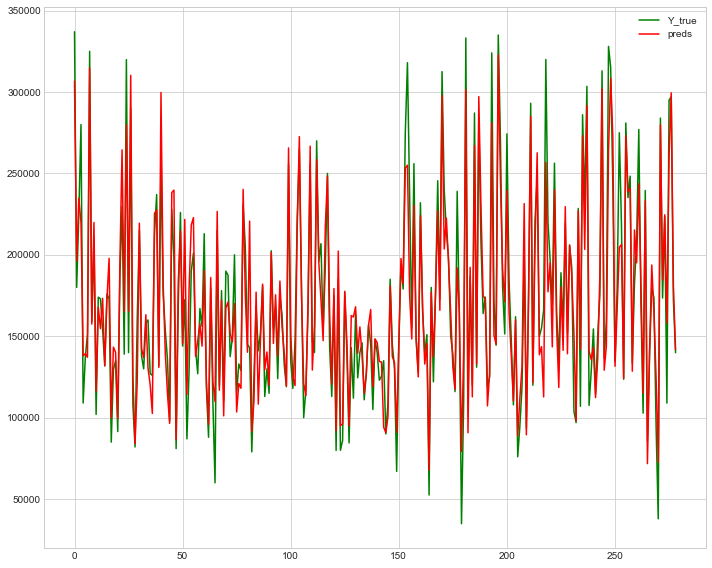

Fold = 0, RMSE = 20788.674831920205


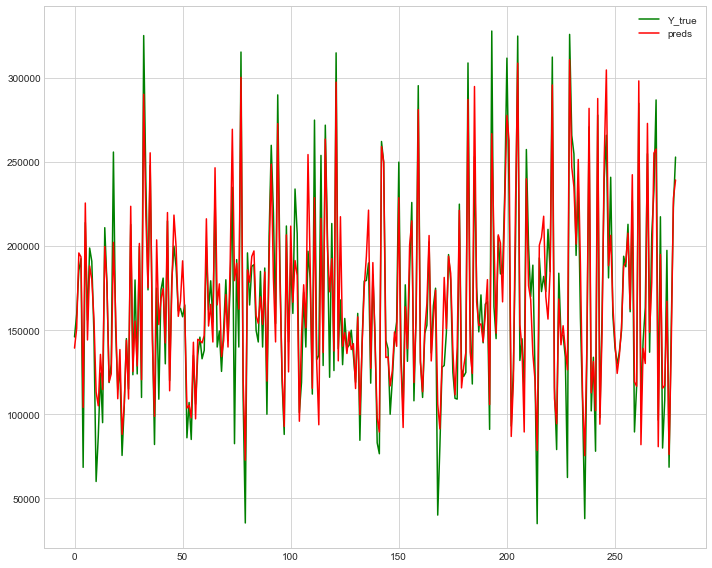

Fold = 1, RMSE = 20387.595859824356


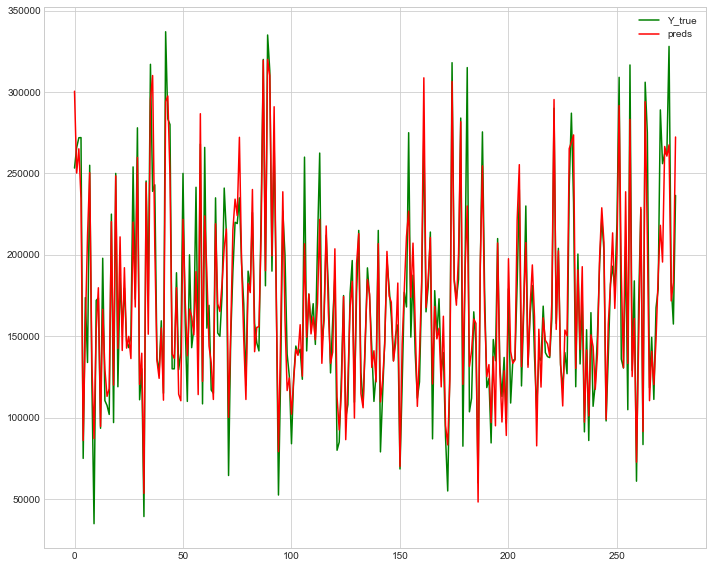

Fold = 2, RMSE = 21808.99303430212


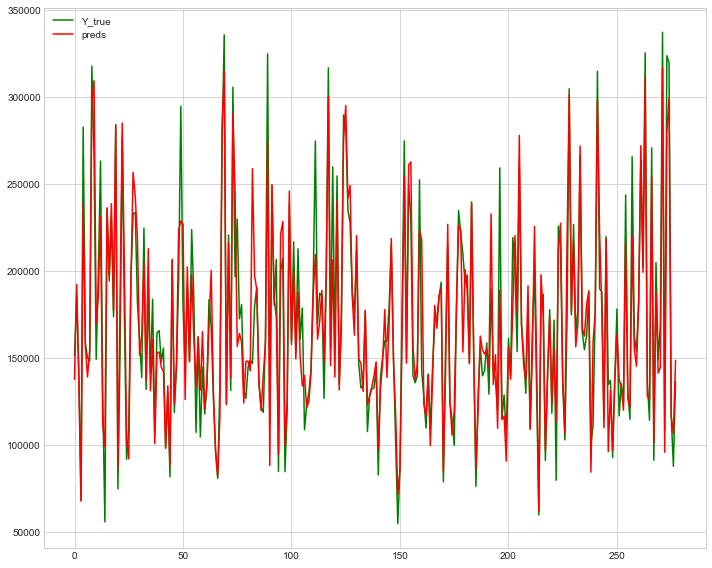

Fold = 3, RMSE = 20633.2974526988


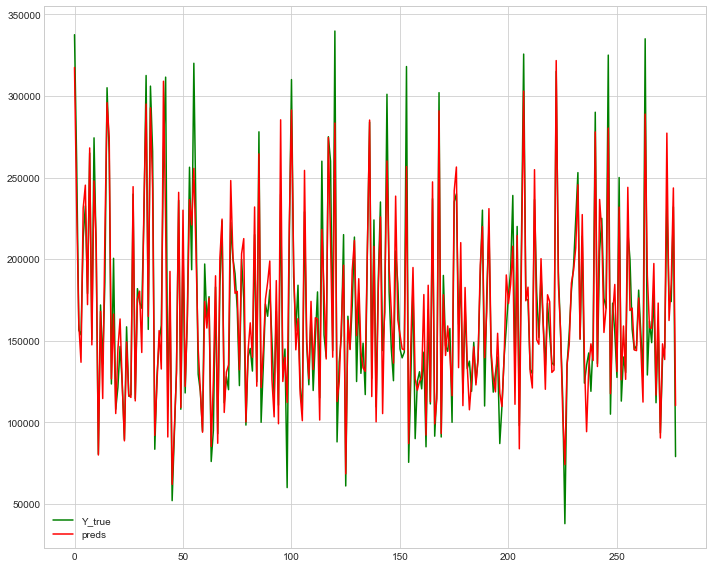

Fold = 4, RMSE = 19102.12352059474
mean_score =  20544.136939868047


In [150]:
# best score around 20000 pre clusters
keeps= [ 'indoor_Cluster', 'outdoor_Cluster','in_out_Cluster', 'All_Q_Cluster']
drops =  [  'Bmt_Ql_Cd_Cluster','Ext_Q_Cd_Cluster',
       'Bmt_F_A_Cluster', 'Gar_Q_Cd_Cluster', ]
RMSE_arr=[]
for i in np.arange(5):
    score= run(df=No_no_outlier3[sub1],target=target,model=et,fold=i,dropped=keeps,save_fold_csv=False)  ; RMSE_arr.append(score)
print('mean_score = ', np.mean(RMSE_arr))

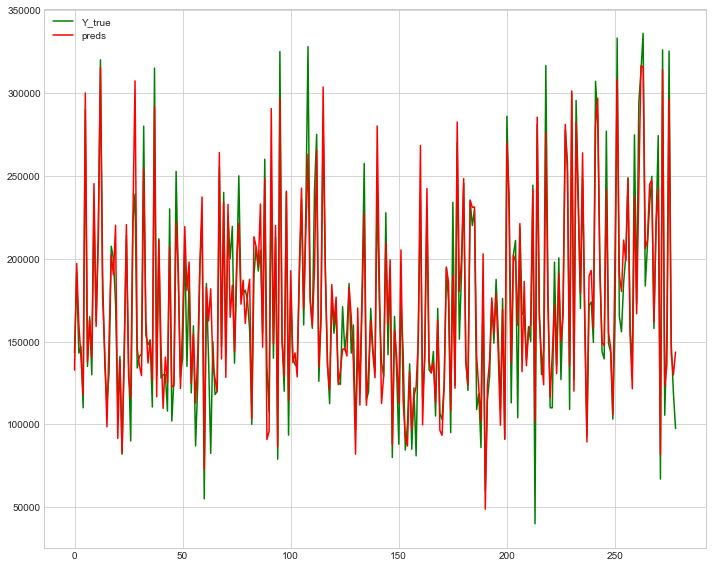

Fold = 0, RMSE = 19329.67994879749


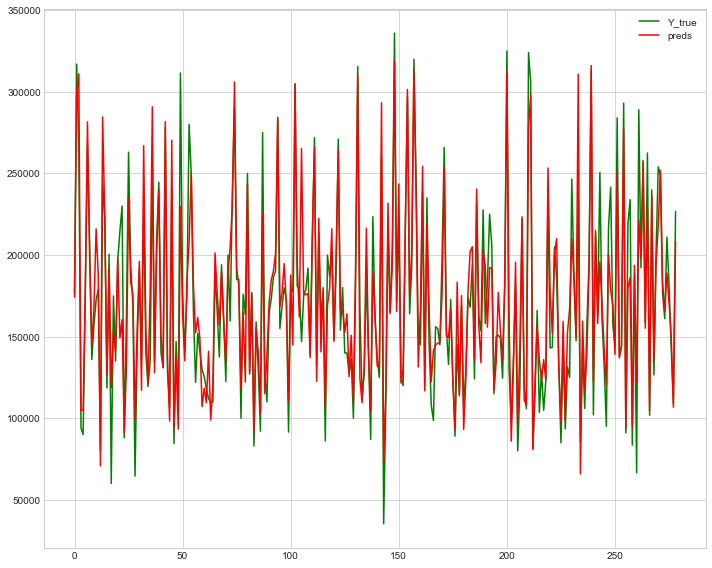

Fold = 1, RMSE = 22576.069596785164


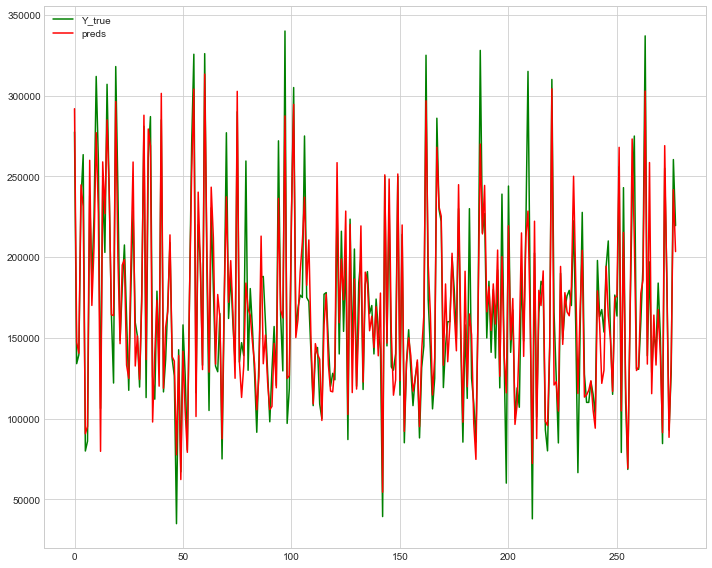

Fold = 2, RMSE = 21250.269534039362


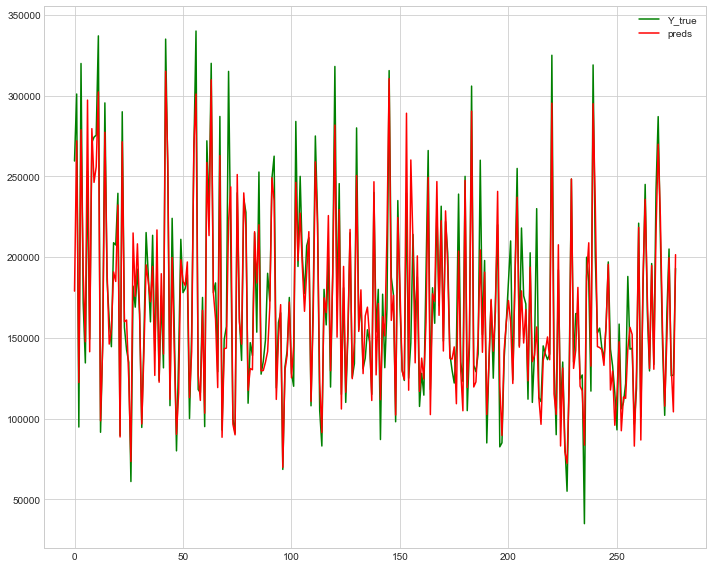

Fold = 3, RMSE = 20191.511724655684


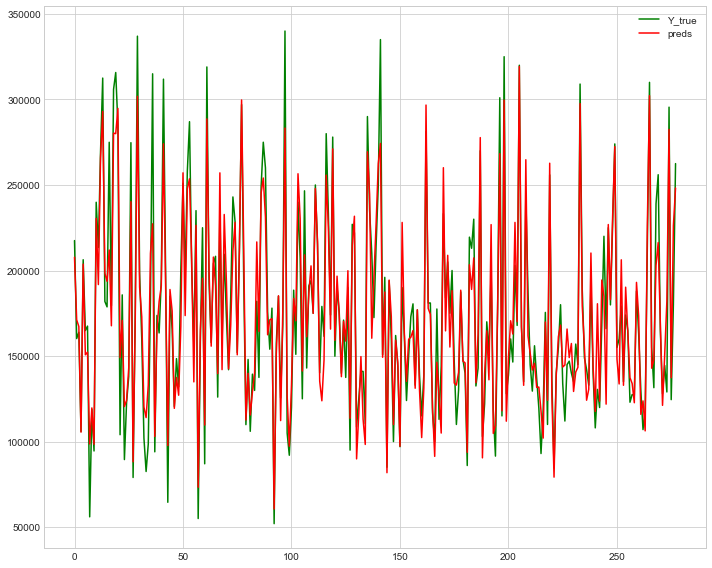

Fold = 4, RMSE = 19540.817467364137
mean_score =  20577.66965432837


In [149]:
# best score around 20000 pre clusters
keeps= [ 'indoor_Cluster', 'outdoor_Cluster','in_out_Cluster', 'All_Q_Cluster']
drops =  [  'Bmt_Ql_Cd_Cluster','Ext_Q_Cd_Cluster',
       'Bmt_F_A_Cluster', 'Gar_Q_Cd_Cluster', ]
RMSE_arr=[]
for i in np.arange(5):
    score= run(df=No_no_outlier3[sub1],target=target,model=et,fold=i,dropped=drops,save_fold_csv=False)  ; RMSE_arr.append(score)
print('mean_score = ', np.mean(RMSE_arr))

#### 3 clusters
sub1=20229
dropped_drops= 20577
dropped_keeps= 20544

#### 10 clusters
sub1=19631
dropped_drops=19753
dropped_keeps= 19541

#### 4 clusters
sub1=19656
dropped_drops=  19409 
dropped_keeps=  19240.29

# cluster distance

### drop the 'keeps' and maybe calculate distance for the keeps

In [ ]:
def make_clusters(df,target,features_list,cluster_name_list, n_clusters=10):
    X = df.copy()
    y = X.pop(target)
    
    #features = ['LotArea', 'TotalBsmtSF', 'FirstFlrSF', 'SecondFlrSF','GrLivArea']
    for features,cluster_name in zip(features_list,cluster_name_list):
        # Standardize
        X_scaled = X.loc[:, features]
        X_scaled = (X_scaled - X_scaled.mean(axis=0)) / X_scaled.std(axis=0)

        # Fit the KMeans model to X_scaled and create the cluster labels
        kmeans = KMeans( n_clusters=n_clusters, random_state=0)

        X_scaled = (X_scaled - X_scaled.mean(axis=0)) / X_scaled.std(axis=0)
        X[cluster_name + "_Cluster"] = kmeans.fit_predict(X_scaled)
        #X["Cluster"]=  X["Cluster"].astype('category')
    X[target]=y
    return X


In [186]:
def make_clusters_distance(df,target,features_list,cluster_name_list, n_clusters=10):
    X = df.copy()
    y = X.pop(target)
    
    #features = ['LotArea', 'TotalBsmtSF', 'FirstFlrSF', 'SecondFlrSF','GrLivArea']
    for features,cluster_name in zip(features_list,cluster_name_list):
        # Standardize
        X_scaled = X.loc[:, features]
        X_scaled = (X_scaled - X_scaled.mean(axis=0)) / X_scaled.std(axis=0)    
        kmeans = KMeans(n_clusters=n_clusters, n_init=10, random_state=0)

        # Create the cluster-distance features using `fit_transform`
        X_cd = kmeans.fit_transform(X_scaled)

        # Label features and join to dataset
        X_cd = pd.DataFrame(X_cd, columns=[f"Cen_{cluster_name}_{i}" for i in range(X_cd.shape[1])])
        X = X.join(X_cd,lsuffix = 'X',
        rsuffix='Km')
    X[target]=y
    print(X.head())
    return X

In [ ]:
cluster_features=[indoor,outdoor,in_out,Ext_Qual_Cond,Bmt_Qual_Cond,Bmt_Fnsh_Area,Garage_Qual_Cond,All_Qualities]
cluster_alias=['indoor','outdoor','in_out','Ext_Q_Cd','Bmt_Ql_Cd','Bmt_F_A','Gar_Q_Cd','All_Q']

In [189]:
# cluster=10
klust_dist=  make_clusters_distance(df=klusters,target=target,features_list=cluster_features,cluster_name_list=cluster_alias,
                                  n_clusters=10)

   Id  MSSubClass  MSZoning  LotFrontage  LotArea  Street  Alley  LotShape  \
0   1          60         0         65.0     8450       0     -1         0   
1   2          20         0         80.0     9600       0     -1         0   
2   3          60         0         68.0    11250       0     -1         1   
3   4          70         0         60.0     9550       0     -1         1   
4   5          60         0         84.0    14260       0     -1         1   

   LandContour  Utilities  ...  Cen_All_Q_1  Cen_All_Q_2  Cen_All_Q_3  \
0            0          0  ...     2.313301     0.482451     4.722937   
1            0          0  ...     3.421011     3.677774     4.919647   
2            0          0  ...     0.876786     1.896459     5.020663   
3            0          0  ...     2.067610     2.991094     4.326509   
4            0          0  ...     1.059891     2.113817     5.336562   

   Cen_All_Q_4  Cen_All_Q_5  Cen_All_Q_6  Cen_All_Q_7  Cen_All_Q_8  \
0     5.119000     3.2

In [190]:
#10 clusters
train_df = klust_dist.loc[klust_dist.SalePrice!='test_col'].reset_index(drop=True)
test_df = klust_dist.loc[klust_dist.SalePrice =='test_col'].reset_index(drop=True)
train_df.SalePrice = train_df.SalePrice.apply(int)

scoremxLE = make_mi_scores_Regression(X_train=train_df.drop(['Id','SalePrice','area_per_finishes'],axis=1), y_train=train_df.SalePrice)

no_outlier = Calculate_IQR(df=train_df,col='SalePrice',get_new_df=True)
No_no_outlier = get_no_outlier(df_in=no_outlier)

DESC
count      1460.000000
mean     180921.195890
std       79442.502883
min       34900.000000
25%      129975.000000
50%      163000.000000
75%      214000.000000
max      755000.000000
Name: SalePrice, dtype: float64
 
lower_limit =  3937.5    ||    upper_limit =  340037.5
Counts == ; lower_limit =  0    ||    upper_limit =  61
 
Number of possible Outliers =  61
Outliers : 
head  :  11    345000
53    385000
58    438780
Name: SalePrice, dtype: int64
tail  :  1373    466500
1388    377500
1437    394617
Name: SalePrice, dtype: int64


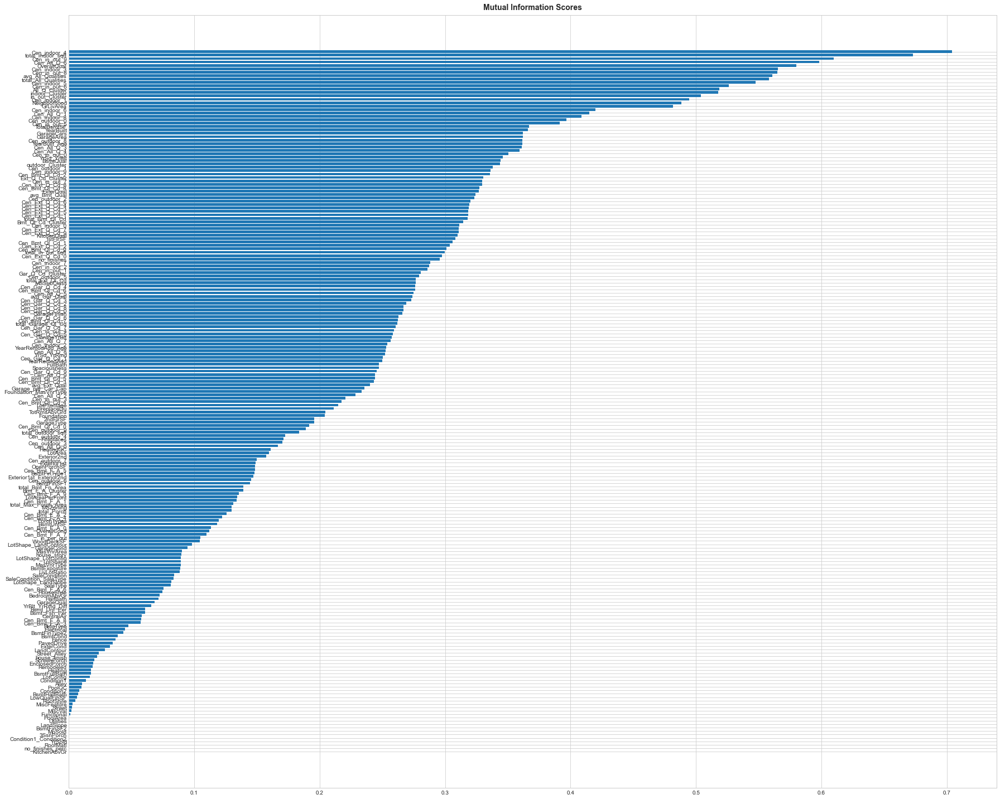

In [191]:
plot_mi_scores(scoremxLE)

In [195]:
top_k

['Cen_indoor_4',
 'total_indoor_sqft',
 'Cen_in_out_9',
 'Cen_All_Q_6',
 'OverallQual',
 'Cen_indoor_3',
 'Cen_in_out_8',
 'avg_All_Qualities',
 'total_All_Qualities',
 'Cen_indoor_5',
 'Cen_in_out_6',
 'All_Q_Cluster',
 'indoor_Cluster',
 'in_out_Cluster',
 'Cen_indoor_1',
 'Neighborhood',
 'GrLivArea',
 'Cen_indoor_6',
 'Cen_All_Q_1',
 'Cen_indoor_8',
 'Cen_outdoor_0',
 'Cen_in_out_5',
 'TotalBsmtSF',
 'YearBuilt',
 'GarageCars',
 'GarageArea',
 'Cen_outdoor_8',
 'YearBuilt_Age',
 'Cen_All_Q_3',
 'Cen_All_Q_4',
 'Cen_in_out_0',
 'YrSd_YrBlt',
 'BsmtQual',
 'outdoor_Cluster',
 'Cen_outdoor_1',
 'Cen_indoor_9',
 'Cen_Bmt_Ql_Cd_2',
 'Ext_Q_Cd_Cluster',
 'Cen_in_out_7',
 'Cen_Ext_Q_Cd_8',
 'Cen_Bmt_Ql_Cd_8',
 'ExterQual',
 'avg_Bmt_Qual',
 'Cen_outdoor_2',
 'Cen_Ext_Q_Cd_6',
 'Cen_Ext_Q_Cd_4',
 'Cen_Ext_Q_Cd_3',
 'Cen_Ext_Q_Cd_5',
 'Cen_Ext_Q_Cd_1',
 'total_Bmt_Ql_Cd',
 'SalePrice']

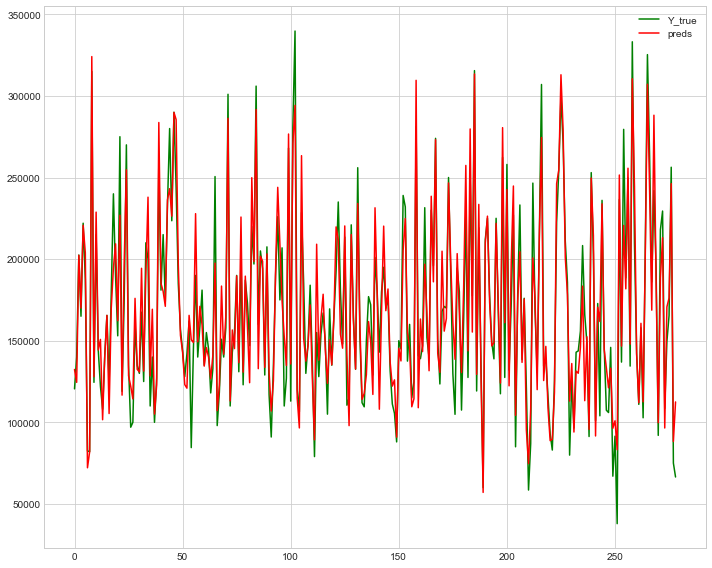

Fold = 0, RMSE = 19564.650873360162


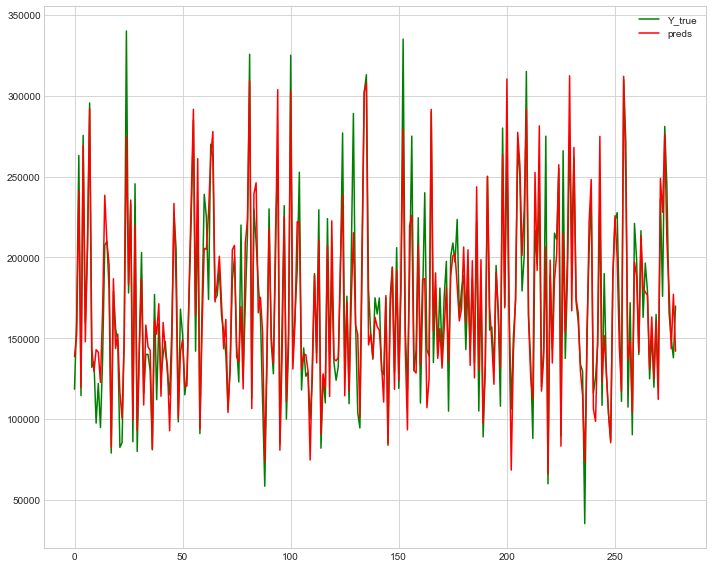

Fold = 1, RMSE = 20562.189523210556


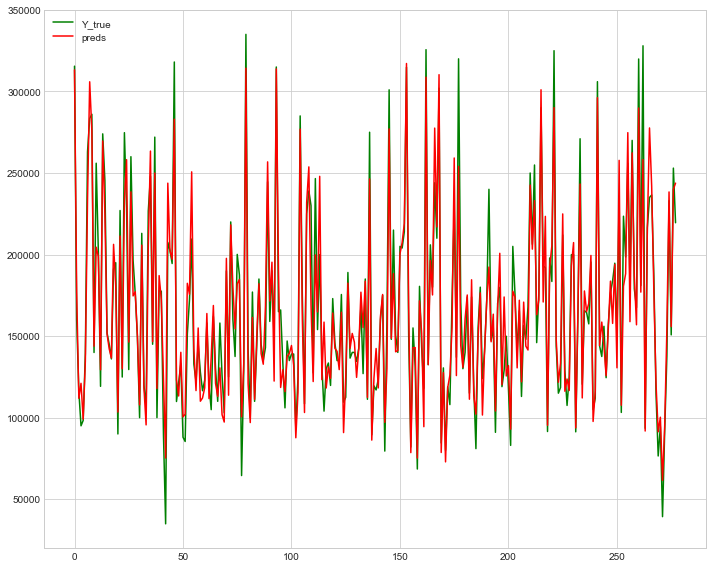

Fold = 2, RMSE = 18183.2984190853


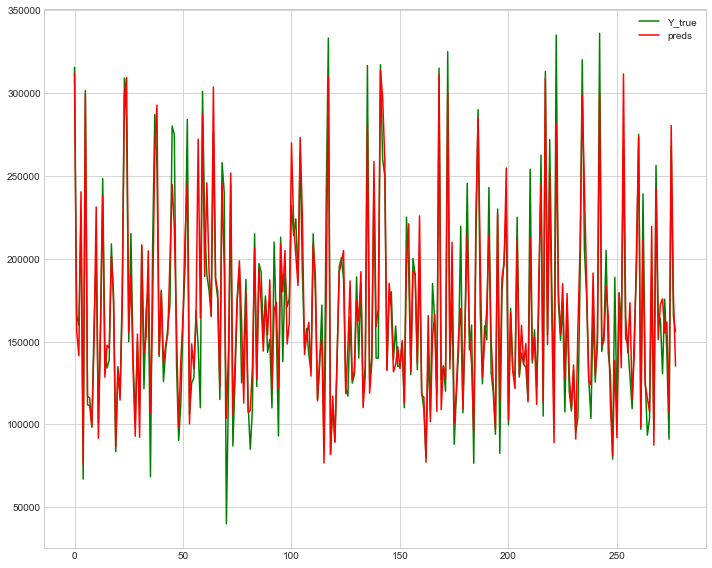

Fold = 3, RMSE = 21156.586719214753


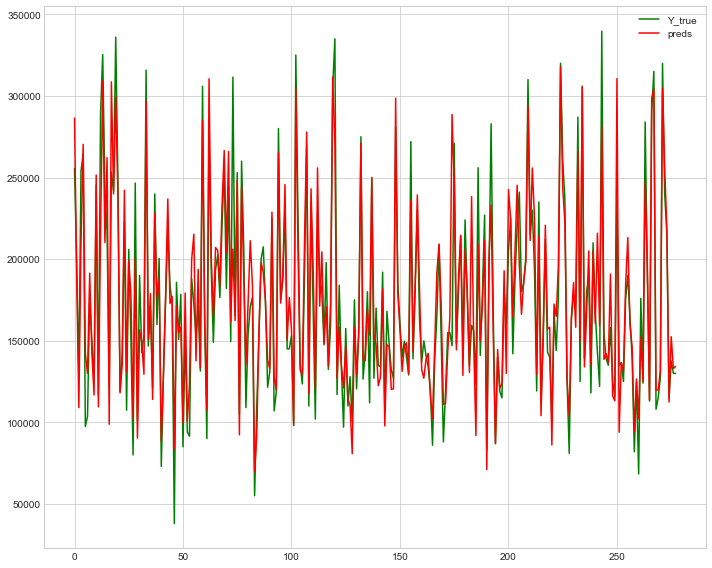

Fold = 4, RMSE = 23160.016209143385
mean_score =  20525.348348802832


In [196]:
# best score around 20000 pre clusters
top_k = scoremxLE.index.to_list()[:40]
top_k= top_k +['SalePrice']
RMSE_arr=[]
for i in np.arange(5):
    score= run(df=No_no_outlier
               [top_k],target=target,model=et,fold=i,dropped=[],save_fold_csv=False)  ; RMSE_arr.append(score)
print('mean_score = ', np.mean(RMSE_arr))

In [202]:
def mmm(X_train,y_train,model):
    from sklearn.feature_selection import SelectFromModel
    col_names = X_train.columns
    # select from the model
    sfm = SelectFromModel(estimator=model)
    X_transformed = sfm.fit_transform(X_train, y_train)
    # see which features were selected
    support = sfm.get_support()
    # get feature names
    print([
    x for x, y in zip(col_names, support) if y == True
    ])
mmm(X_train= No_no_outlier.drop(['Id','SalePrice','area_per_finishes'],axis=1), y_train=No_no_outlier.SalePrice,model=rf)

['OverallQual', 'total_indoor_sqft', 'total_All_Qualities', 'avg_All_Qualities', 'Cen_indoor_4', 'Cen_in_out_2', 'Cen_in_out_6', 'Cen_in_out_8', 'Cen_in_out_9', 'Cen_All_Q_6', 'Cen_All_Q_7']


In [203]:
rf_best=['OverallQual', 'total_indoor_sqft', 'total_All_Qualities', 'avg_All_Qualities', 'Cen_indoor_4', 'Cen_in_out_2', 'Cen_in_out_6', 'Cen_in_out_8', 'Cen_in_out_9', 'Cen_All_Q_6', 'Cen_All_Q_7','SalePrice']

In [200]:
et_best=['OverallQual', 'YearBuilt', 'ExterQual', 'CentralAir', 'GrLivArea', 'KitchenQual', 'total_indoor_sqft', 'YearBuilt_Age', 'YrSd_YrBlt', 'total_All_Qualities', 'avg_All_Qualities', 'in_out_Cluster', 'Cen_indoor_1', 'Cen_indoor_3', 'Cen_indoor_4', 'Cen_indoor_5', 'Cen_in_out_0', 'Cen_in_out_2', 'Cen_in_out_5', 'Cen_in_out_6', 'Cen_in_out_8', 'Cen_in_out_9', 'Cen_Ext_Q_Cd_3', 'Cen_All_Q_1', 'Cen_All_Q_6','SalePrice']

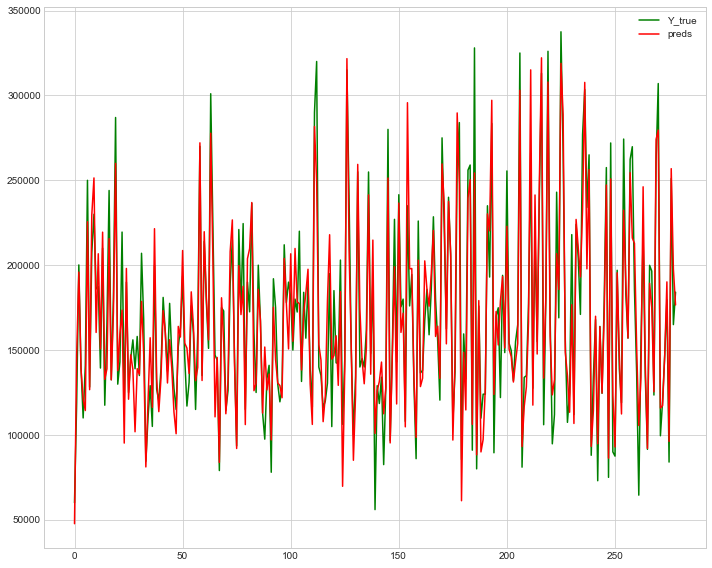

Fold = 0, RMSE = 20453.38193305811


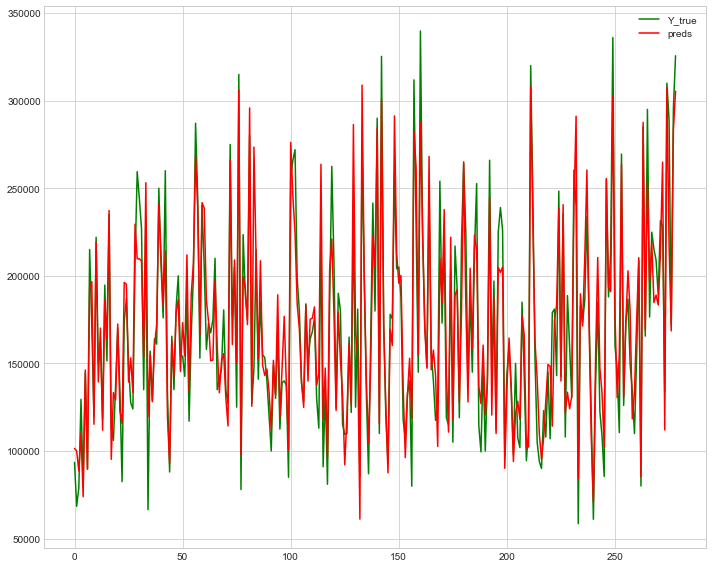

Fold = 1, RMSE = 22051.16520947433


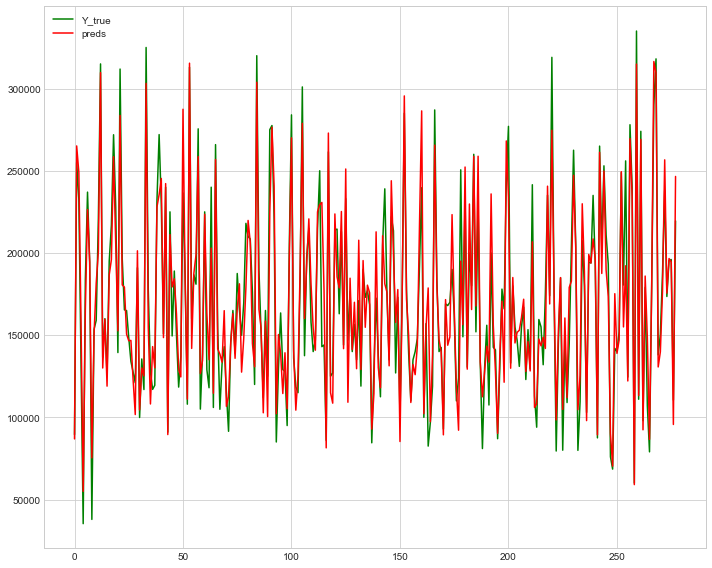

Fold = 2, RMSE = 20057.780568747756


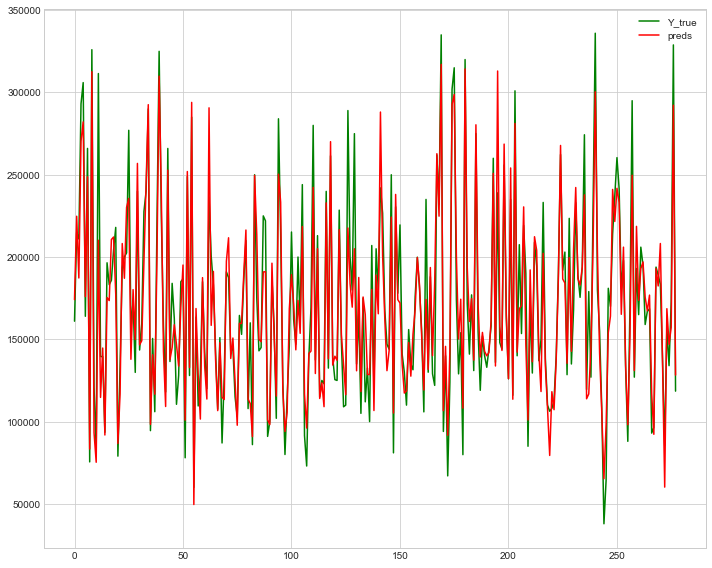

Fold = 3, RMSE = 21309.47283876602


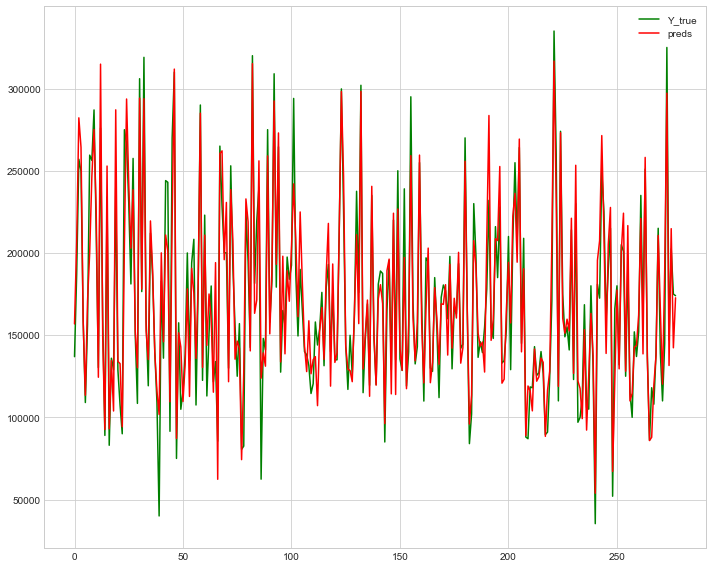

Fold = 4, RMSE = 19732.71077625026
mean_score =  20720.90226525929


In [204]:
# best score around 20000 pre clusters
top_k = scoremxLE.index.to_list()[:60]
top_k= top_k +['SalePrice']
RMSE_arr=[]
for i in np.arange(5):
    score= run(df=No_no_outlier
               [rf_best],target=target,model=et,fold=i,dropped=[],save_fold_csv=False)  ; RMSE_arr.append(score)
print('mean_score = ', np.mean(RMSE_arr))

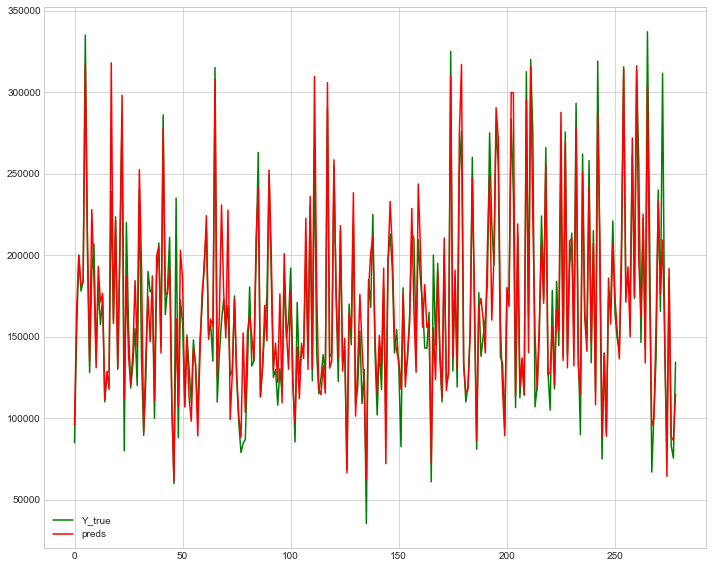

Fold = 0, RMSE = 20912.980366178577


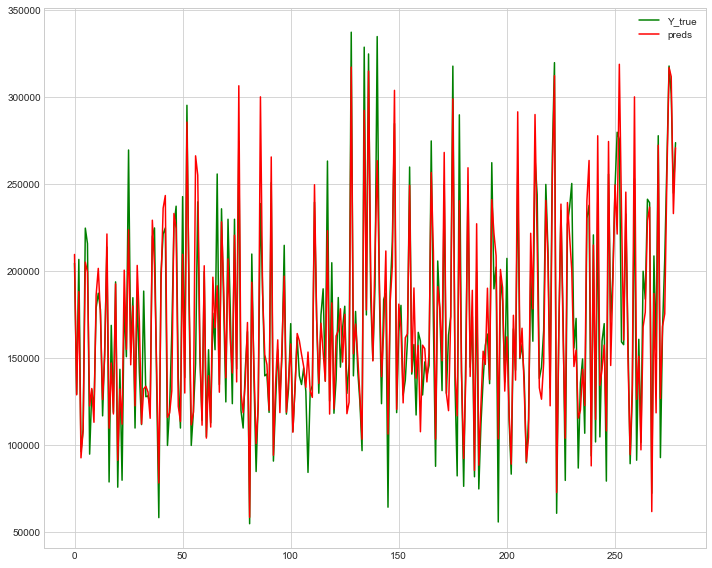

Fold = 1, RMSE = 21573.355156377038


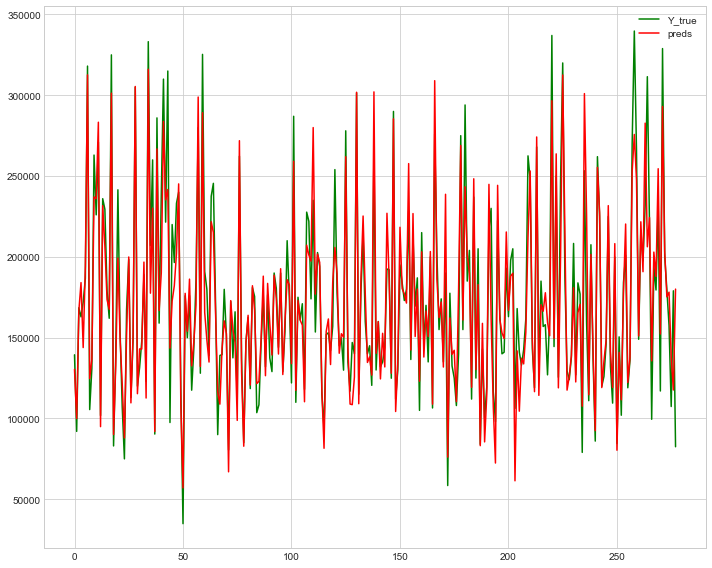

Fold = 2, RMSE = 21801.861405315805


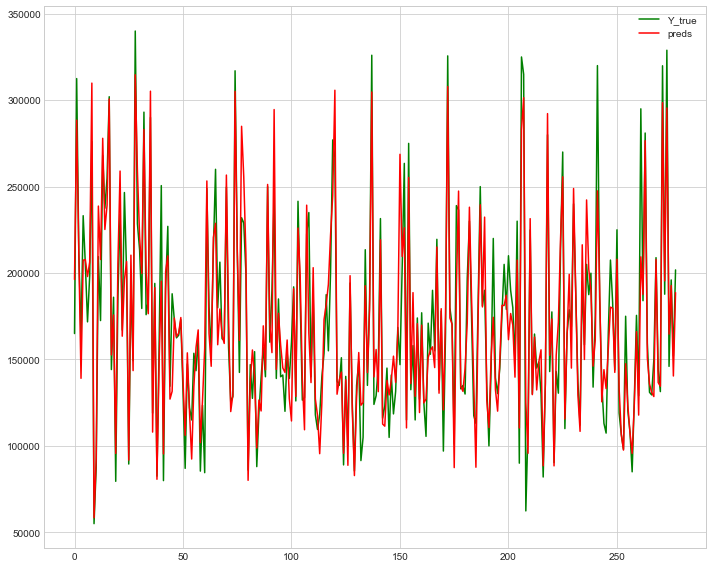

Fold = 3, RMSE = 21664.6601411758


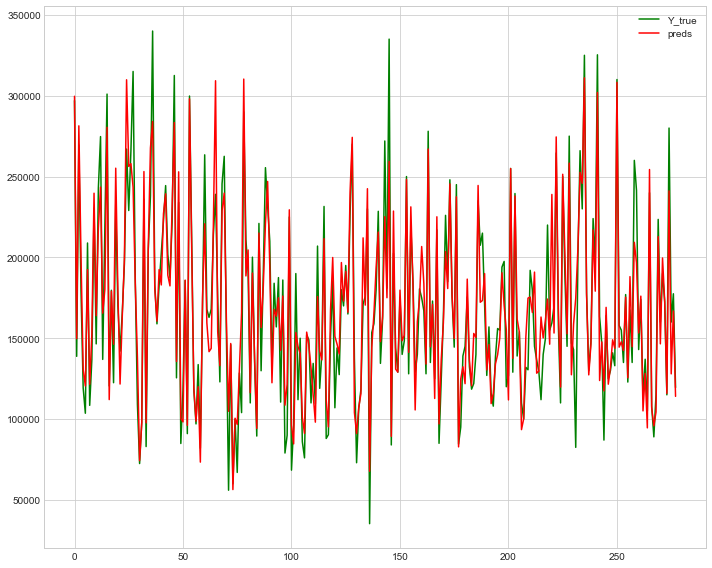

Fold = 4, RMSE = 21314.88812756561
mean_score =  21453.54903932257


In [201]:
# best score around 20000 pre clusters
top_k = scoremxLE.index.to_list()[:60]
top_k= top_k +['SalePrice']
RMSE_arr=[]
for i in np.arange(5):
    score= run(df=No_no_outlier
               [et_best],target=target,model=et,fold=i,dropped=[],save_fold_csv=False)  ; RMSE_arr.append(score)
print('mean_score = ', np.mean(RMSE_arr))

## clusters=4

In [206]:
train_df4.shape

(1460, 154)

In [207]:
# cluster=10
klust_dist4=  make_clusters_distance(df=klusters4,target=target,features_list=cluster_features,cluster_name_list=cluster_alias,
                                  n_clusters=4)

#10 clusters
train_df4 = klust_dist4.loc[klust_dist4.SalePrice!='test_col'].reset_index(drop=True)
test_df4 = klust_dist4.loc[klust_dist4.SalePrice =='test_col'].reset_index(drop=True)
train_df4.SalePrice = train_df4.SalePrice.apply(int)

scoremxLE4 = make_mi_scores_Regression(X_train=train_df4.drop(['Id','SalePrice','area_per_finishes'],axis=1), y_train=train_df4.SalePrice)

no_outlier4 = Calculate_IQR(df=train_df4,col='SalePrice',get_new_df=True)
No_no_outlier4 = get_no_outlier(df_in=no_outlier4)

   Id  MSSubClass  MSZoning  LotFrontage  LotArea  Street  Alley  LotShape  \
0   1          60         0         65.0     8450       0     -1         0   
1   2          20         0         80.0     9600       0     -1         0   
2   3          60         0         68.0    11250       0     -1         1   
3   4          70         0         60.0     9550       0     -1         1   
4   5          60         0         84.0    14260       0     -1         1   

   LandContour  Utilities  ...  Cen_Bmt_F_A_3  Cen_Gar_Q_Cd_0  Cen_Gar_Q_Cd_1  \
0            0          0  ...       0.279898        6.411487        1.042306   
1            0          0  ...       0.860430        6.411487        1.042306   
2            0          0  ...       0.253673        6.411487        1.042306   
3            0          0  ...       0.827364        6.001361        0.166315   
4            0          0  ...       0.183241        6.411487        1.042306   

   Cen_Gar_Q_Cd_2  Cen_Gar_Q_Cd_3  Cen_All_Q

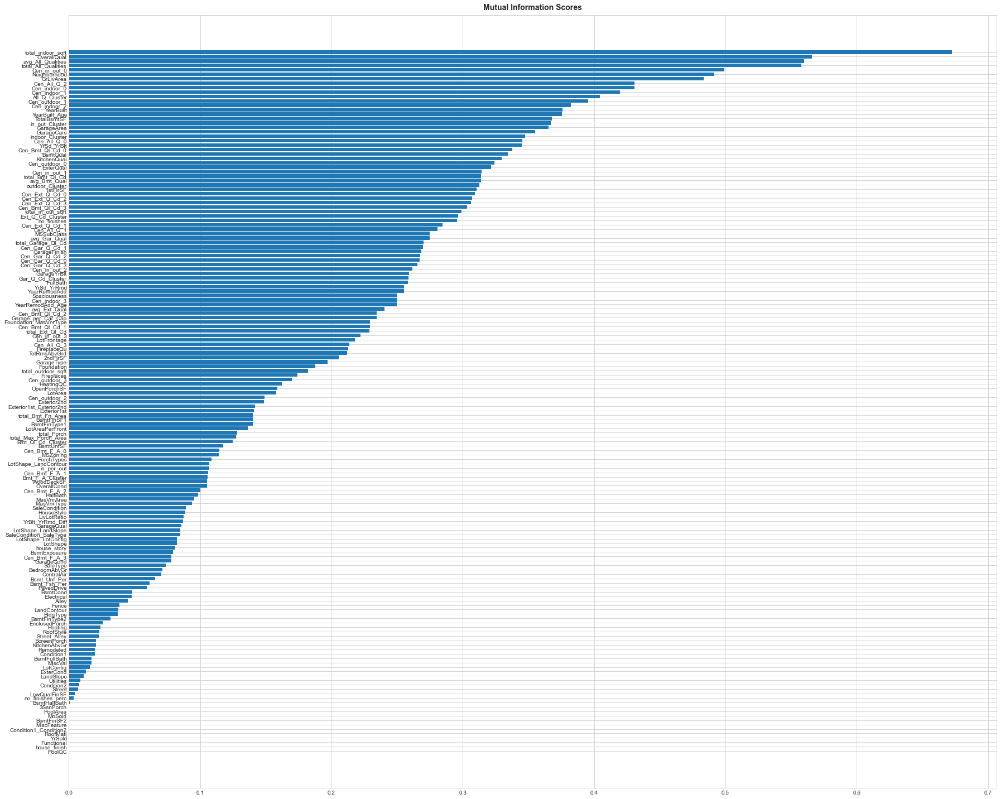

In [208]:
plot_mi_scores(scoremxLE4)

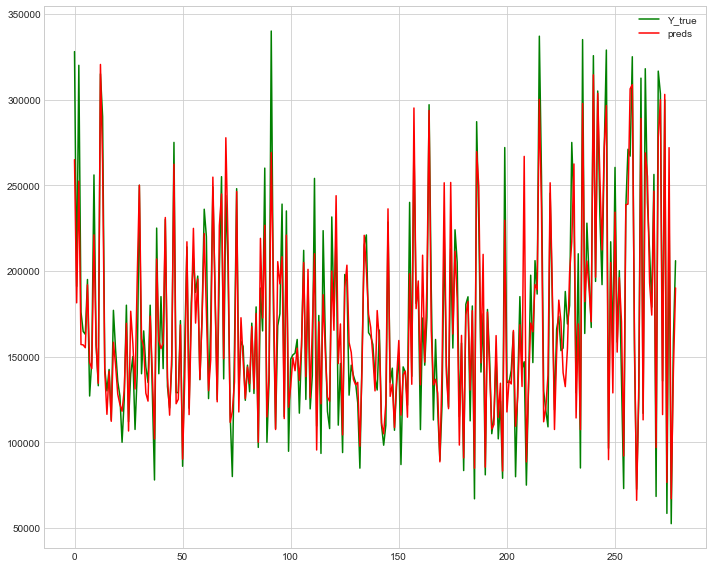

Fold = 0, RMSE = 20945.778787377476


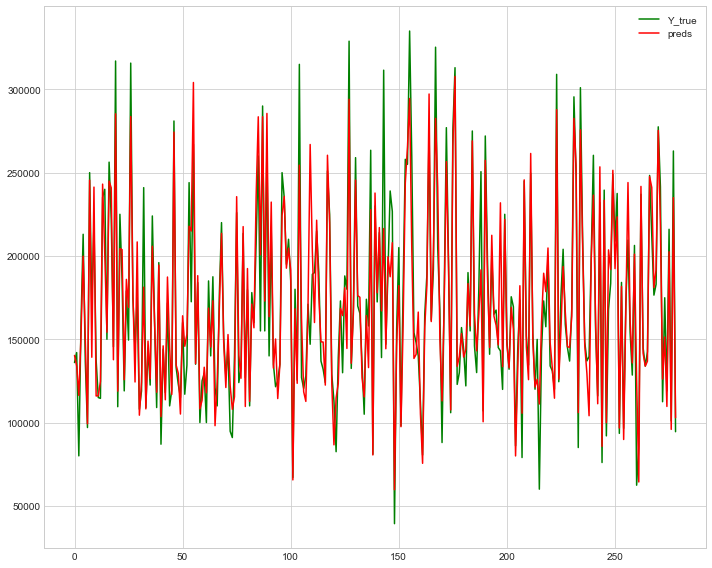

Fold = 1, RMSE = 21126.834610489885


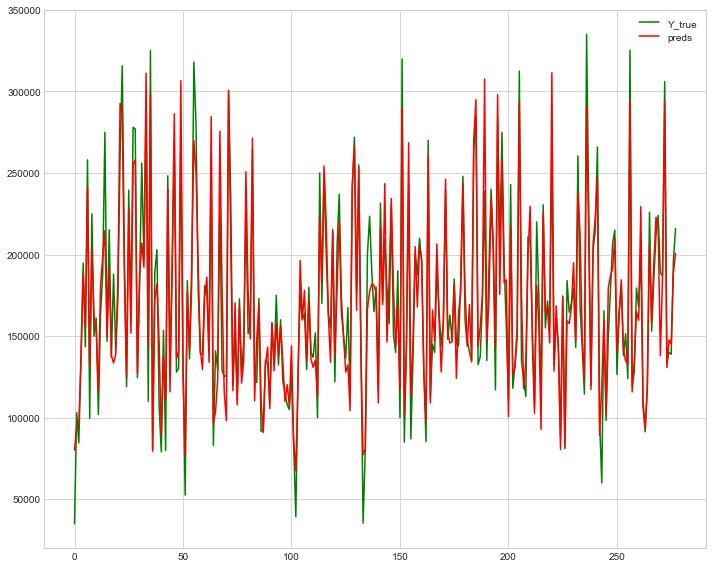

Fold = 2, RMSE = 19081.04854644198


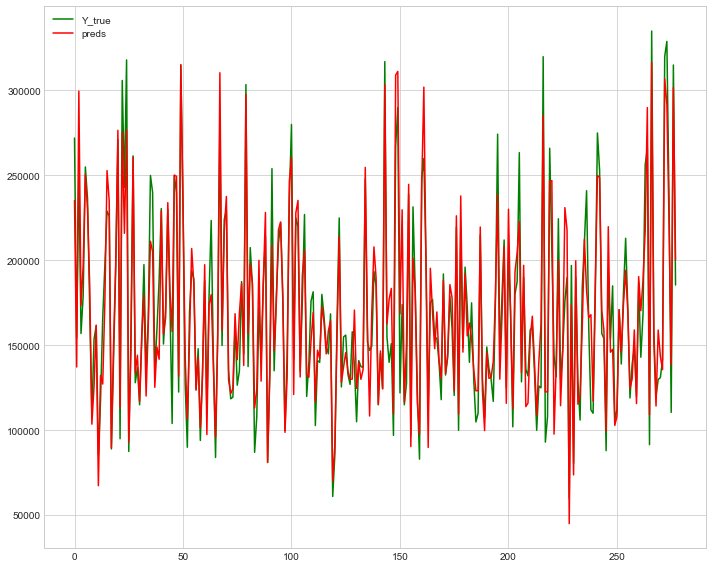

Fold = 3, RMSE = 18878.059653655546


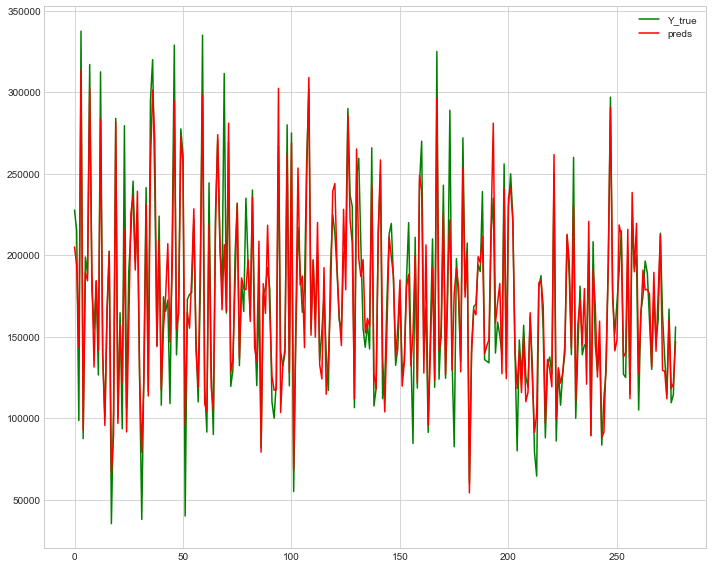

Fold = 4, RMSE = 20550.788704395796
mean_score =  20116.502060472132


In [210]:
# best score around 20000 pre clusters
top_k = scoremxLE4.index.to_list()[:40]
top_k= top_k +['SalePrice']
RMSE_arr=[]
for i in np.arange(5):
    score= run(df=No_no_outlier4
               [top_k],target=target,model=et,fold=i,dropped=[],save_fold_csv=False)  ; RMSE_arr.append(score)
print('mean_score = ', np.mean(RMSE_arr))

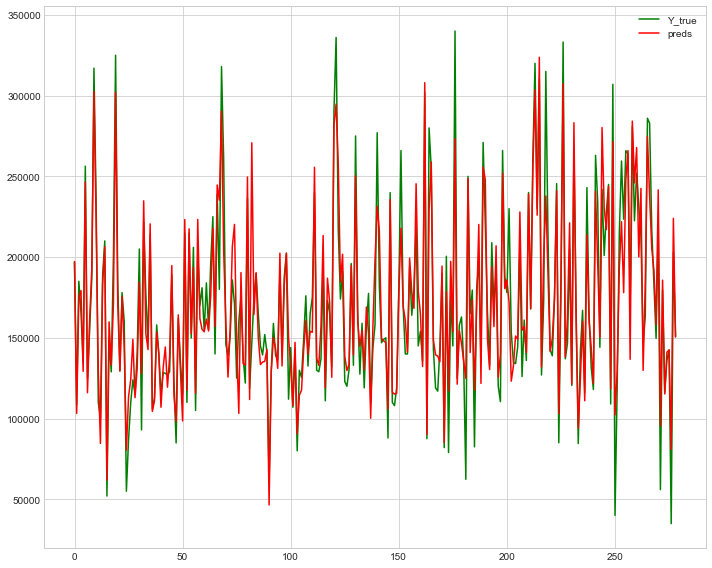

Fold = 0, RMSE = 21384.861622009677


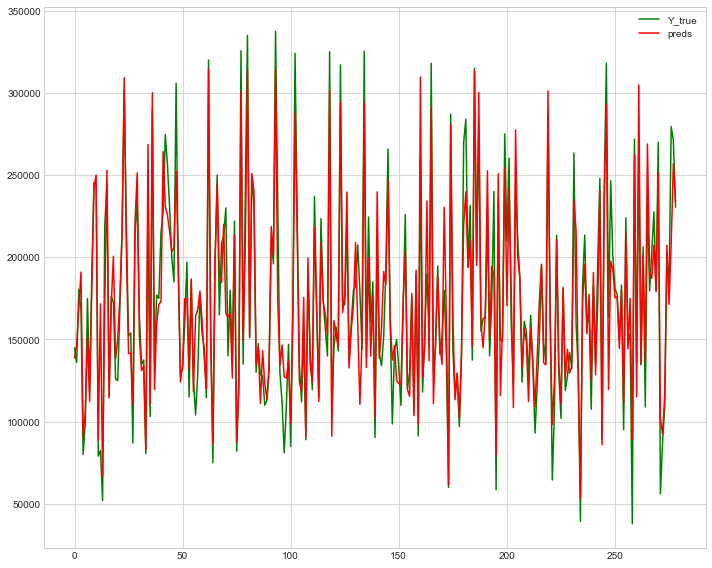

Fold = 1, RMSE = 21616.313775656938


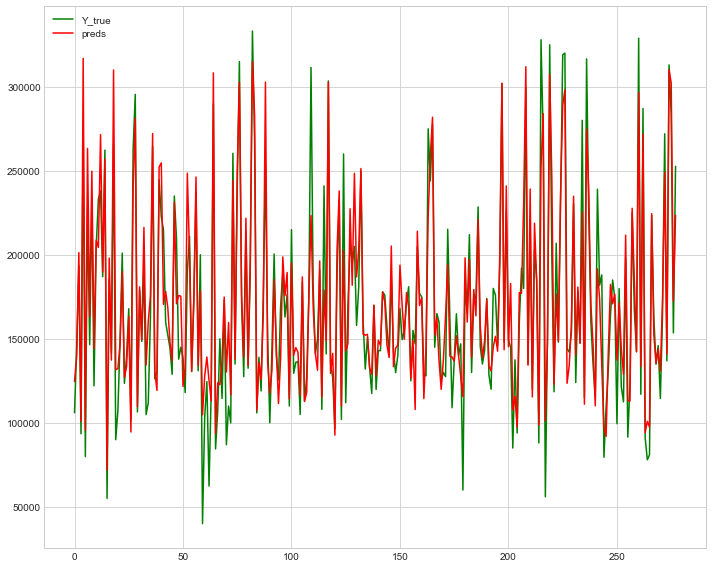

Fold = 2, RMSE = 21789.511127404916


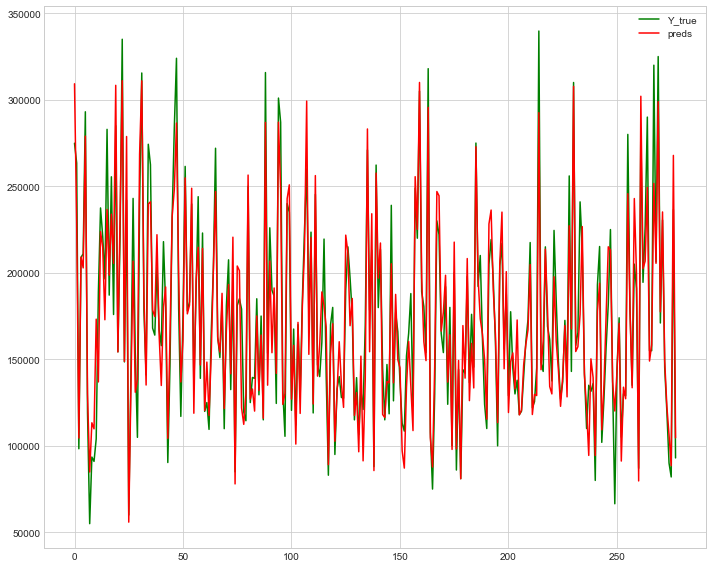

Fold = 3, RMSE = 19770.842259970785


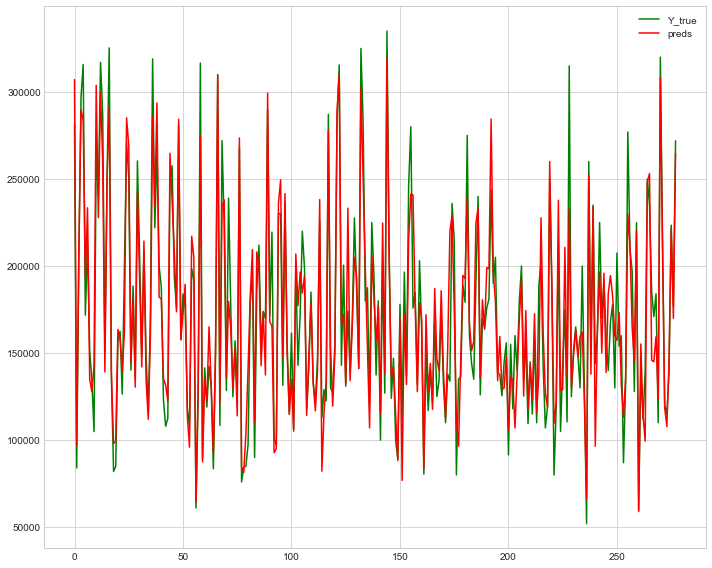

Fold = 4, RMSE = 21227.312144196767
mean_score =  21157.768185847817


In [212]:
# best score around 20000 pre clusters
top_k = scoremxLE4.index.to_list()[:20]
top_k= top_k +['SalePrice']
RMSE_arr=[]
for i in np.arange(5):
    score= run(df=No_no_outlier4
               [top_k],target=target,model=et,fold=i,dropped=[],save_fold_csv=False)  ; RMSE_arr.append(score)
print('mean_score = ', np.mean(RMSE_arr))

In [215]:
def mmm(X_train,y_train,model):
    from sklearn.feature_selection import SelectFromModel
    col_names = X_train.columns
    # select from the model
    sfm = SelectFromModel(estimator=model)
    X_transformed = sfm.fit_transform(X_train, y_train)
    # see which features were selected
    support = sfm.get_support()
    # get feature names
    print([
    x for x, y in zip(col_names, support) if y == True
    ])
mmm(X_train= No_no_outlier4.drop(['Id','SalePrice','area_per_finishes'],axis=1), y_train=No_no_outlier.SalePrice,model=et)

['OverallQual', 'ExterQual', 'CentralAir', 'GrLivArea', 'FullBath', 'KitchenQual', 'total_indoor_sqft', 'YearBuilt_Age', 'total_All_Qualities', 'avg_All_Qualities', 'in_out_Cluster', 'All_Q_Cluster', 'Cen_indoor_0', 'Cen_in_out_0', 'Cen_in_out_2', 'Cen_Ext_Q_Cd_3', 'Cen_All_Q_2']


In [214]:
rf_best=['OverallQual', 'total_indoor_sqft', 'total_All_Qualities', 'avg_All_Qualities', 'in_out_Cluster', 'Cen_in_out_0', 'Cen_in_out_2', 'Cen_All_Q_2','SalePrice']

In [216]:
et_best=['OverallQual', 'ExterQual', 'CentralAir', 'GrLivArea', 'FullBath', 'KitchenQual', 'total_indoor_sqft', 'YearBuilt_Age', 'total_All_Qualities', 'avg_All_Qualities', 'in_out_Cluster', 'All_Q_Cluster', 'Cen_indoor_0', 'Cen_in_out_0', 'Cen_in_out_2', 'Cen_Ext_Q_Cd_3', 'Cen_All_Q_2','SalePrice']

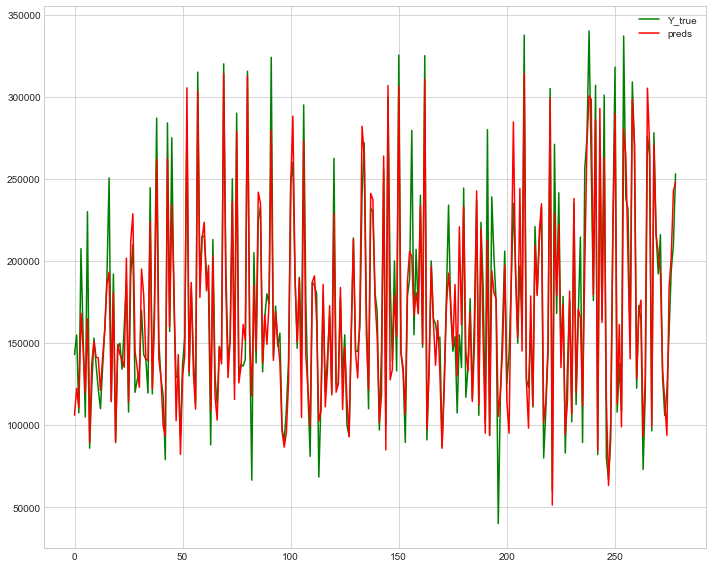

Fold = 0, RMSE = 20723.410541287823


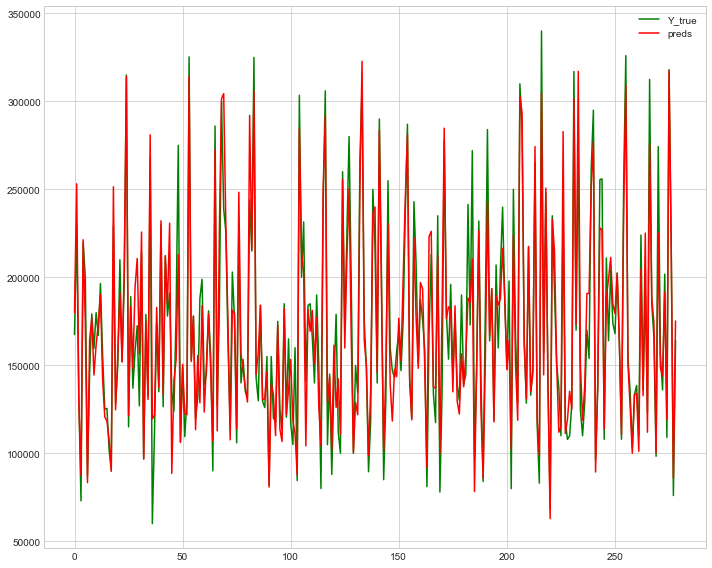

Fold = 1, RMSE = 19645.698646658777


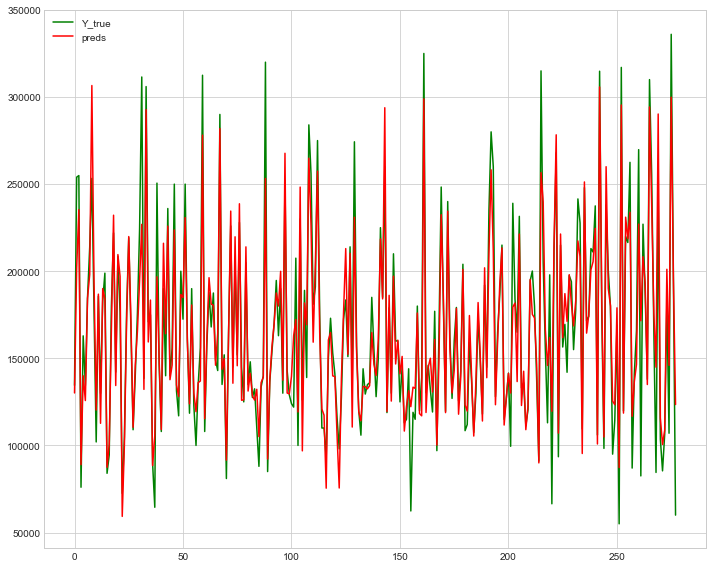

Fold = 2, RMSE = 20168.12922225496


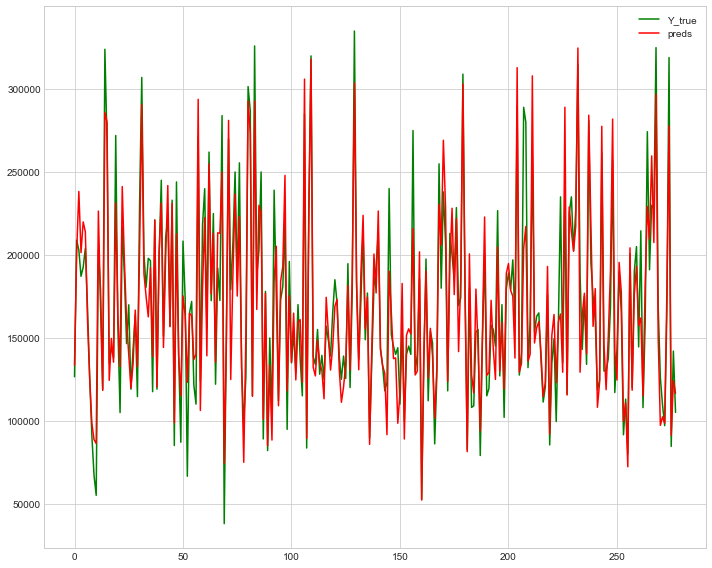

Fold = 3, RMSE = 20662.649913553305


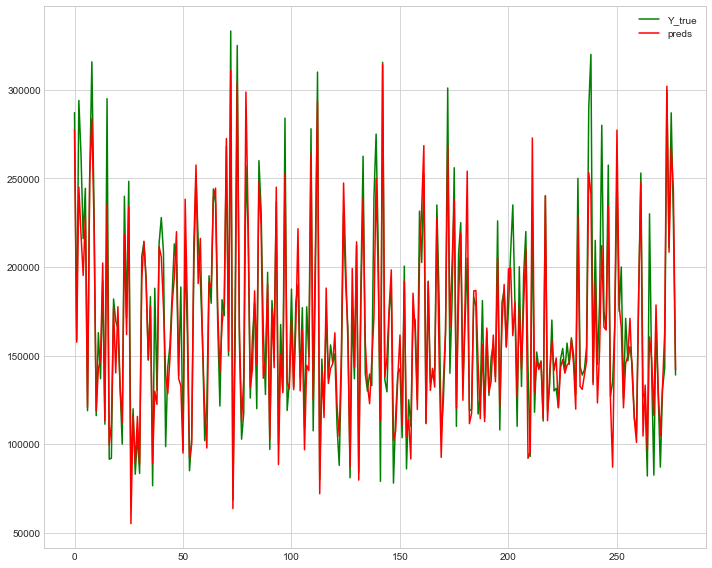

Fold = 4, RMSE = 19732.848643076173
mean_score =  20186.547393366207


In [217]:
# best score around 20000 pre clusters
top_k = scoremxLE.index.to_list()[:60]
top_k= top_k +['SalePrice']
RMSE_arr=[]
for i in np.arange(5):
    score= run(df=No_no_outlier
               [et_best],target=target,model=et,fold=i,dropped=[],save_fold_csv=False)  ; RMSE_arr.append(score)
print('mean_score = ', np.mean(RMSE_arr))

## keep

In [220]:
keeps_alias=['indoor', 'outdoor', 'in_out', 'All_Q']

In [223]:
keeps_features=[indoor,outdoor,in_out,All_Qualities]

In [224]:
# cluster=4
klust_dist0=  make_clusters_distance(df=klusters4,target=target,features_list=keeps_features,cluster_name_list=keeps_alias,
                                  n_clusters=4)

#10 clusters
train_df0 = klust_dist0.loc[klust_dist0.SalePrice!='test_col'].reset_index(drop=True)
test_df0 = klust_dist0.loc[klust_dist0.SalePrice =='test_col'].reset_index(drop=True)
train_df0.SalePrice = train_df0.SalePrice.apply(int)

scoremxLE_0 = make_mi_scores_Regression(X_train=train_df0.drop(['Id','SalePrice','area_per_finishes'],axis=1), y_train=train_df0.SalePrice)

no_outlier0 = Calculate_IQR(df=train_df0,col='SalePrice',get_new_df=True)
No_no_outlier0 = get_no_outlier(df_in=no_outlier0)

scoremxLE_0 = make_mi_scores_Regression(X_train=train_df0.drop(['Id','SalePrice','area_per_finishes'],axis=1), y_train=train_df0.SalePrice)


   Id  MSSubClass  MSZoning  LotFrontage  LotArea  Street  Alley  LotShape  \
0   1          60         0         65.0     8450       0     -1         0   
1   2          20         0         80.0     9600       0     -1         0   
2   3          60         0         68.0    11250       0     -1         1   
3   4          70         0         60.0     9550       0     -1         1   
4   5          60         0         84.0    14260       0     -1         1   

   LandContour  Utilities  ...  Cen_outdoor_3  Cen_in_out_0  Cen_in_out_1  \
0            0          0  ...      19.660670      2.220828      0.803192   
1            0          0  ...      19.518597      1.438561      2.743207   
2            0          0  ...      19.308030      2.472380      0.609004   
3            0          0  ...      19.526641      2.291720      0.939349   
4            0          0  ...      18.972927      3.916681      1.657654   

   Cen_in_out_2  Cen_in_out_3  Cen_All_Q_0  Cen_All_Q_1  Cen_All_Q_2

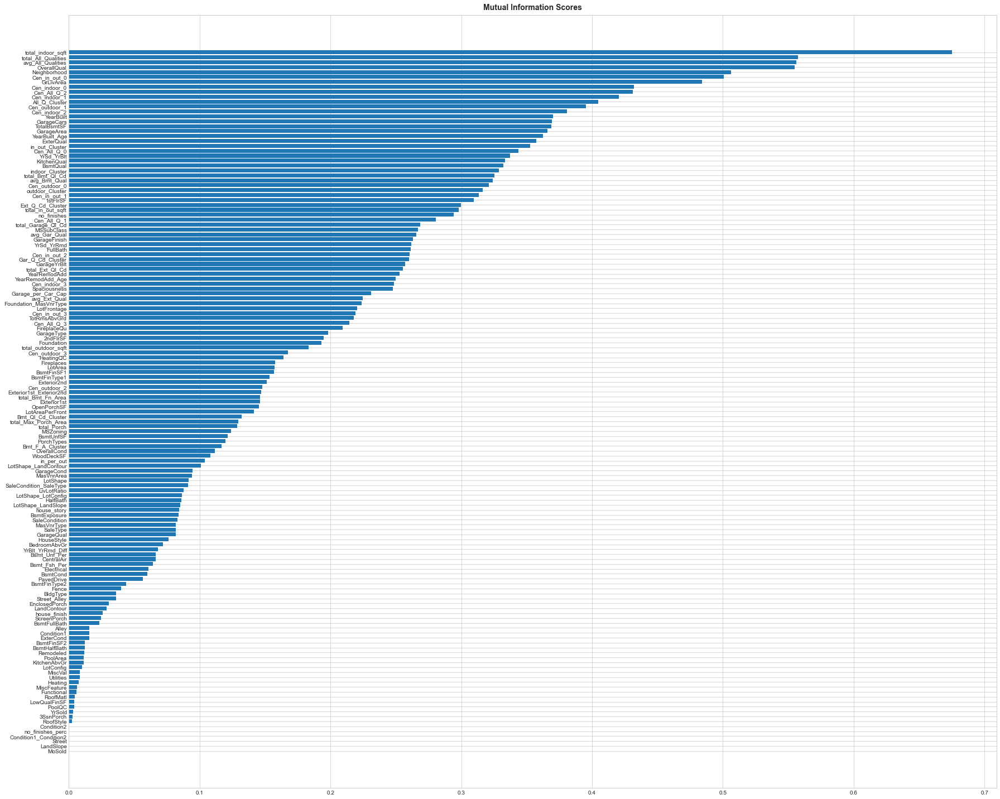

In [226]:
plot_mi_scores(scoremxLE_0)

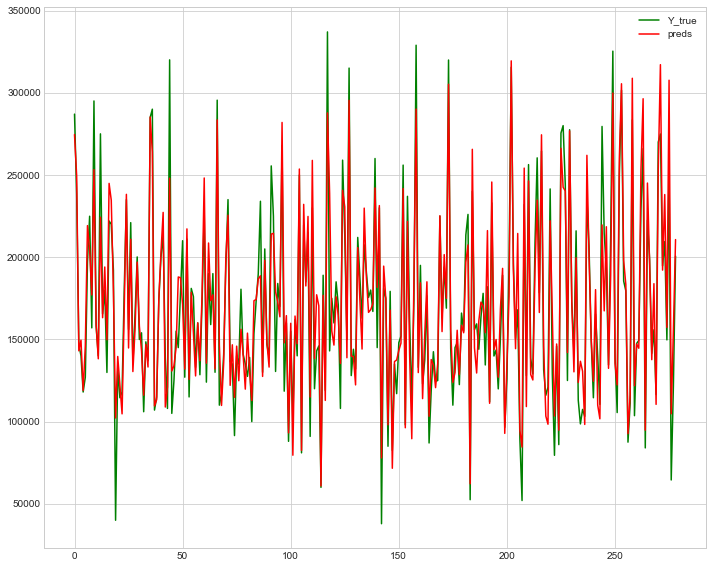

Fold = 0, RMSE = 19907.184349237443


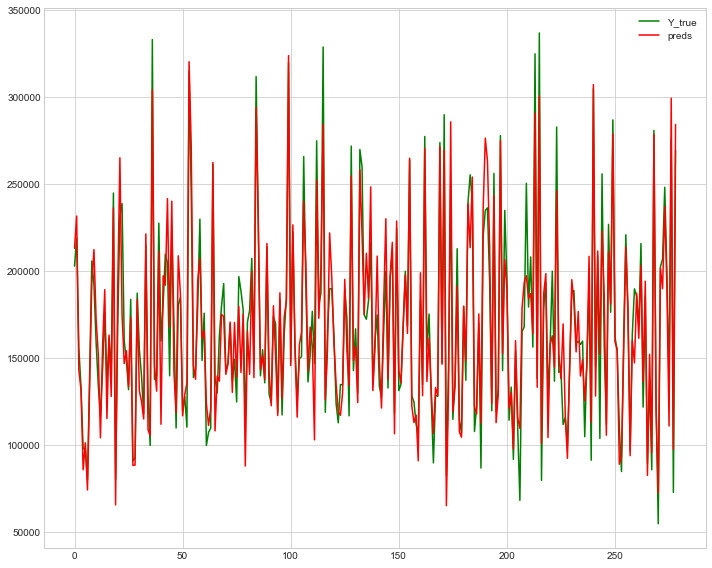

Fold = 1, RMSE = 17711.77804957881


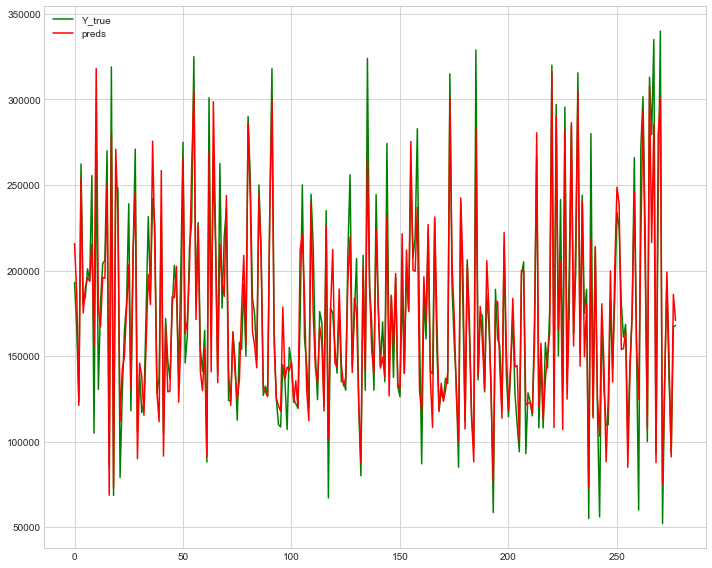

Fold = 2, RMSE = 19692.238804564015


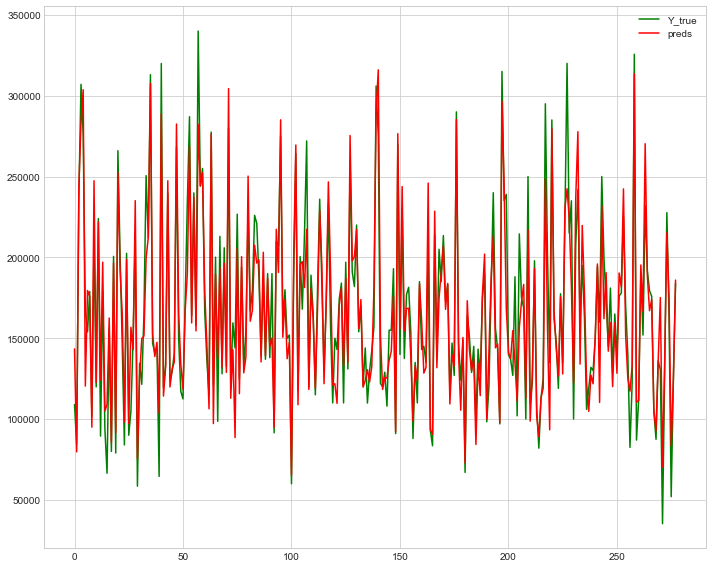

Fold = 3, RMSE = 20130.513398303203


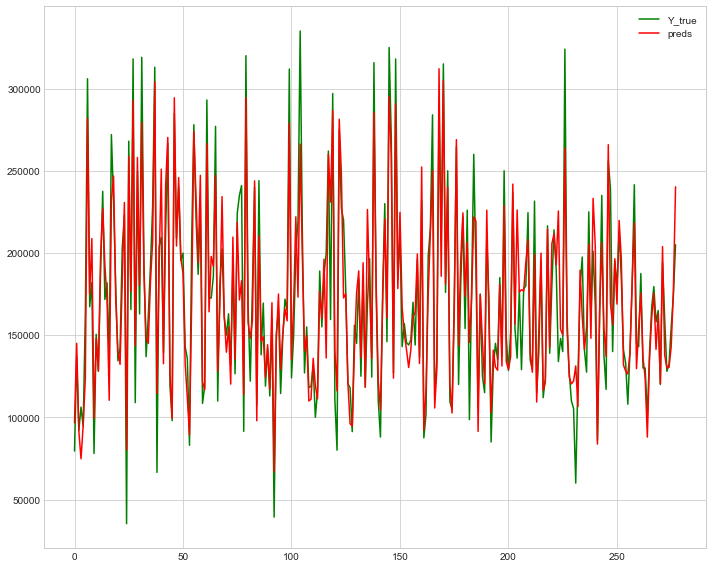

Fold = 4, RMSE = 22123.251692510163
mean_score =  19912.993258838724


In [233]:
# best score around 20000 pre clusters
top_k = scoremxLE_0.index.to_list()[:60]
top_k= top_k +['SalePrice']
RMSE_arr=[]
for i in np.arange(5):
    score= run(df=No_no_outlier0
               [top_k],target=target,model=et,fold=i,dropped=[],save_fold_csv=False)  ; RMSE_arr.append(score)
print('mean_score = ', np.mean(RMSE_arr))

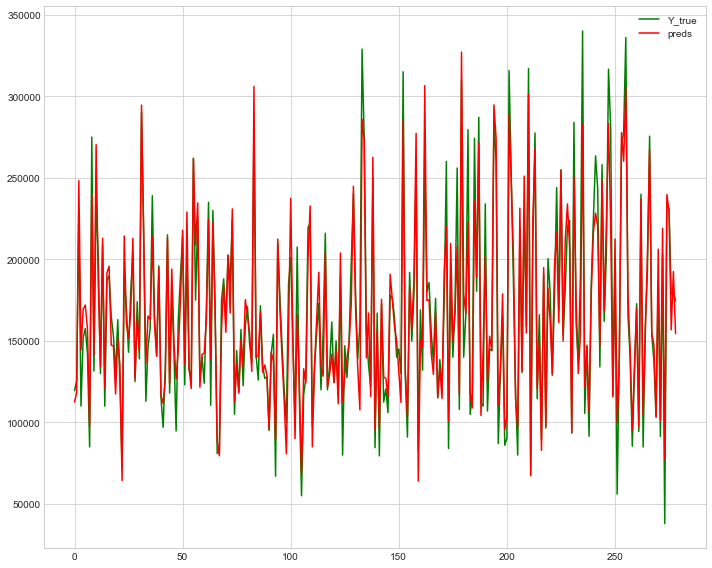

Fold = 0, RMSE = 17373.294603679286


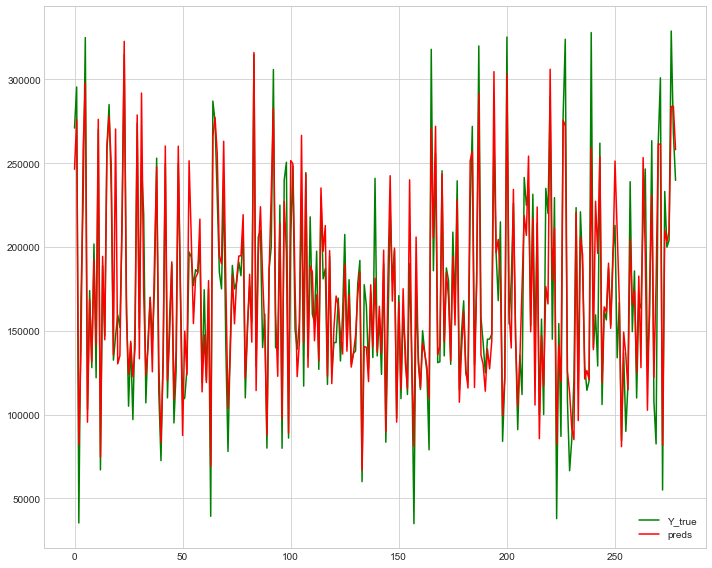

Fold = 1, RMSE = 24352.03530445259


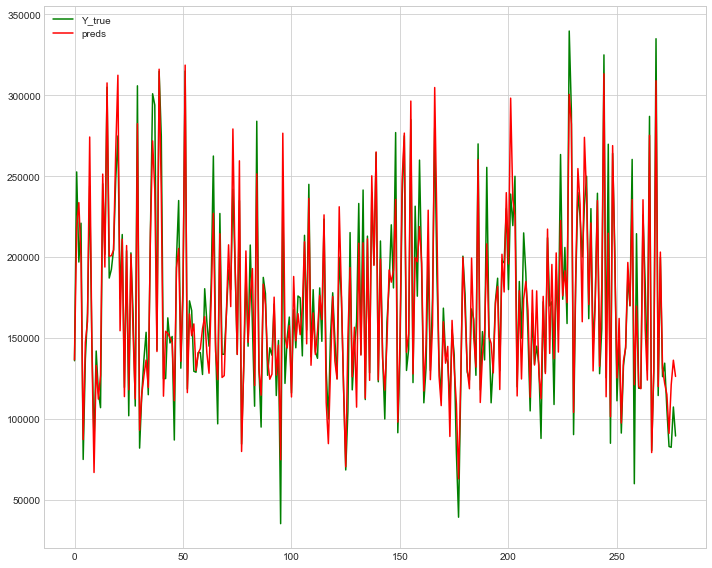

Fold = 2, RMSE = 19117.22812537385


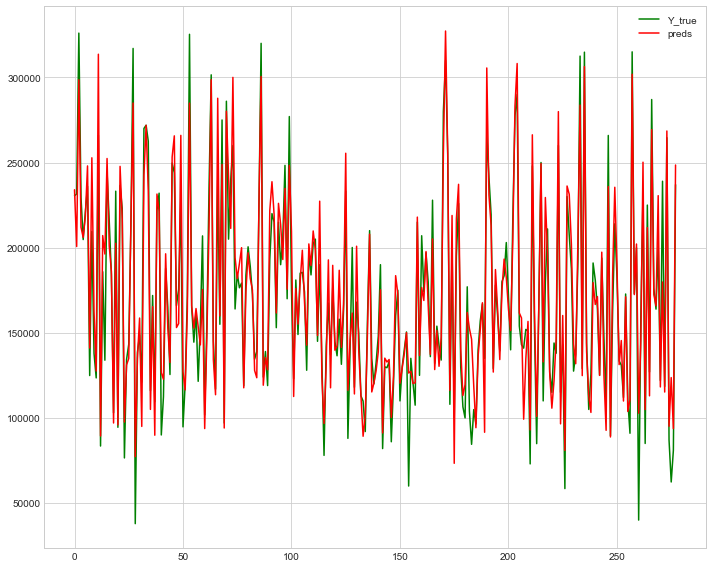

Fold = 3, RMSE = 19450.974299910362


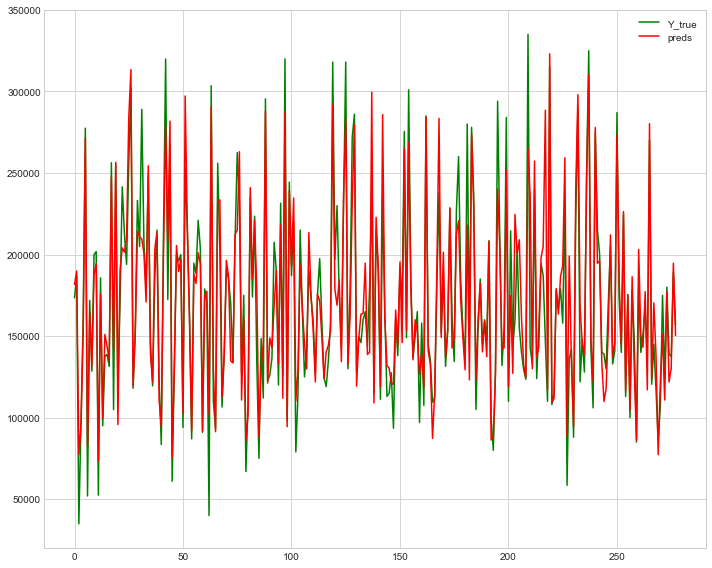

Fold = 4, RMSE = 22773.331567038487
mean_score =  20613.37278009092


In [235]:
# best score around 20000 pre clusters
top_k = scoremxLE_0.index.to_list()[:50]
top_k= top_k +['SalePrice']
RMSE_arr=[]
for i in np.arange(5):
    score= run(df=No_no_outlier0
               [top_k],target=target,model=et,fold=i,dropped=[],save_fold_csv=False)  ; RMSE_arr.append(score)
print('mean_score = ', np.mean(RMSE_arr))

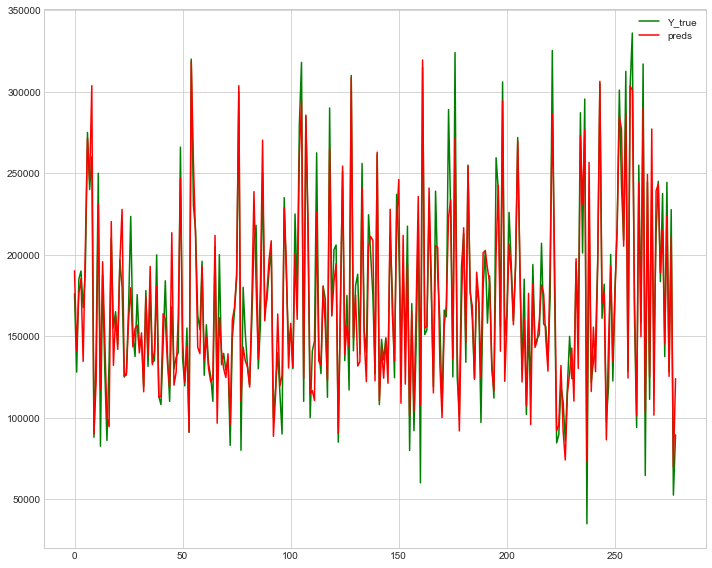

Fold = 0, RMSE = 18865.37368912426


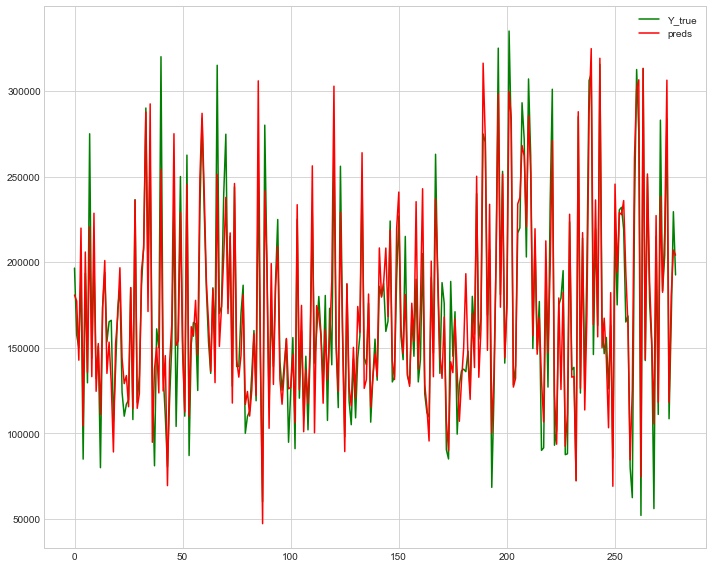

Fold = 1, RMSE = 20761.93627383339


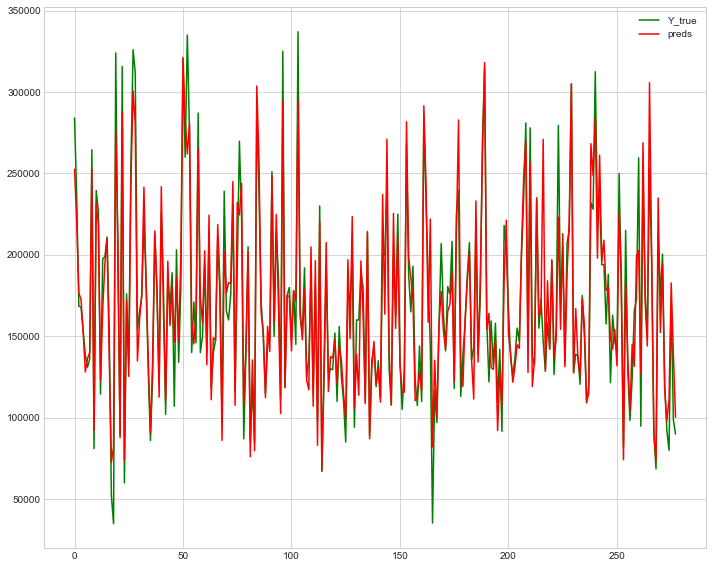

Fold = 2, RMSE = 20418.82728296864


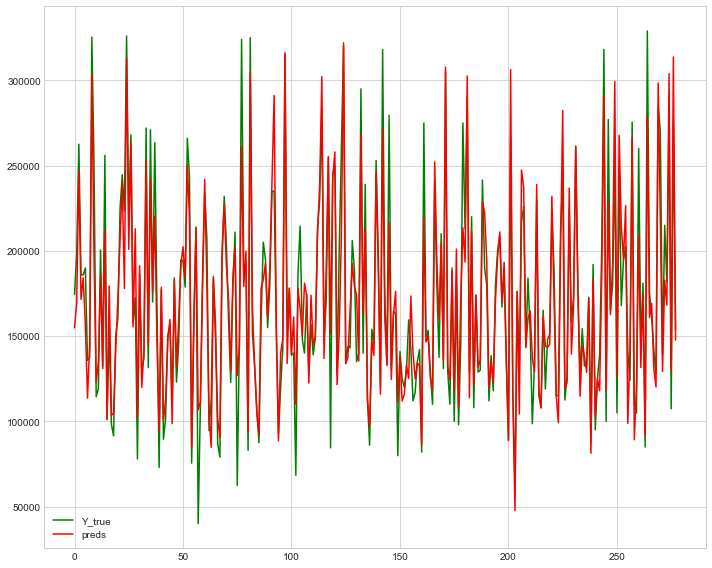

Fold = 3, RMSE = 21009.74168526685


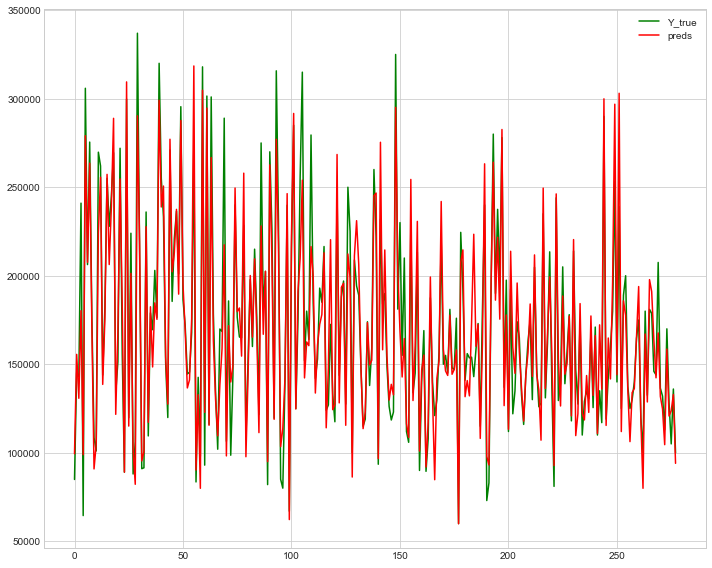

Fold = 4, RMSE = 19676.044376469647
mean_score =  20146.384661532553


In [231]:
# best score around 20000 pre clusters
top_k = scoremxLE_0.index.to_list()[:40]
top_k= top_k +['SalePrice']
RMSE_arr=[]
for i in np.arange(5):
    score= run(df=No_no_outlier0
               [top_k],target=target,model=et,fold=i,dropped=[],save_fold_csv=False)  ; RMSE_arr.append(score)
print('mean_score = ', np.mean(RMSE_arr))

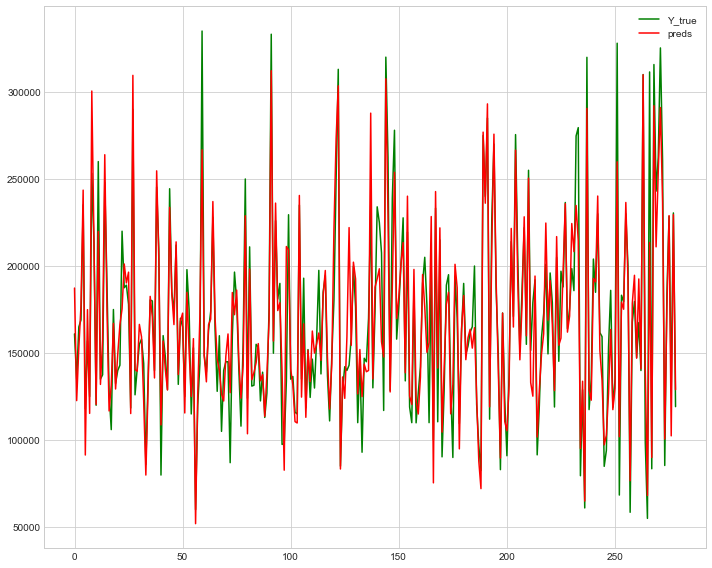

Fold = 0, RMSE = 20686.50917805652


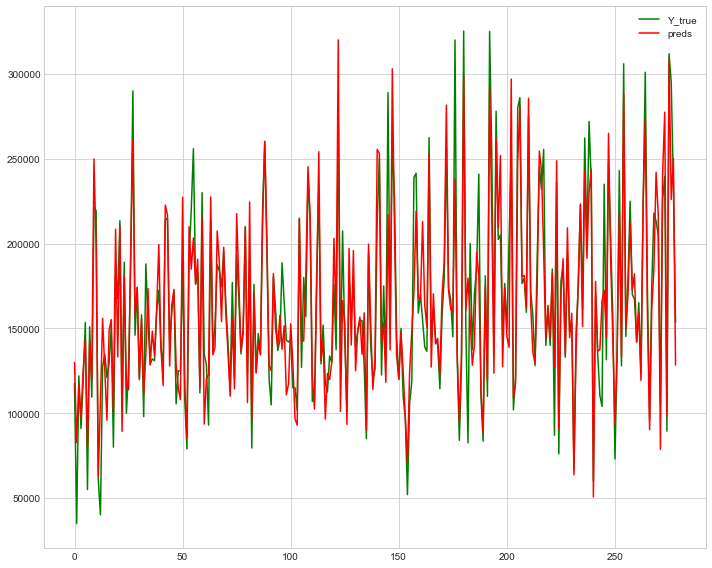

Fold = 1, RMSE = 22701.666712757757


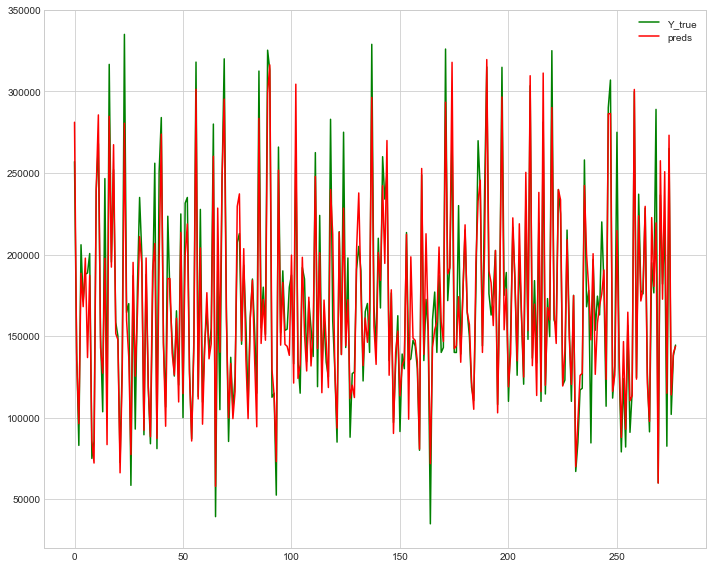

Fold = 2, RMSE = 19864.462987357943


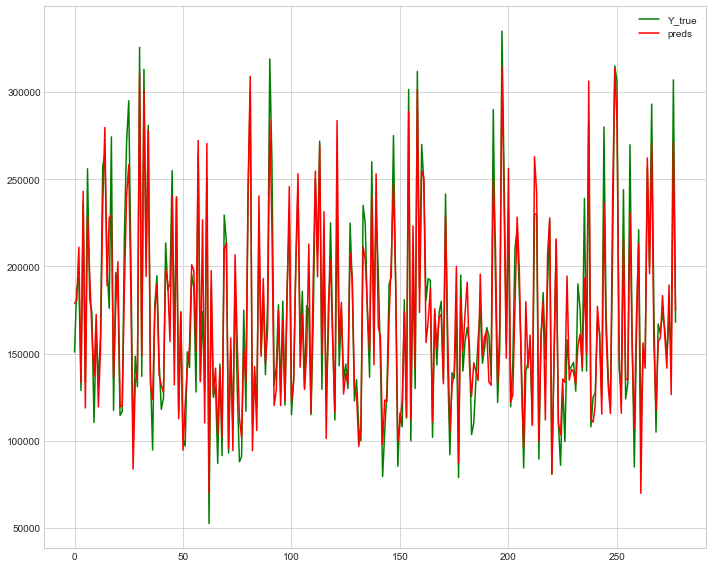

Fold = 3, RMSE = 17554.490078930226


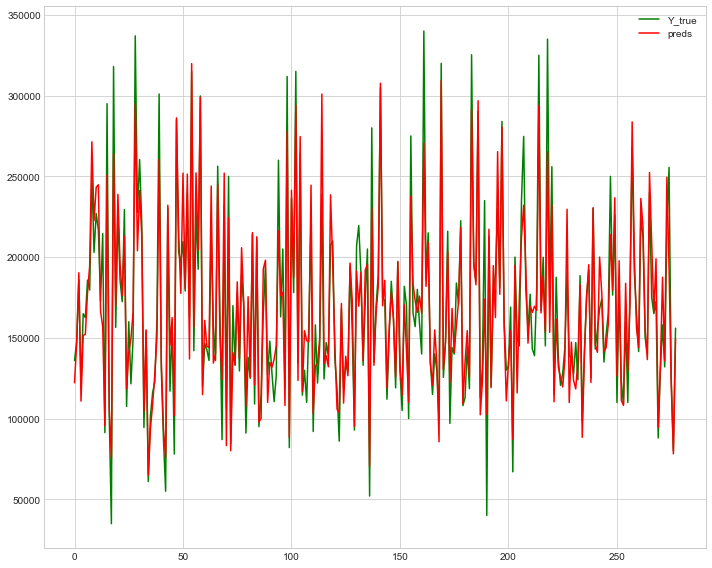

Fold = 4, RMSE = 20148.539832856895
mean_score =  20191.13375799187


In [232]:
# best score around 20000 pre clusters
top_k = scoremxLE_0.index.to_list()[:30]
top_k= top_k +['SalePrice']
RMSE_arr=[]
for i in np.arange(5):
    score= run(df=No_no_outlier0
               [top_k],target=target,model=et,fold=i,dropped=[],save_fold_csv=False)  ; RMSE_arr.append(score)
print('mean_score = ', np.mean(RMSE_arr))

## drops

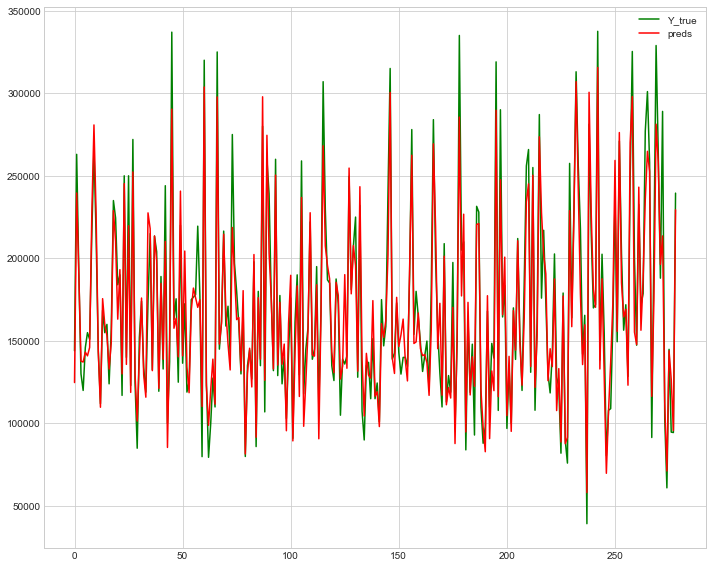

Fold = 0, RMSE = 17793.898300687837


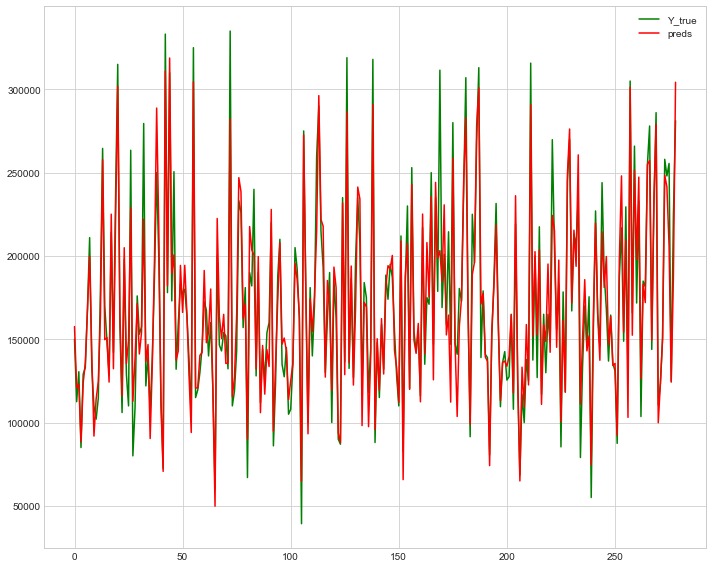

Fold = 1, RMSE = 17914.357825296283


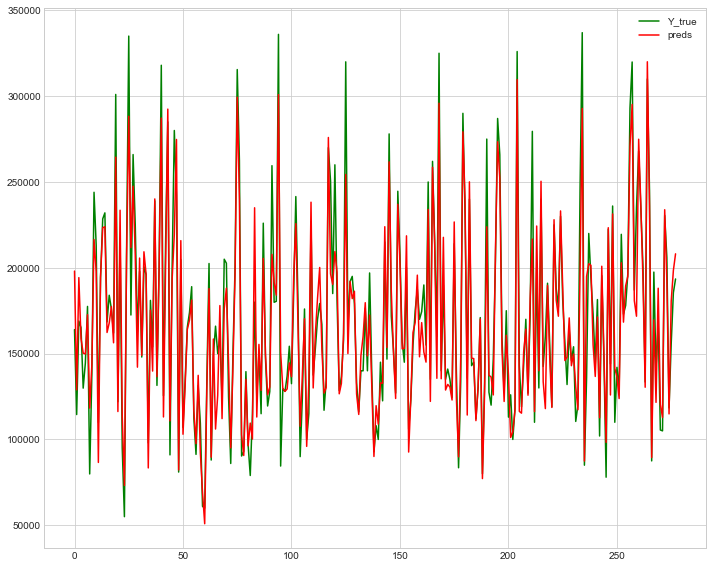

Fold = 2, RMSE = 18843.997223764858


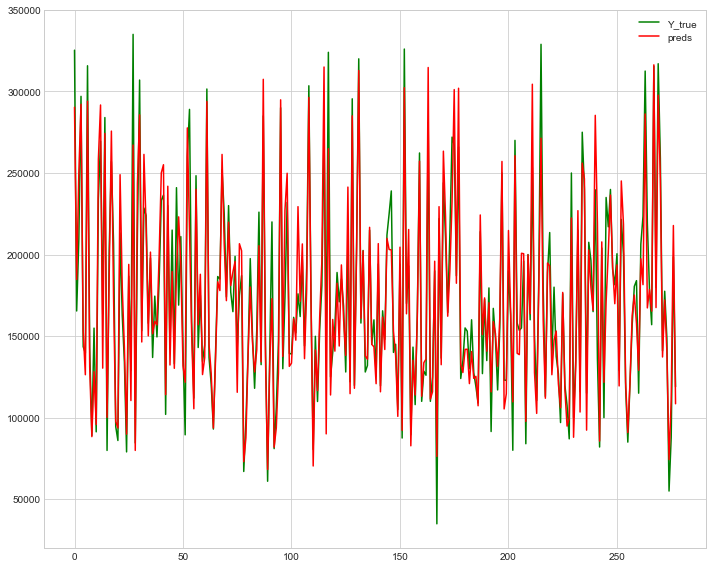

Fold = 3, RMSE = 20424.456559430284


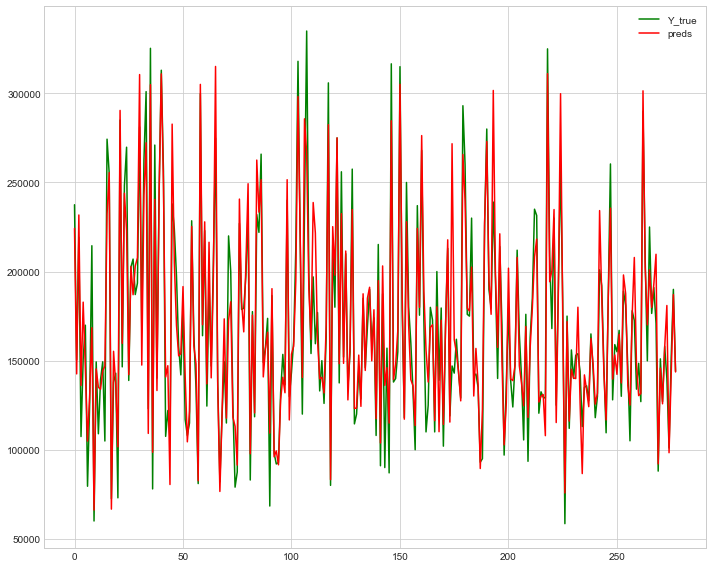

Fold = 4, RMSE = 19712.911974459887
mean_score =  18937.92437672783


In [236]:
# best score around 20000 pre clusters
top_k = scoremxLE_0.index.to_list()[:60]
top_k= top_k +['SalePrice']
RMSE_arr=[]
for i in np.arange(5):
    score= run(df=No_no_outlier0
               [top_k],target=target,model=et,fold=i,dropped=keeps,save_fold_csv=False)  ; RMSE_arr.append(score)
print('mean_score = ', np.mean(RMSE_arr))

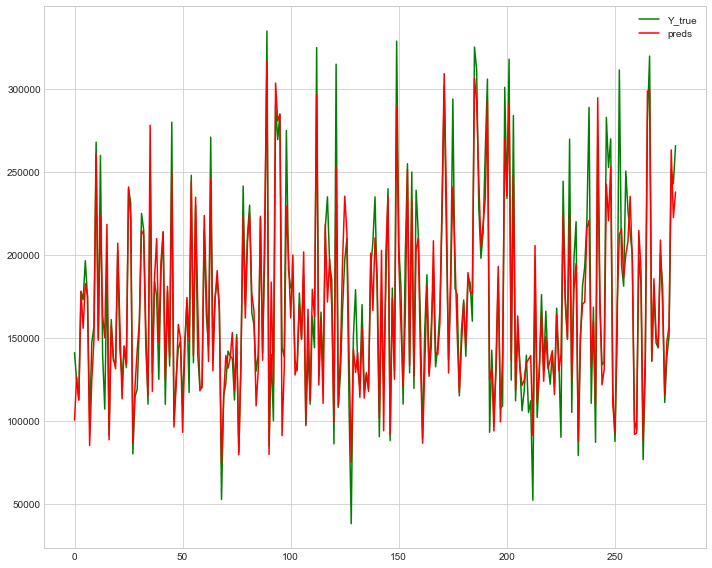

Fold = 0, RMSE = 19813.08935171851


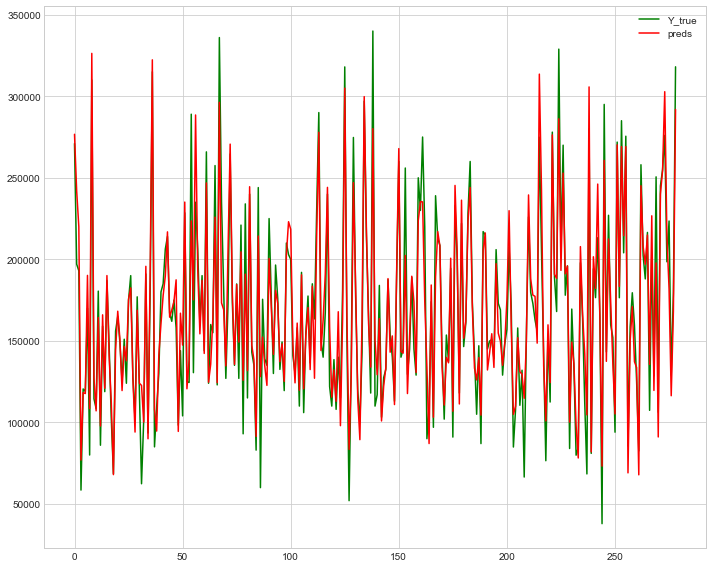

Fold = 1, RMSE = 19620.389057245076


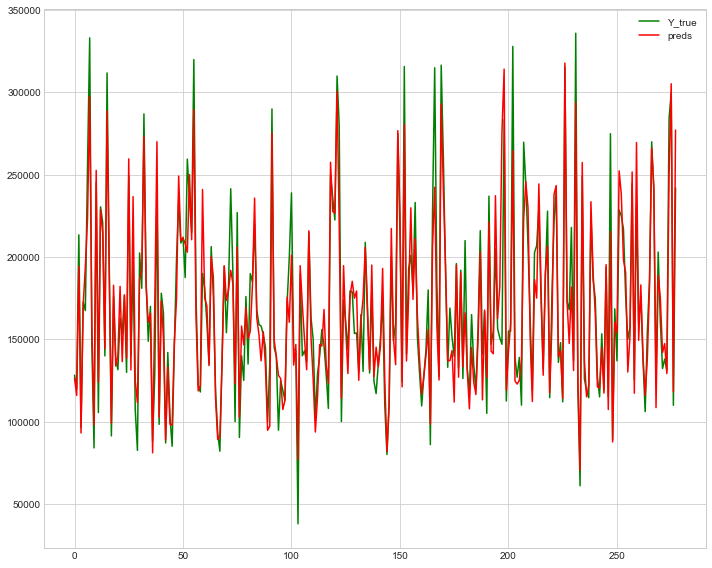

Fold = 2, RMSE = 20213.251646910576


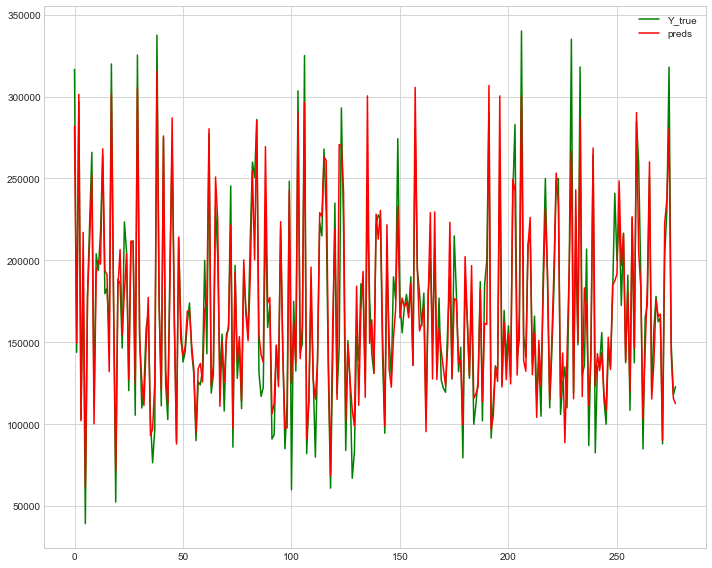

Fold = 3, RMSE = 19806.805196526642


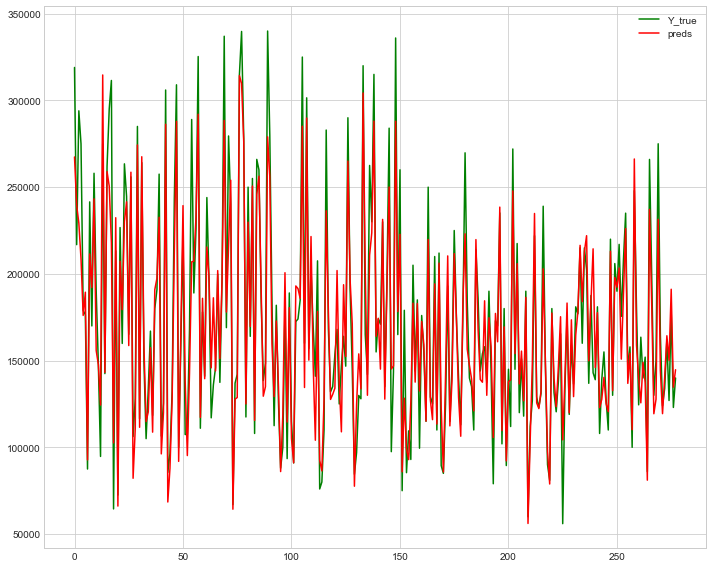

Fold = 4, RMSE = 22038.41076801932
mean_score =  20298.389204084022


In [239]:
# best score around 20000 pre clusters
top_k = scoremxLE_0.index.to_list()[:50]
top_k= top_k +['SalePrice']
RMSE_arr=[]
for i in np.arange(5):
    score= run(df=No_no_outlier0
               [top_k],target=target,model=et,fold=i,dropped=keeps,save_fold_csv=False)  ; RMSE_arr.append(score)
print('mean_score = ', np.mean(RMSE_arr))

## drop dropps

In [240]:
# best score around 20000 pre clusters
top_k = scoremxLE_0.index.to_list()[:50]
top_k= top_k +['SalePrice']
RMSE_arr=[]
for i in np.arange(5):
    score= run(df=No_no_outlier0
               [top_k],target=target,model=et,fold=i,dropped=drops,save_fold_csv=False)  ; RMSE_arr.append(score)
print('mean_score = ', np.mean(RMSE_arr))

KeyError: "['Bmt_Ql_Cd_Cluster' 'Bmt_F_A_Cluster'] not found in axis"

In [ ]:
def model_feature_importance(model,X_train_df,n_features):
    """
        returns top k features
        
        params:-
                 model = trained model used for feature selection
                X_train_df = Pandas dataframe to extract columns
                n_features = Number of top features to be selected
    """
    feature_importance_df = pd.DataFrame(model.feature_importances_,columns=['importance'])
    feature_importance_df['feature'] = X_train_df.columns
    new_feat= feature_importance_df.sort_values(by=['importance'],ascending= False).head(n_features)['feature'].to_list()
    plt.figure(figsize=(20,14))
    sns.barplot(x='importance',y='feature',data=feature_importance_df.sort_values(by=['importance'],ascending= False).head(n_features))
    plt.title('Model__Feature__Importance')
    plt.show()
    return new_feat